# 1. Import Libraries and Load Data

## 1.1 Libraries

In [84]:
import torch 
import torch.nn as nn 
import torchvision
import torchvision.transforms as transforms
from torchvision.datasets import MNIST 
from torch.utils.data import DataLoader 
from torchvision.utils import make_grid
import urllib.request
import numpy as np
import matplotlib.pyplot as plt
torch.manual_seed(0)
%matplotlib inline

## 1.2 Load Data

In [85]:
transform = transforms.Compose([
    transforms.ToTensor(),
    # transforms.Normalize((0.5,), (0.5,)),
])
batch_size = 128 
data = MNIST('./data', download=True, transform=transform)
dataloader = DataLoader(data, batch_size=batch_size, shuffle=True)

In [86]:
def show_image(imgs, num_images=25, size=(1, 28, 28)):
  # imgs = (imgs +1) / 2
  img_unflat = imgs.detach().view(-1, *size)
  img_grid = make_grid(img_unflat[:num_images], nrow=5)
  img_reshized = img_grid.permute(1, 2, 0).squeeze()
  plt.imshow(img_reshized)
  plt.show()

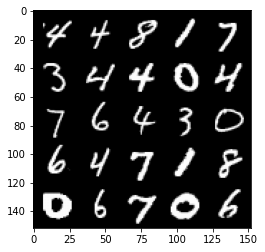

In [87]:
dataiter = iter(dataloader)
images, labels = dataiter.next()
show_image(images)

# 2 Build GAN

## 2.1 Generator

In [88]:
class Generator(nn.Module):
  def __init__(self, noise_dim, img_dim, hidden_dim=128):
    super(Generator, self).__init__()
    self.gen = nn.Sequential(
        self.gen_block(noise_dim, 128), 
        self.gen_block(128, 128*2), 
        self.gen_block(128*2, 128*4), 
        self.gen_block(128*4, 128*8), 
        nn.Linear(128*8, img_dim), 
        nn.Sigmoid()
    )

  def gen_block(self, input_dim, output_dim):
    gen_b = nn.Sequential(
        nn.Linear(input_dim, output_dim), 
        nn.BatchNorm1d(output_dim),
        nn.ReLU(inplace=True)
    )
    return gen_b
  
  def forward(self, noise):
    return self.gen(noise)
  
  def get_gen(self):
    return self.gen

## 2.2 Discriminator

In [89]:
class Discriminator(nn.Module):
  def __init__(self, img_dim):
    super(Discriminator, self).__init__()
    self.disc = nn.Sequential(
        self.disc_block(img_dim,128*4), 
        self.disc_block(128*4,128*2), 
        self.disc_block(128*2,128), 
        nn.Linear(128,1)
    )
  def disc_block(self, input_dim, output_dim): 
    disc_b = nn.Sequential(
        nn.Linear(input_dim, output_dim), 
        nn.LeakyReLU(negative_slope=0.2, inplace=True)
    )
    return disc_b
  def forward(self, image): 
    return self.disc(image)
  def get_disc(self):
    return self.disc

# 3 Parameter Initialization

In [90]:
lr= 0.00001
# Loss Function
criterion = nn.BCEWithLogitsLoss()
# Generator
gen = Generator(noise_dim, im_dim)
gen_optim = torch.optim.Adam(gen.parameters(), lr=lr)
# Discriminator 
disc = Discriminator(im_dim)
disc_optim = torch.optim.Adam(disc.parameters(), lr=lr)

In [91]:
def get_disc_loss(gen, disc, criterion, real, num_images, z_dim):
  noise = torch.randn(num_images, noise_dim)
  fake_images = gen(noise)
  fake_images.detach_()  
  fake_loss = criterion(disc(fake_images),torch.zeros((num_images,1)))
  real_loss = criterion(disc(real),torch.ones((num_images,1)))
  disc_loss = ( fake_loss + real_loss ) / 2.0
  return disc_loss

In [92]:
def get_gen_loss(gen, disc, criterion, num_images, z_dim):
    noises = torch.randn(num_images, noise_dim)
    fake_images = gen(noises)
    out = disc(fake_images)
    gen_loss = criterion(out, torch.ones(num_images, 1))

    return gen_loss

# 4 Training

Step 100: gen_loss: 77.37460571527481, disc_loss: 64.94421577453613


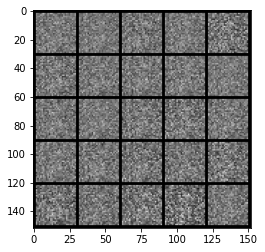

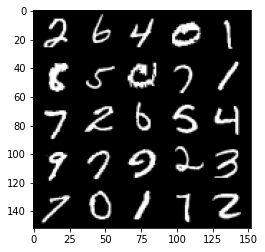

Step 200: gen_loss: 102.80201697349548, disc_loss: 49.558027267456055


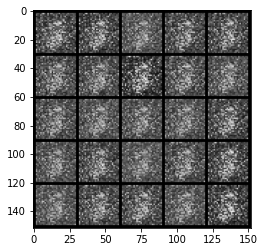

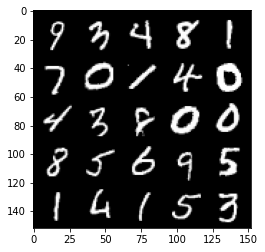

Step 300: gen_loss: 143.27669215202332, disc_loss: 32.40169185400009


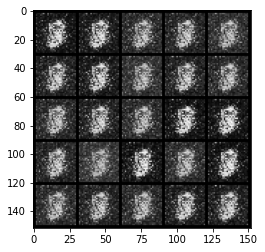

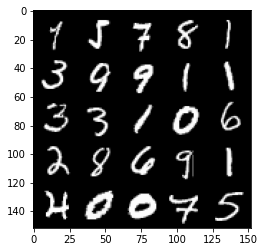

Step 400: gen_loss: 178.44353914260864, disc_loss: 27.343267142772675


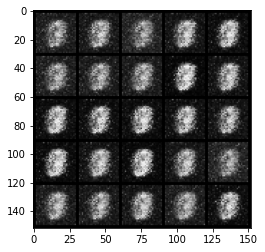

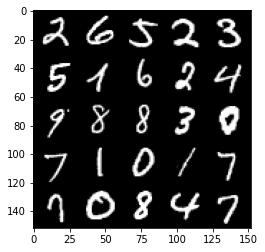

Step 500: gen_loss: 175.8340584039688, disc_loss: 31.511381775140762


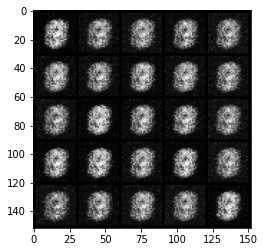

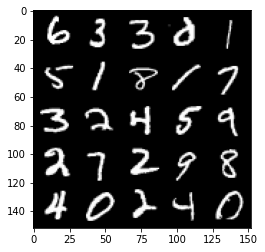

Step 600: gen_loss: 165.71610116958618, disc_loss: 32.73289346694946


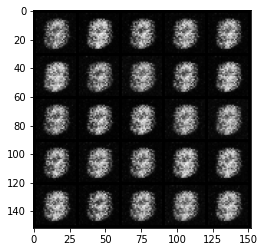

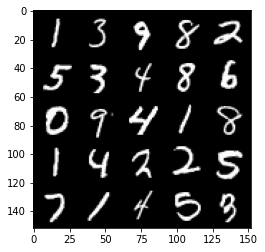

Step 700: gen_loss: 163.34077513217926, disc_loss: 31.511037170886993


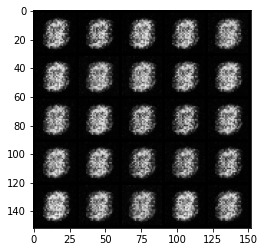

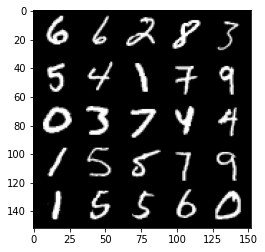

Step 800: gen_loss: 167.89881706237793, disc_loss: 28.43426749110222


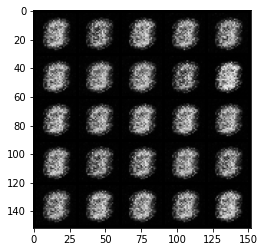

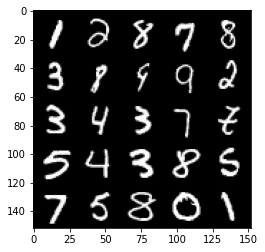

Step 900: gen_loss: 171.66705513000488, disc_loss: 26.207292571663857


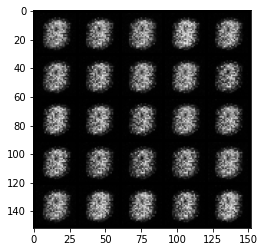

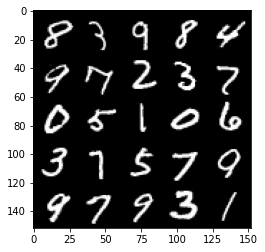

Step 1000: gen_loss: 182.45513558387756, disc_loss: 22.156614139676094


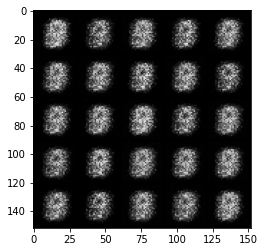

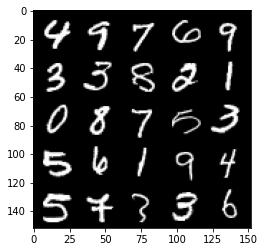

Step 1100: gen_loss: 188.58381843566895, disc_loss: 20.00691819190979


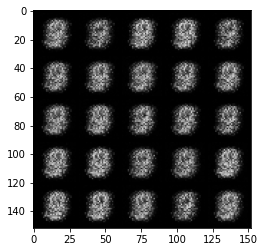

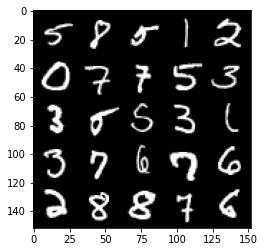

Step 1200: gen_loss: 192.26044344902039, disc_loss: 18.46776419878006


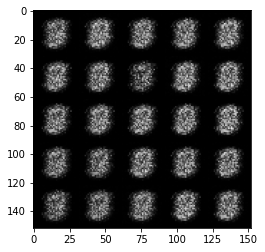

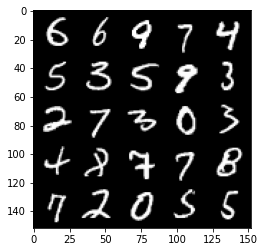

Step 1300: gen_loss: 200.89708507061005, disc_loss: 16.002971068024635


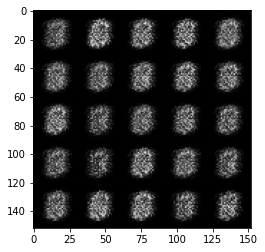

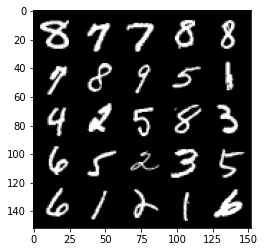

Step 1400: gen_loss: 193.75249254703522, disc_loss: 16.713411673903465


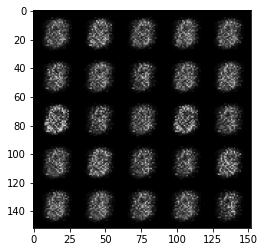

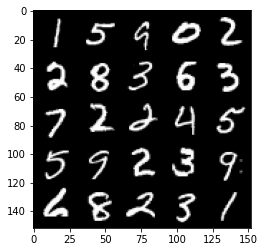

Step 1500: gen_loss: 190.82997870445251, disc_loss: 17.213872626423836


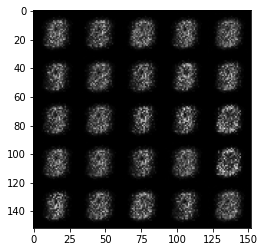

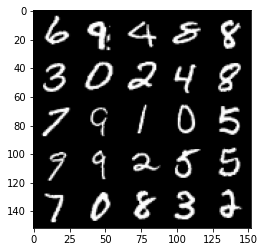

Step 1600: gen_loss: 175.0958788394928, disc_loss: 20.649895578622818


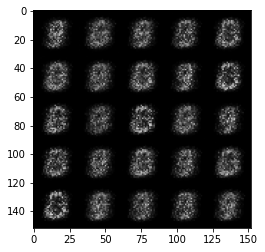

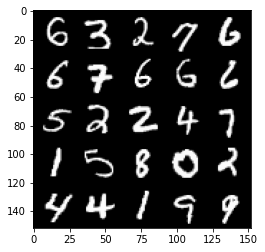

Step 1700: gen_loss: 169.73838663101196, disc_loss: 21.55207034945488


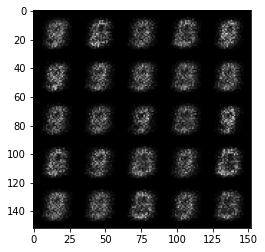

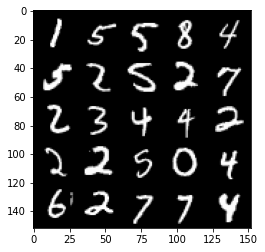

Step 1800: gen_loss: 166.6381138563156, disc_loss: 22.149458155035973


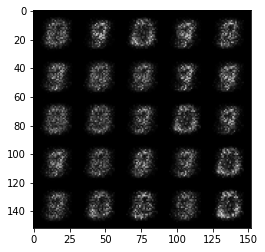

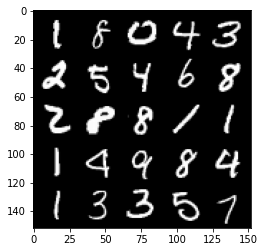

Step 1900: gen_loss: 161.39027452468872, disc_loss: 22.49678073823452


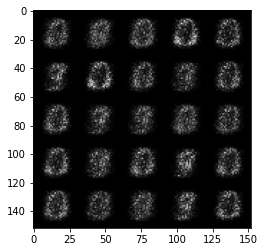

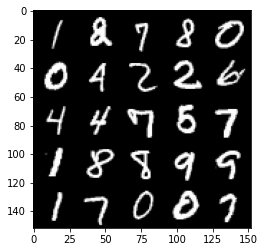

Step 2000: gen_loss: 164.77321529388428, disc_loss: 20.981826052069664


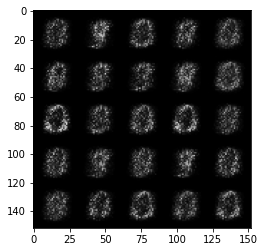

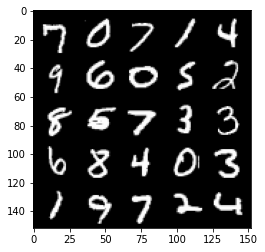

Step 2100: gen_loss: 174.04121565818787, disc_loss: 18.71286942064762


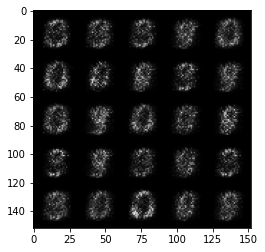

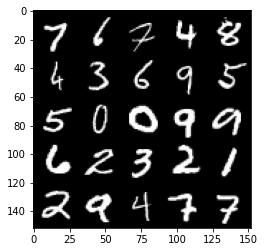

Step 2200: gen_loss: 176.62623250484467, disc_loss: 18.957533553242683


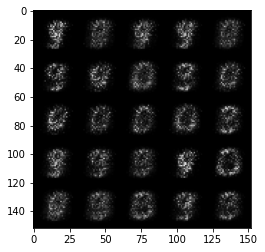

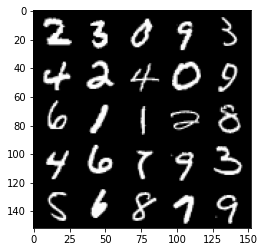

Step 2300: gen_loss: 169.2086730003357, disc_loss: 21.157660573720932


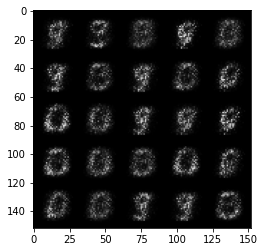

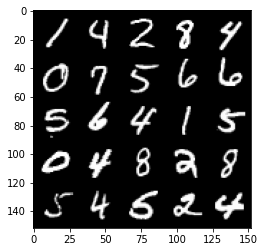

Step 2400: gen_loss: 164.89369535446167, disc_loss: 22.041138544678688


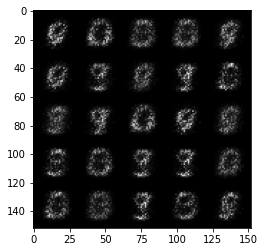

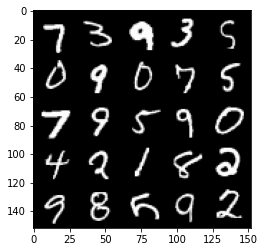

Step 2500: gen_loss: 172.19504821300507, disc_loss: 19.99391584098339


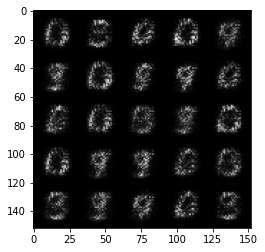

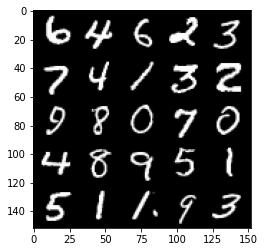

Step 2600: gen_loss: 184.93312525749207, disc_loss: 17.378041461110115


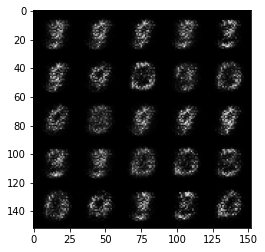

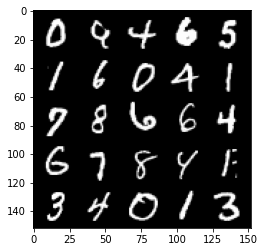

Step 2700: gen_loss: 186.64746701717377, disc_loss: 17.306202948093414


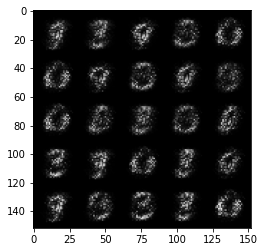

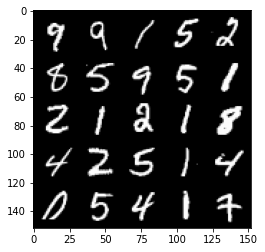

Step 2800: gen_loss: 196.38507759571075, disc_loss: 16.367100700736046


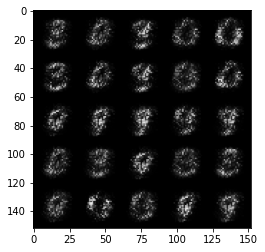

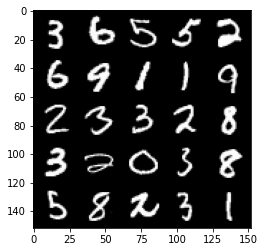

Step 2900: gen_loss: 210.40160751342773, disc_loss: 15.238940313458443


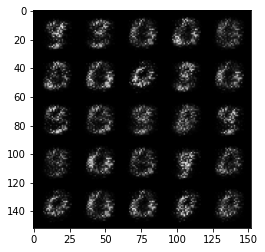

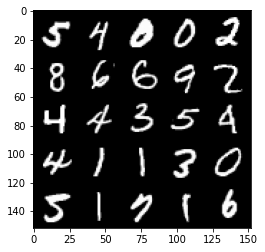

Step 3000: gen_loss: 216.56983876228333, disc_loss: 15.5623919069767


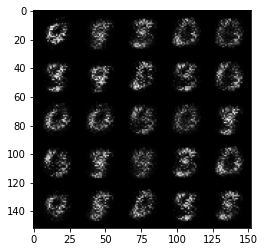

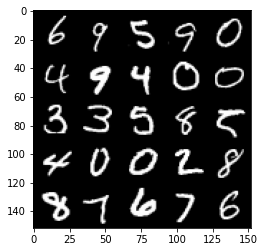

Step 3100: gen_loss: 232.0667688846588, disc_loss: 13.03161495178938


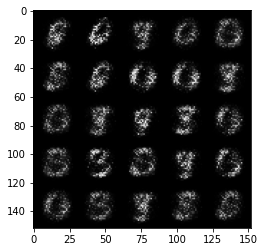

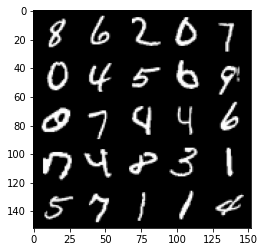

Step 3200: gen_loss: 241.48181819915771, disc_loss: 11.923620253801346


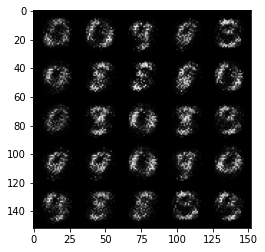

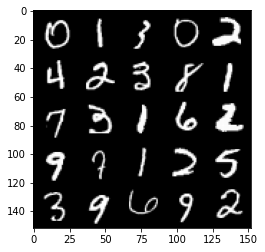

Step 3300: gen_loss: 244.29825401306152, disc_loss: 12.216425620019436


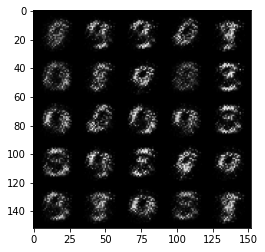

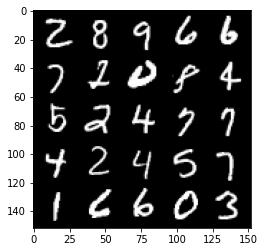

Step 3400: gen_loss: 250.90049529075623, disc_loss: 11.372939765453339


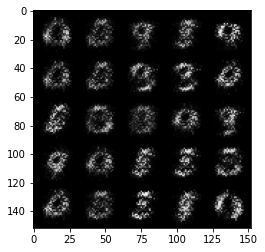

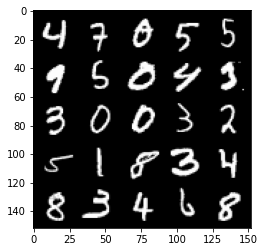

Step 3500: gen_loss: 259.9442687034607, disc_loss: 10.508346930146217


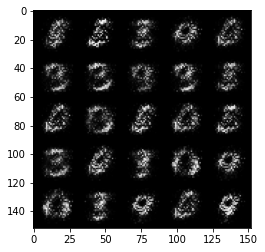

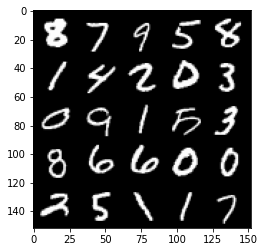

Step 3600: gen_loss: 271.99625396728516, disc_loss: 9.206273257732391


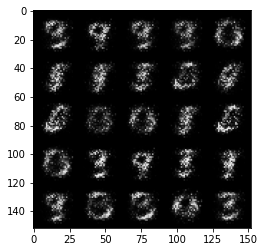

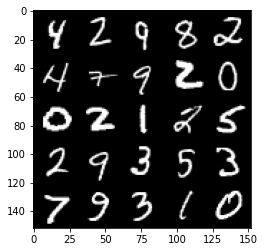

Step 3700: gen_loss: 276.73112058639526, disc_loss: 9.36736585199833


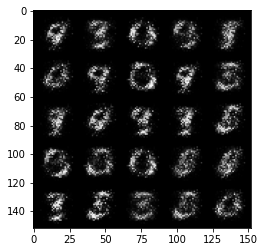

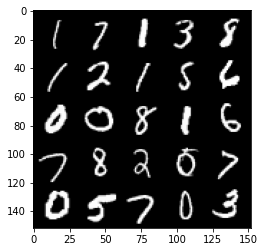

Step 3800: gen_loss: 283.7464644908905, disc_loss: 9.401937037706375


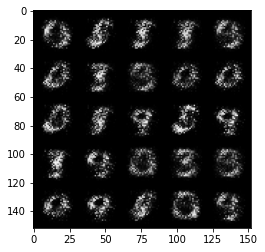

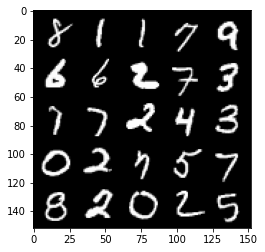

Step 3900: gen_loss: 295.6335651874542, disc_loss: 8.960217379033566


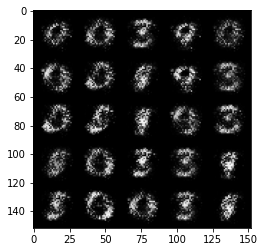

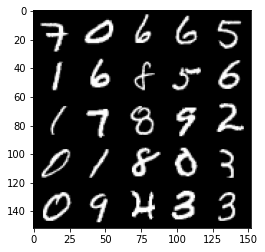

Step 4000: gen_loss: 314.54717540740967, disc_loss: 7.962471257895231


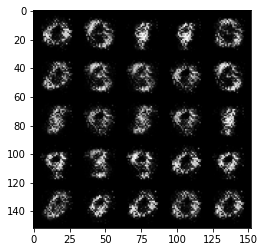

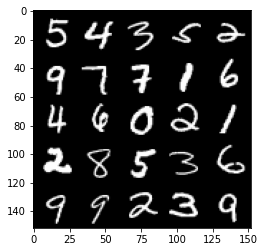

Step 4100: gen_loss: 325.7185478210449, disc_loss: 7.4703491143882275


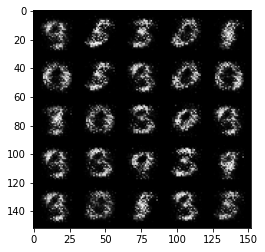

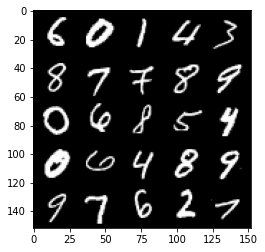

Step 4200: gen_loss: 336.41414046287537, disc_loss: 7.3342464454472065


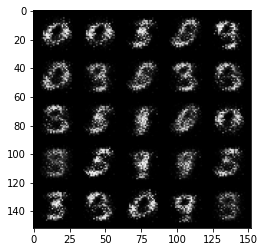

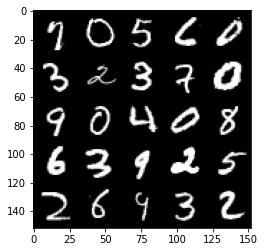

Step 4300: gen_loss: 333.4791347980499, disc_loss: 7.892554555088282


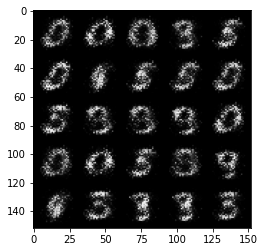

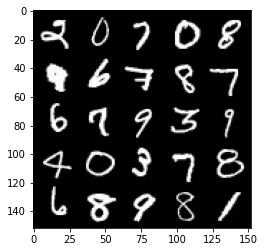

Step 4400: gen_loss: 340.4448597431183, disc_loss: 7.592073440551758


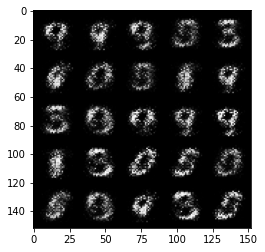

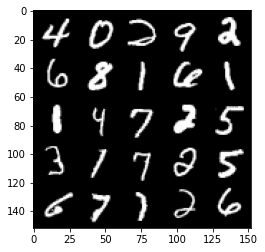

Step 4500: gen_loss: 349.38449025154114, disc_loss: 6.930991891771555


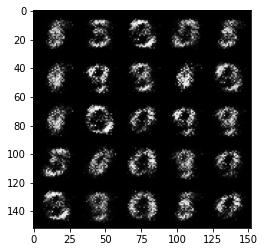

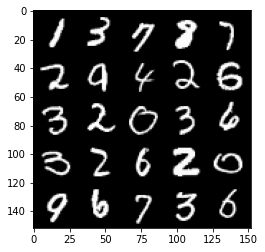

Step 4600: gen_loss: 351.00949239730835, disc_loss: 6.970884598791599


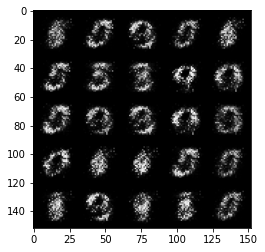

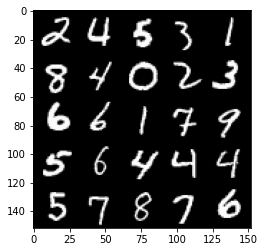

Step 4700: gen_loss: 349.6210730075836, disc_loss: 6.971081547439098


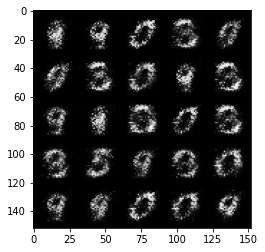

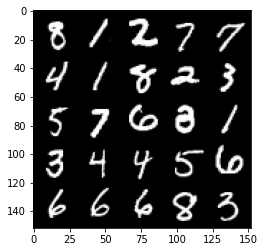

Step 4800: gen_loss: 337.90138387680054, disc_loss: 7.403749015182257


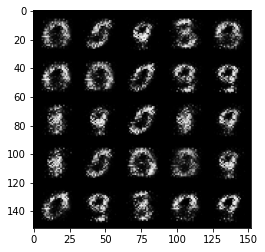

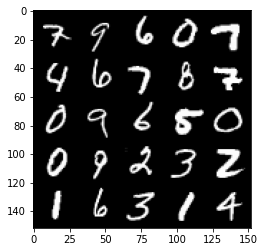

Step 4900: gen_loss: 332.1442382335663, disc_loss: 7.5270744524896145


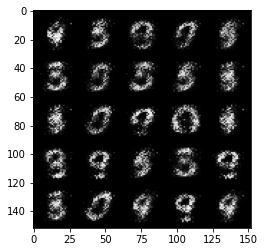

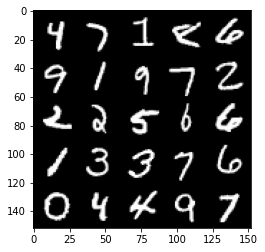

Step 5000: gen_loss: 323.88666820526123, disc_loss: 7.990100882947445


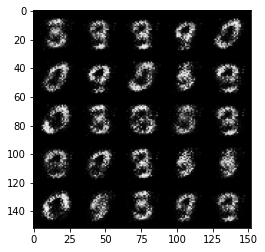

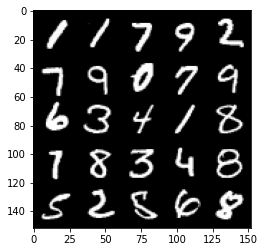

Step 5100: gen_loss: 333.07834792137146, disc_loss: 7.787204835563898


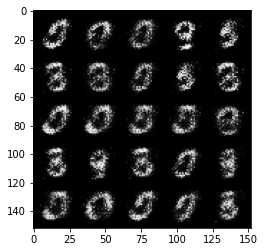

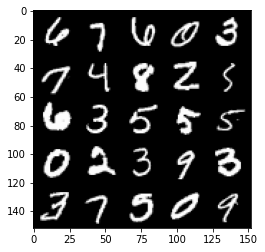

Step 5200: gen_loss: 343.70467233657837, disc_loss: 8.079123921692371


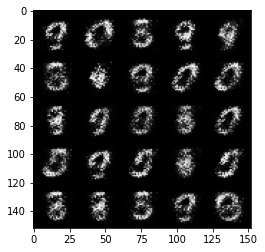

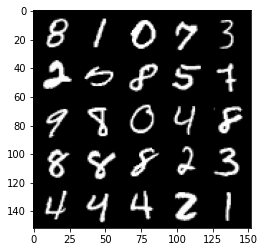

Step 5300: gen_loss: 349.50989532470703, disc_loss: 7.8808028399944305


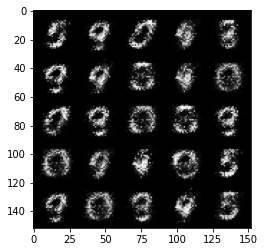

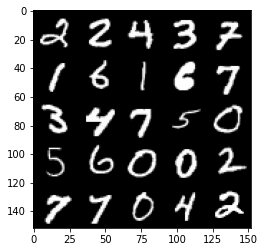

Step 5400: gen_loss: 353.3849859237671, disc_loss: 7.974862229079008


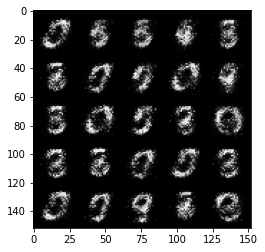

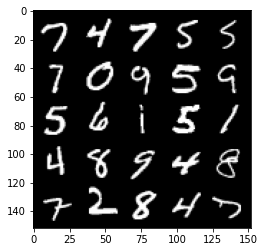

Step 5500: gen_loss: 356.8044946193695, disc_loss: 8.783751659095287


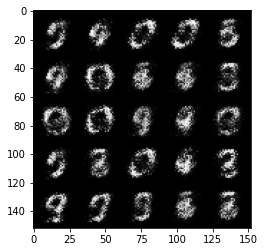

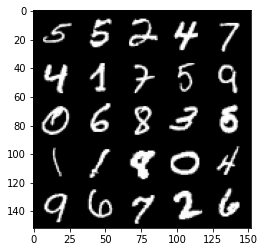

Step 5600: gen_loss: 367.0115189552307, disc_loss: 8.512876089662313


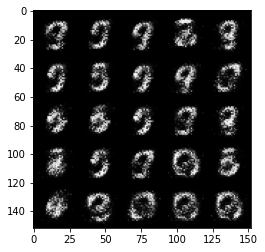

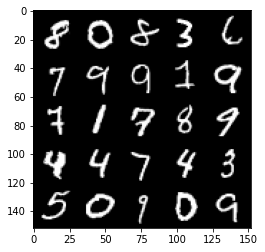

Step 5700: gen_loss: 376.8170027732849, disc_loss: 7.084704753011465


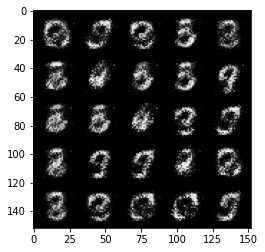

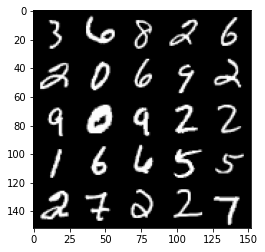

Step 5800: gen_loss: 375.0337369441986, disc_loss: 6.3522245697677135


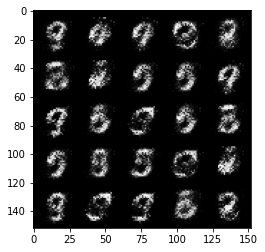

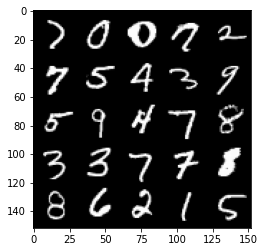

Step 5900: gen_loss: 373.8125433921814, disc_loss: 6.501790467649698


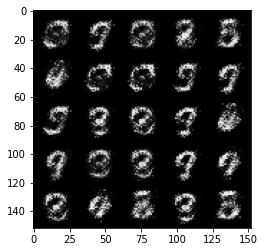

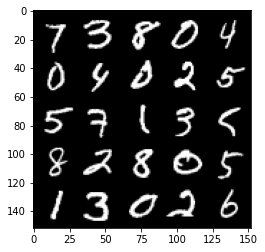

Step 6000: gen_loss: 369.1863102912903, disc_loss: 6.2865676917135715


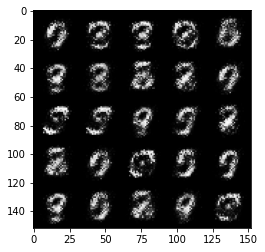

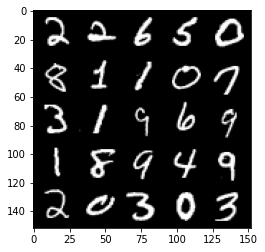

Step 6100: gen_loss: 365.7715883255005, disc_loss: 6.450304262340069


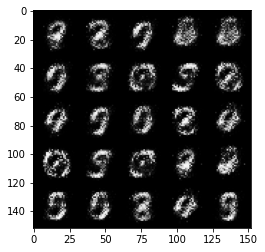

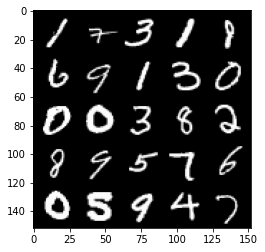

Step 6200: gen_loss: 375.27050852775574, disc_loss: 5.445623265579343


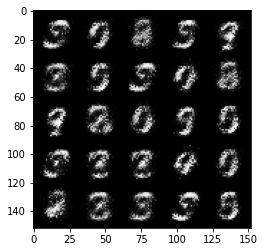

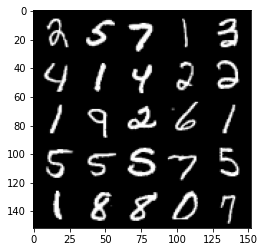

Step 6300: gen_loss: 387.8829278945923, disc_loss: 5.084746103733778


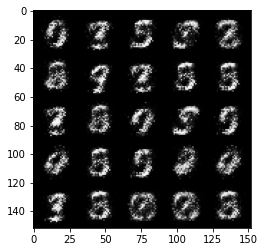

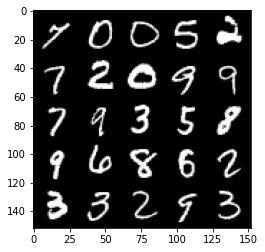

Step 6400: gen_loss: 403.86730432510376, disc_loss: 5.319378577172756


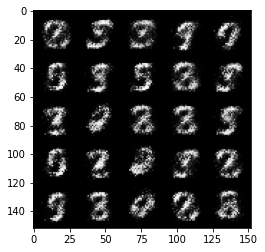

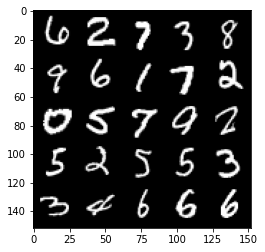

Step 6500: gen_loss: 402.0658679008484, disc_loss: 5.45765220746398


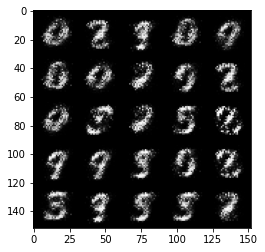

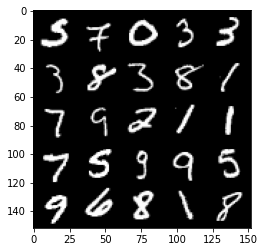

Step 6600: gen_loss: 390.5792715549469, disc_loss: 5.933469675481319


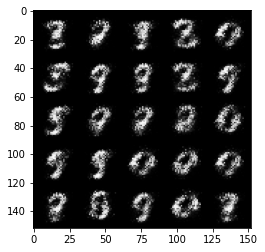

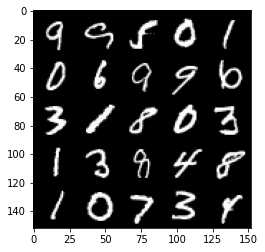

Step 6700: gen_loss: 382.3463020324707, disc_loss: 6.414051830768585


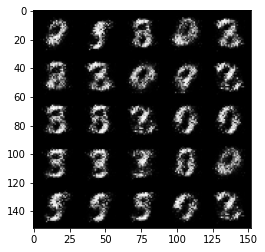

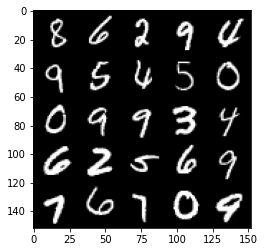

Step 6800: gen_loss: 385.5018632411957, disc_loss: 6.435127507895231


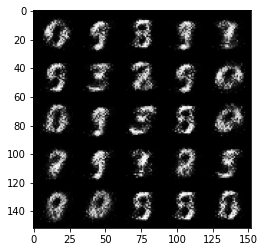

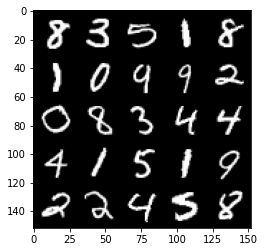

Step 6900: gen_loss: 382.33913254737854, disc_loss: 6.208152983337641


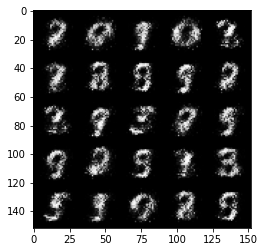

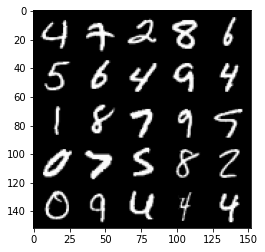

Step 7000: gen_loss: 379.6481397151947, disc_loss: 6.035318968817592


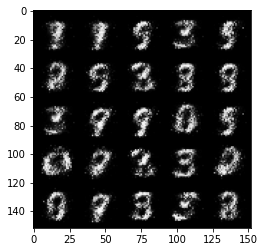

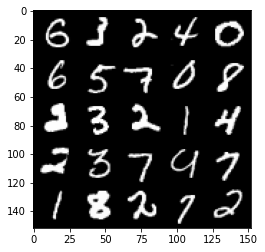

Step 7100: gen_loss: 378.0484344959259, disc_loss: 5.732582025229931


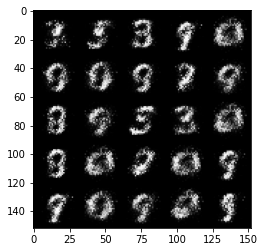

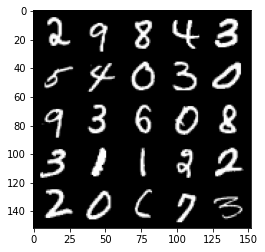

Step 7200: gen_loss: 387.2937400341034, disc_loss: 5.394854295998812


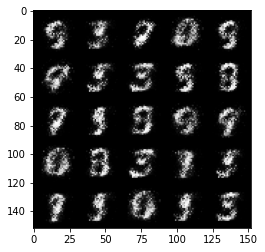

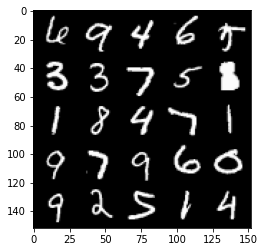

Step 7300: gen_loss: 394.2699148654938, disc_loss: 5.190929185599089


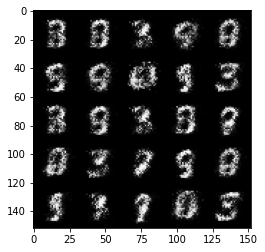

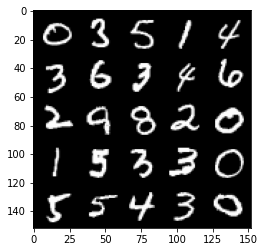

Step 7400: gen_loss: 393.4551544189453, disc_loss: 5.277839105576277


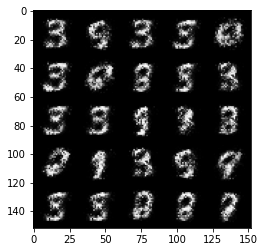

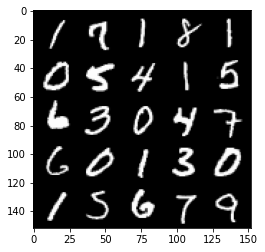

Step 7500: gen_loss: 387.83048391342163, disc_loss: 5.1909433994442225


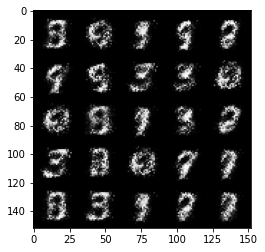

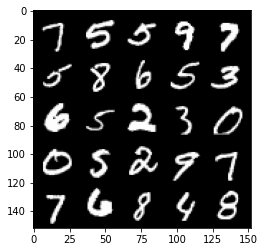

Step 7600: gen_loss: 398.4731636047363, disc_loss: 4.818822238594294


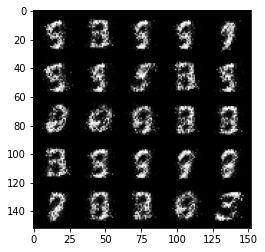

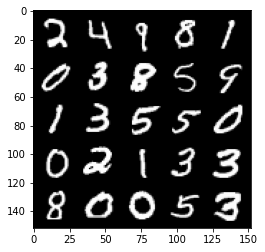

Step 7700: gen_loss: 405.82863903045654, disc_loss: 4.748192755505443


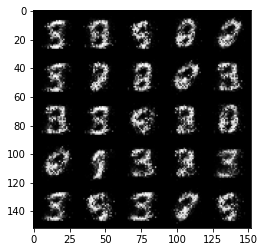

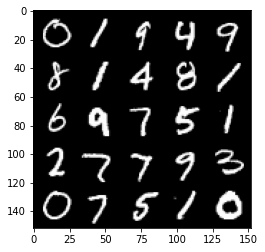

Step 7800: gen_loss: 411.96106791496277, disc_loss: 4.568486196920276


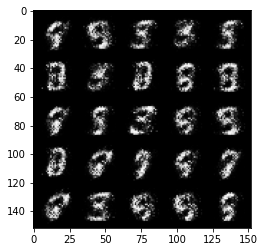

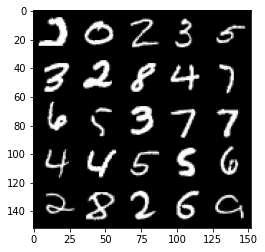

Step 7900: gen_loss: 414.78179383277893, disc_loss: 4.51559330150485


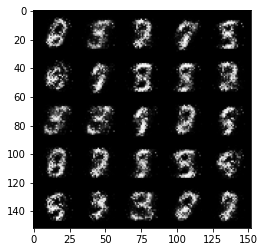

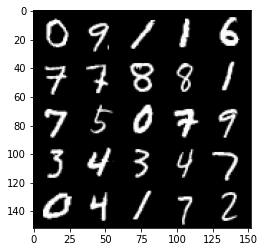

Step 8000: gen_loss: 422.61374378204346, disc_loss: 4.4959967359900475


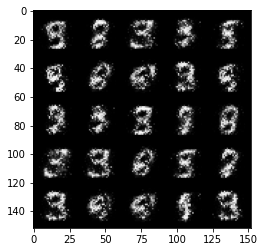

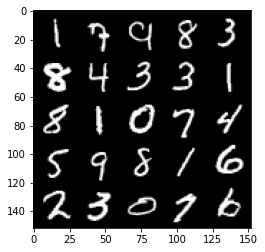

Step 8100: gen_loss: 421.8046033382416, disc_loss: 4.657880512997508


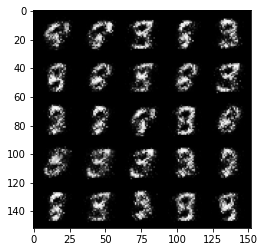

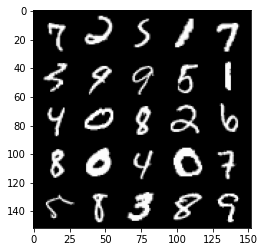

Step 8200: gen_loss: 423.72765135765076, disc_loss: 5.251107895746827


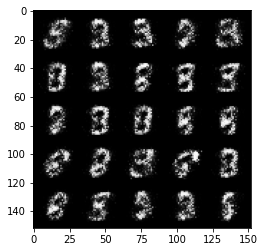

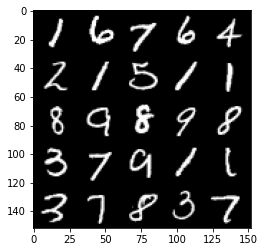

Step 8300: gen_loss: 417.97902059555054, disc_loss: 5.80926707200706


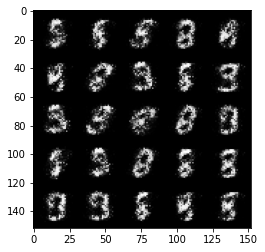

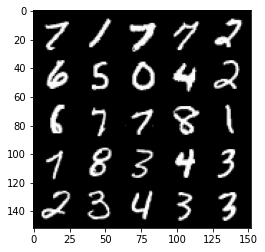

Step 8400: gen_loss: 418.9296233654022, disc_loss: 5.4534291960299015


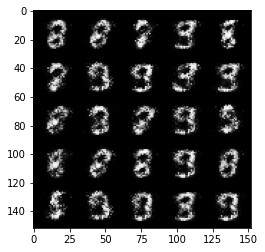

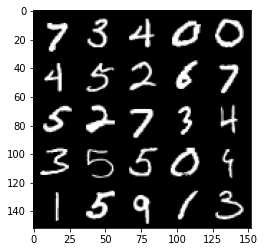

Step 8500: gen_loss: 411.1801211833954, disc_loss: 5.4211190063506365


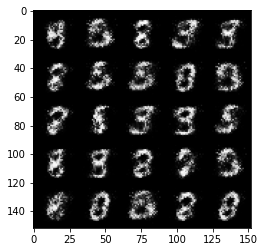

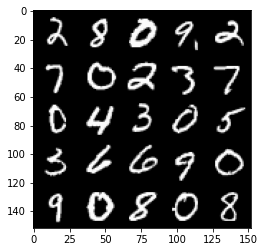

Step 8600: gen_loss: 410.56247758865356, disc_loss: 5.673442576080561


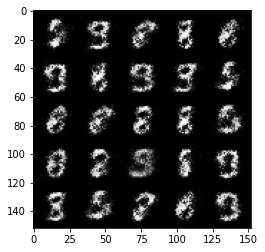

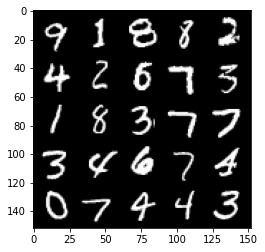

Step 8700: gen_loss: 420.9582505226135, disc_loss: 5.889390479773283


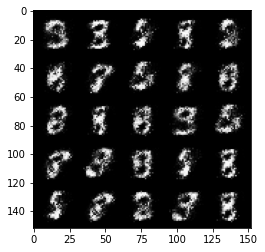

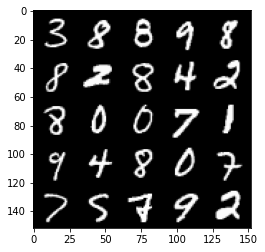

Step 8800: gen_loss: 439.3386595249176, disc_loss: 5.285022372379899


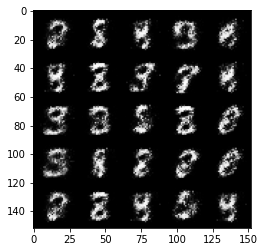

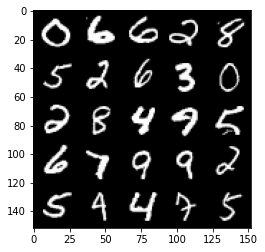

Step 8900: gen_loss: 429.2433080673218, disc_loss: 5.429888578131795


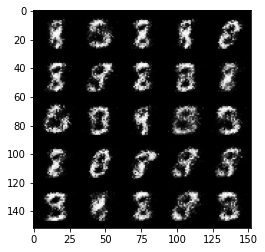

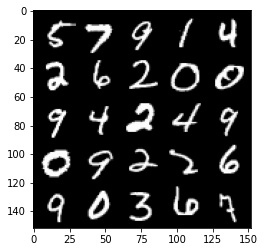

Step 9000: gen_loss: 414.8874843120575, disc_loss: 5.816016495227814


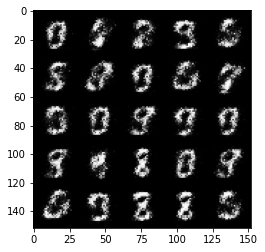

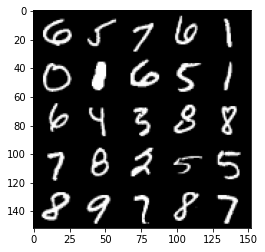

Step 9100: gen_loss: 416.30569553375244, disc_loss: 5.71979190222919


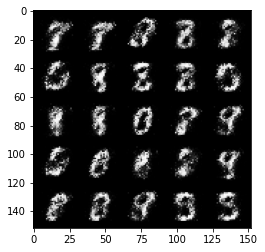

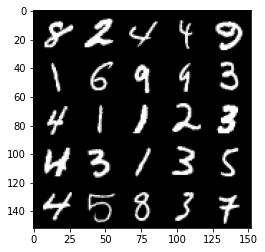

Step 9200: gen_loss: 415.1547496318817, disc_loss: 5.770737186074257


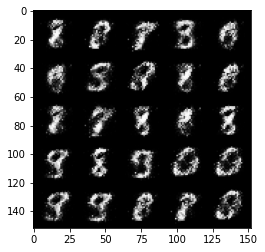

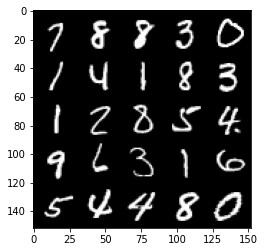

Step 9300: gen_loss: 401.900675535202, disc_loss: 6.215774483978748


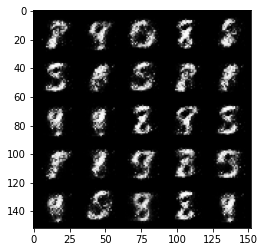

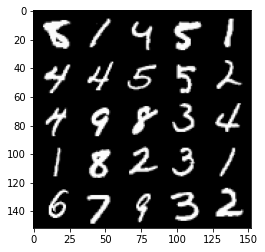

Step 9400: gen_loss: 394.5192244052887, disc_loss: 6.533277343958616


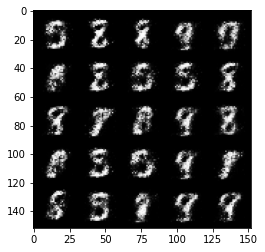

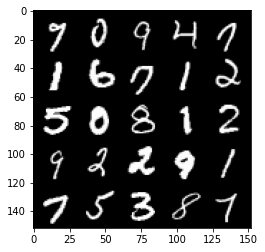

Step 9500: gen_loss: 408.7113378047943, disc_loss: 6.202843574807048


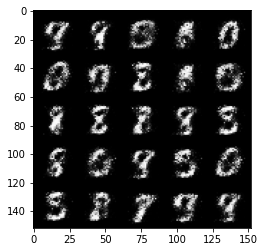

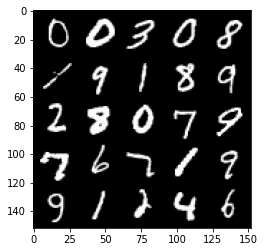

Step 9600: gen_loss: 415.02651476860046, disc_loss: 5.894952040165663


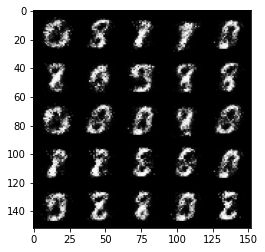

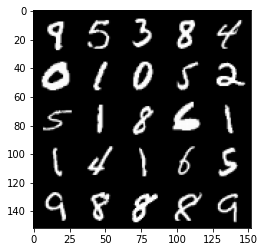

Step 9700: gen_loss: 422.04096841812134, disc_loss: 5.161371313035488


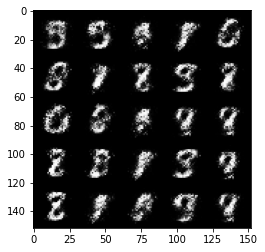

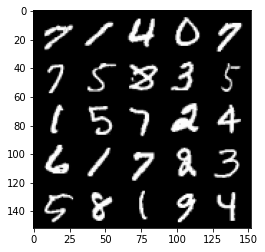

Step 9800: gen_loss: 418.055566072464, disc_loss: 5.423651795834303


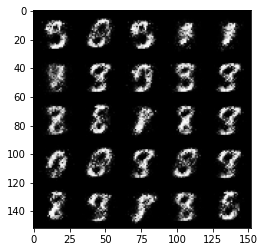

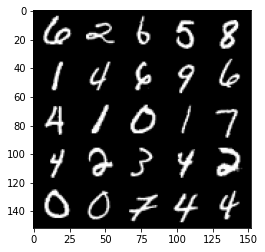

Step 9900: gen_loss: 418.6244707107544, disc_loss: 5.215338243171573


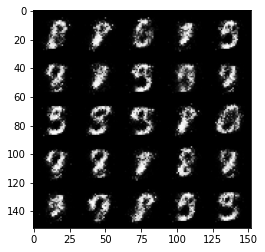

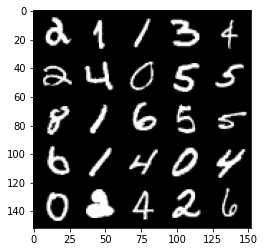

Step 10000: gen_loss: 417.3055181503296, disc_loss: 5.2989138178527355


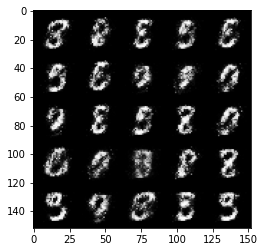

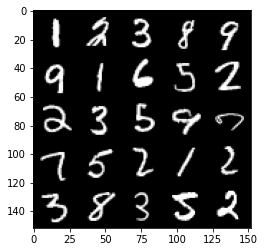

Step 10100: gen_loss: 401.41727113723755, disc_loss: 5.4381215907633305


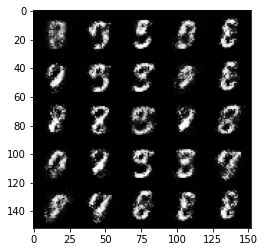

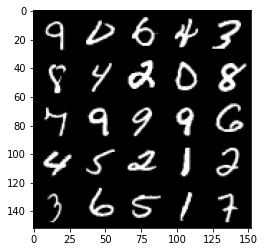

Step 10200: gen_loss: 404.3590018749237, disc_loss: 5.405902147293091


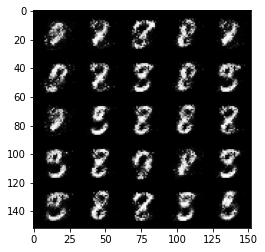

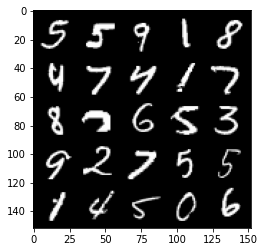

Step 10300: gen_loss: 420.10530972480774, disc_loss: 4.991331746801734


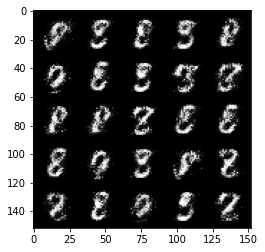

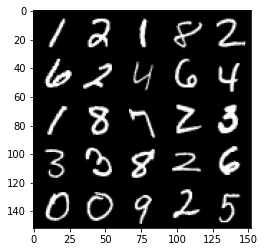

Step 10400: gen_loss: 429.35514402389526, disc_loss: 5.095746880397201


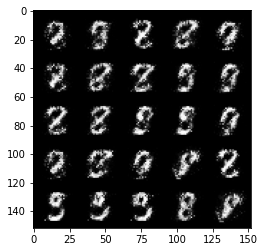

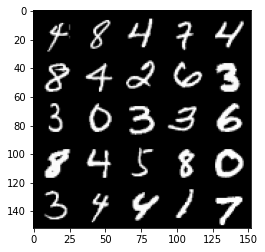

Step 10500: gen_loss: 425.593035697937, disc_loss: 5.189595052972436


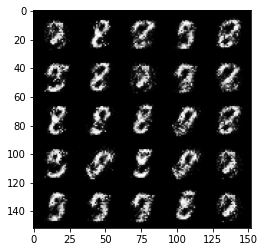

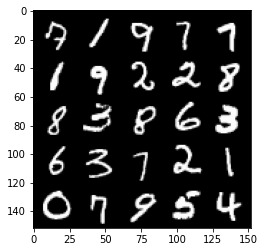

Step 10600: gen_loss: 427.8212823867798, disc_loss: 5.891593249514699


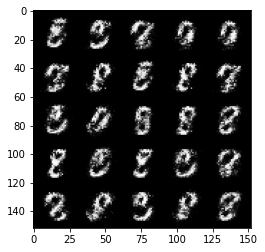

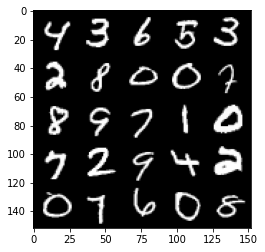

Step 10700: gen_loss: 428.2222709655762, disc_loss: 6.047136016190052


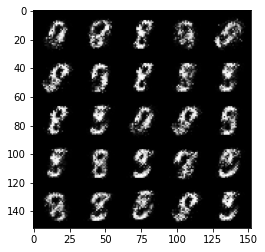

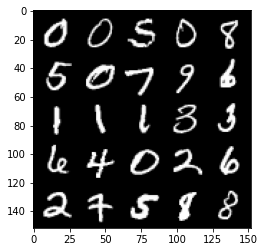

Step 10800: gen_loss: 421.14981746673584, disc_loss: 5.796560883522034


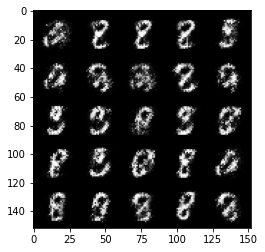

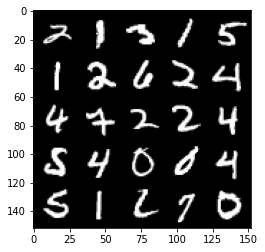

Step 10900: gen_loss: 407.9504642486572, disc_loss: 6.128128960728645


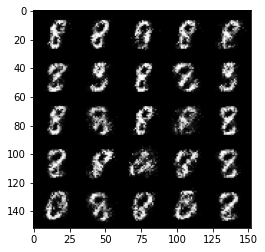

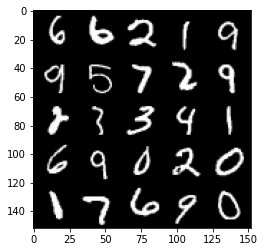

Step 11000: gen_loss: 407.82507038116455, disc_loss: 6.825523689389229


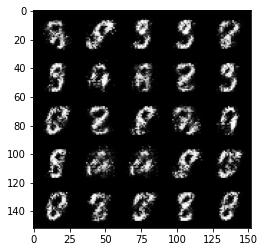

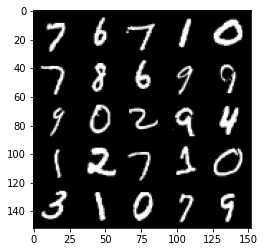

Step 11100: gen_loss: 398.5224578380585, disc_loss: 7.147695060819387


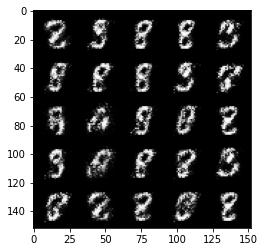

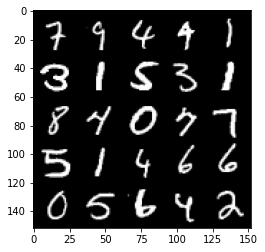

Step 11200: gen_loss: 416.06848216056824, disc_loss: 6.211712136864662


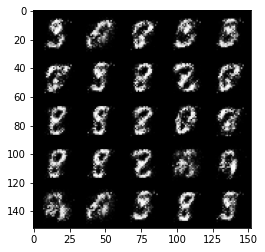

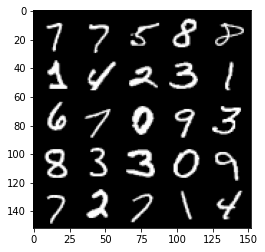

Step 11300: gen_loss: 416.0891537666321, disc_loss: 6.412311103194952


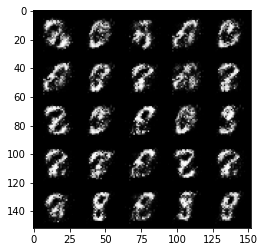

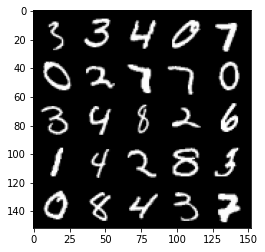

Step 11400: gen_loss: 386.7306032180786, disc_loss: 6.819268548861146


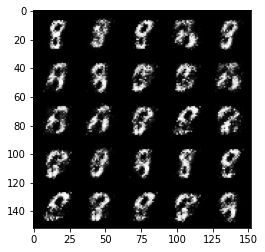

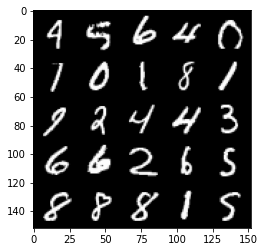

Step 11500: gen_loss: 370.2101819515228, disc_loss: 8.12296513095498


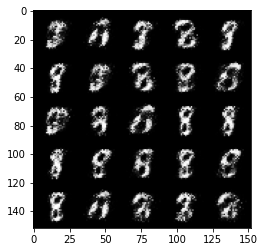

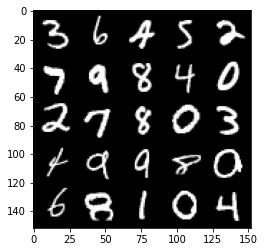

Step 11600: gen_loss: 377.0948371887207, disc_loss: 7.57815894857049


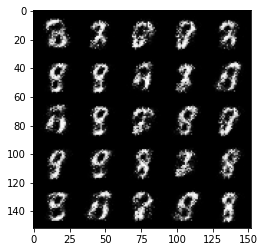

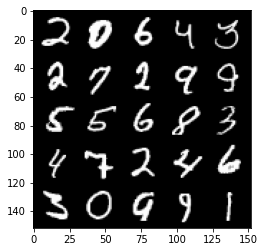

Step 11700: gen_loss: 388.2407548427582, disc_loss: 7.719022873789072


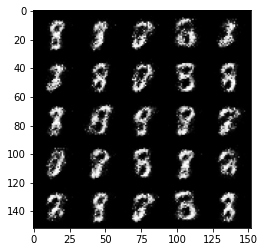

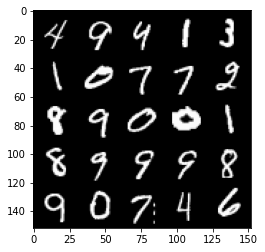

Step 11800: gen_loss: 383.6015808582306, disc_loss: 7.7815616354346275


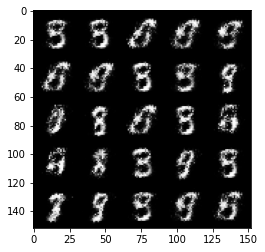

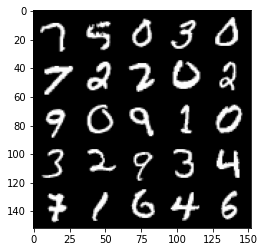

Step 11900: gen_loss: 392.5623140335083, disc_loss: 7.424646232277155


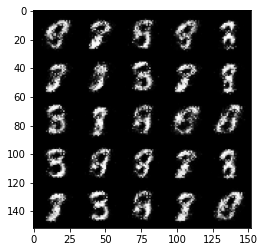

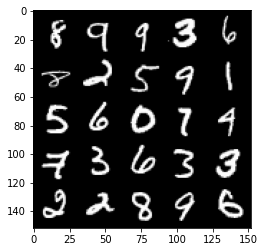

Step 12000: gen_loss: 399.7966046333313, disc_loss: 7.252472005784512


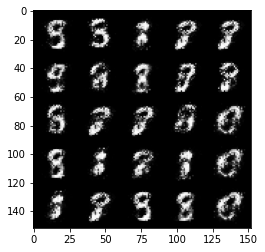

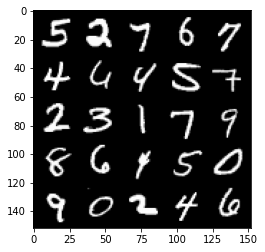

Step 12100: gen_loss: 398.324533700943, disc_loss: 8.002869687974453


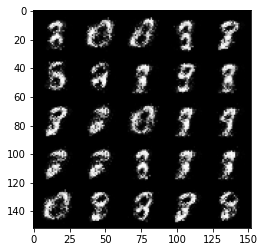

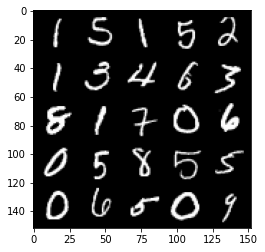

Step 12200: gen_loss: 403.26499605178833, disc_loss: 7.601428862661123


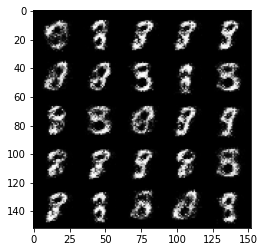

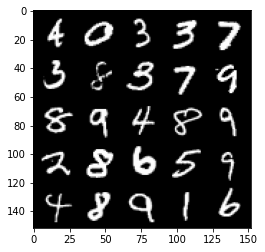

Step 12300: gen_loss: 403.5776207447052, disc_loss: 7.017488703131676


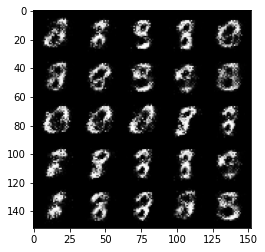

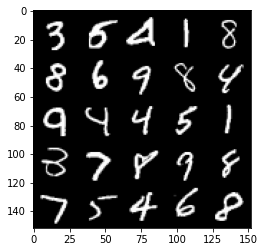

Step 12400: gen_loss: 424.72379183769226, disc_loss: 7.084730755537748


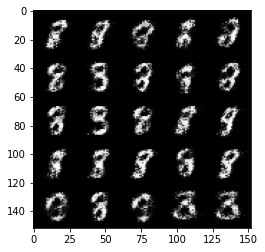

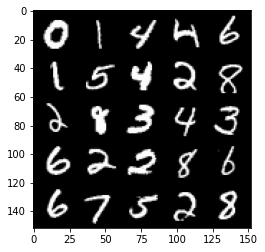

Step 12500: gen_loss: 429.4316837787628, disc_loss: 7.122251451015472


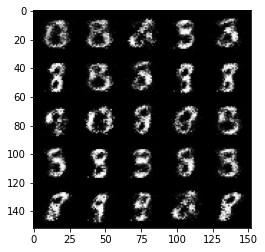

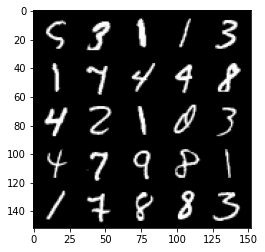

Step 12600: gen_loss: 417.09330654144287, disc_loss: 7.30436897277832


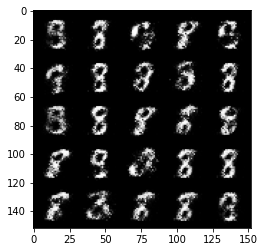

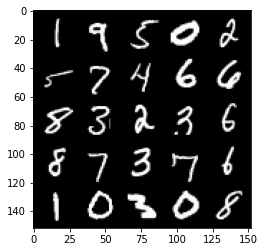

Step 12700: gen_loss: 394.8141553401947, disc_loss: 8.14550007879734


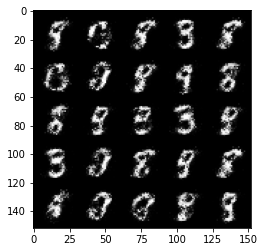

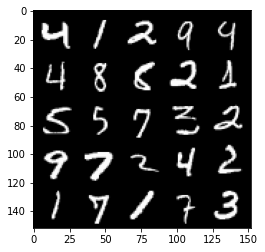

Step 12800: gen_loss: 388.2845573425293, disc_loss: 8.088039059191942


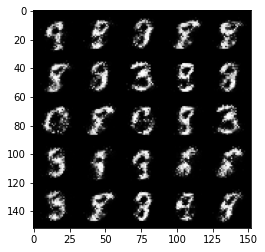

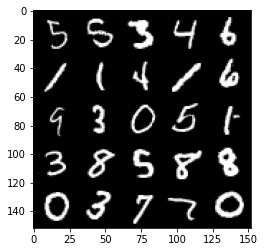

Step 12900: gen_loss: 391.0544295310974, disc_loss: 7.041771877557039


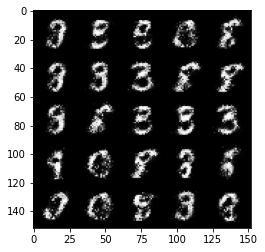

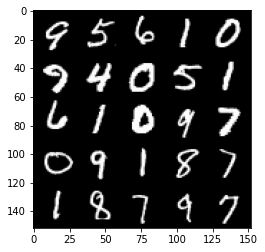

Step 13000: gen_loss: 396.17737650871277, disc_loss: 7.440001547336578


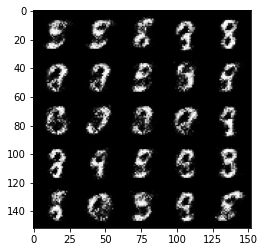

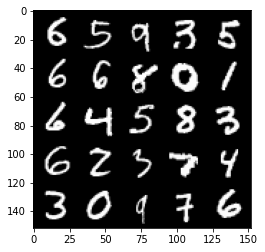

Step 13100: gen_loss: 398.96074390411377, disc_loss: 8.342892423272133


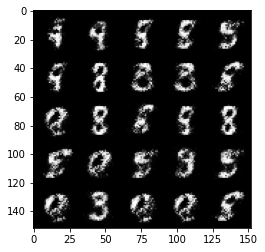

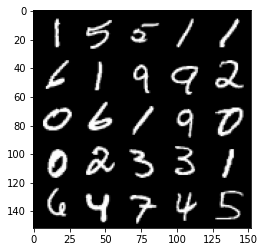

Step 13200: gen_loss: 395.89388155937195, disc_loss: 9.084711790084839


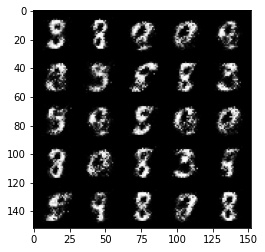

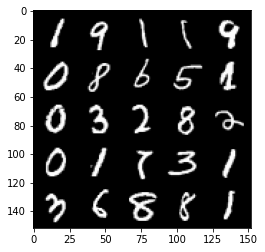

Step 13300: gen_loss: 392.4583828449249, disc_loss: 9.437807198613882


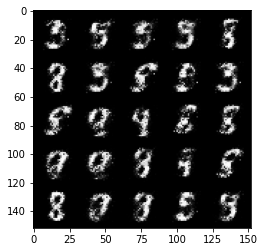

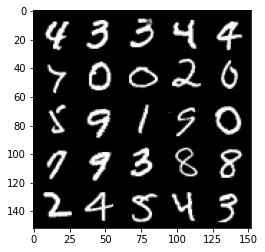

Step 13400: gen_loss: 393.8786106109619, disc_loss: 9.123202193528414


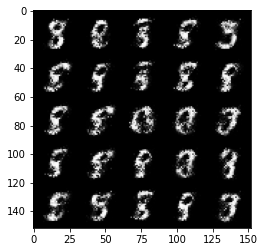

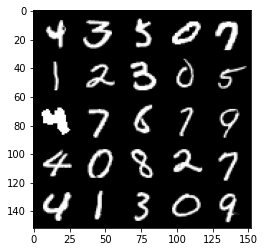

Step 13500: gen_loss: 404.70240235328674, disc_loss: 7.933758217841387


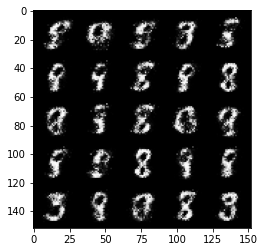

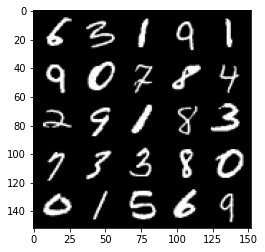

Step 13600: gen_loss: 399.6929063796997, disc_loss: 7.951932527124882


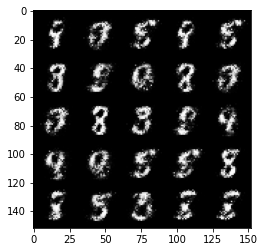

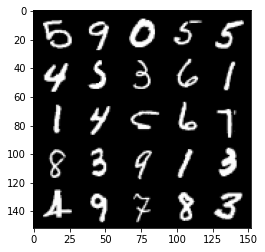

Step 13700: gen_loss: 392.2394654750824, disc_loss: 7.657767679542303


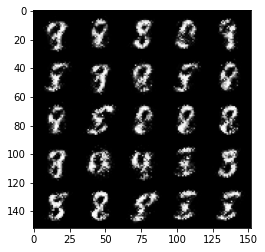

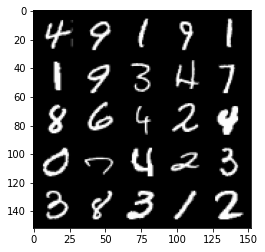

Step 13800: gen_loss: 397.18120861053467, disc_loss: 8.408619932830334


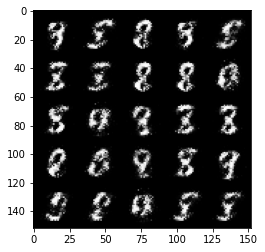

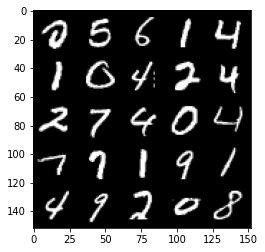

Step 13900: gen_loss: 386.6224892139435, disc_loss: 8.602387122809887


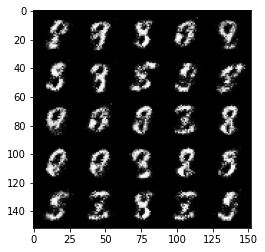

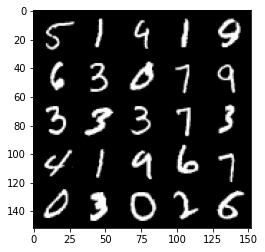

Step 14000: gen_loss: 379.7009298801422, disc_loss: 9.208389680832624


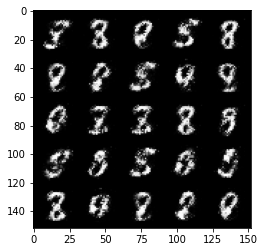

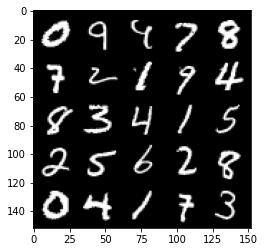

Step 14100: gen_loss: 367.7403790950775, disc_loss: 10.382213409990072


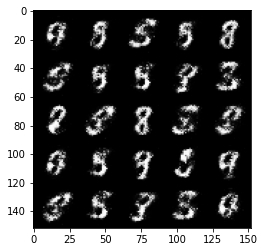

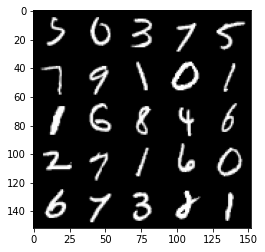

Step 14200: gen_loss: 374.7074749469757, disc_loss: 9.255283538252115


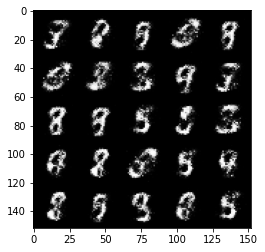

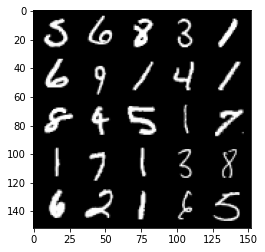

Step 14300: gen_loss: 371.4537832736969, disc_loss: 8.781637106090784


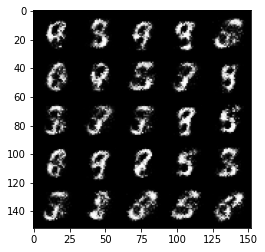

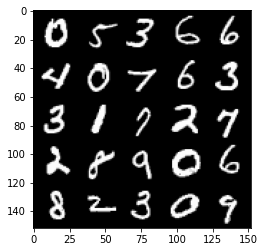

Step 14400: gen_loss: 370.950777053833, disc_loss: 9.315413519740105


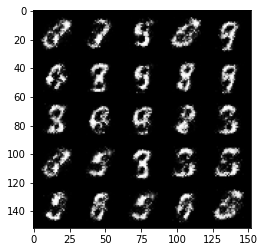

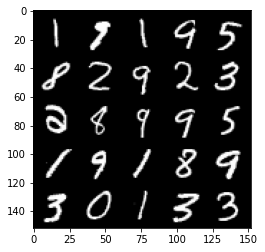

Step 14500: gen_loss: 363.35067224502563, disc_loss: 10.48759362846613


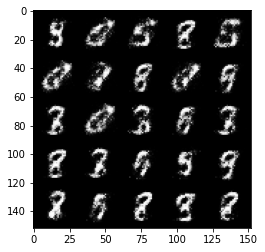

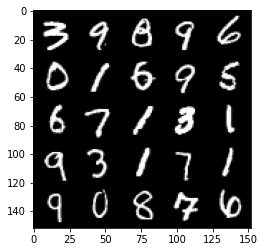

Step 14600: gen_loss: 351.0573220252991, disc_loss: 10.934498563408852


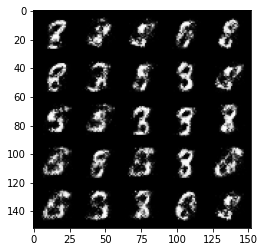

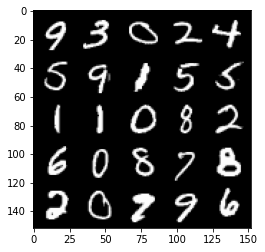

Step 14700: gen_loss: 344.57585525512695, disc_loss: 10.667325645685196


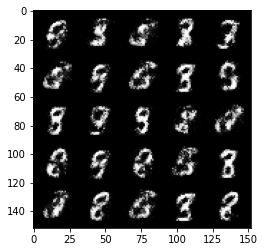

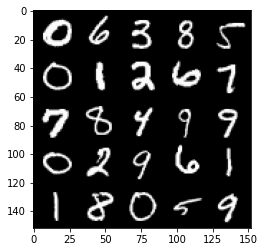

Step 14800: gen_loss: 348.4506404399872, disc_loss: 10.210250921547413


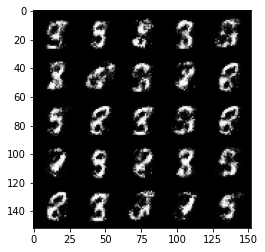

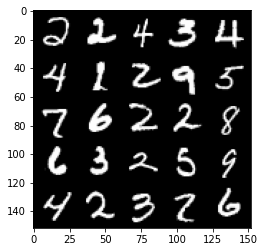

Step 14900: gen_loss: 353.73457884788513, disc_loss: 9.16720025986433


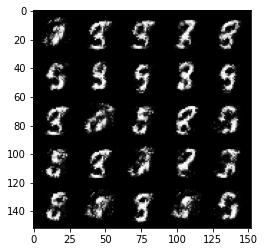

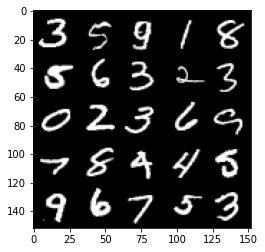

Step 15000: gen_loss: 383.736603975296, disc_loss: 8.793930679559708


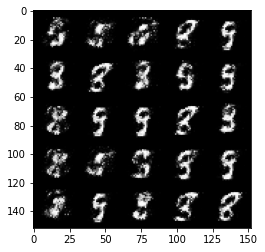

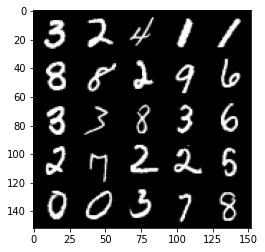

Step 15100: gen_loss: 384.09347677230835, disc_loss: 8.69789320230484


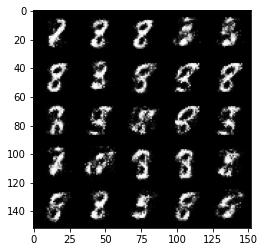

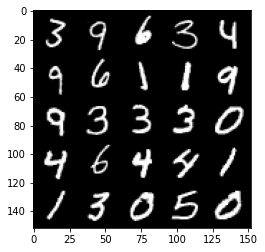

Step 15200: gen_loss: 383.9875099658966, disc_loss: 9.13395332545042


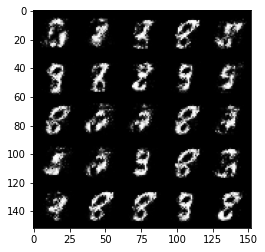

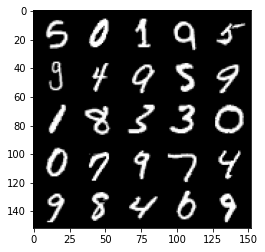

Step 15300: gen_loss: 382.35763001441956, disc_loss: 9.414428815245628


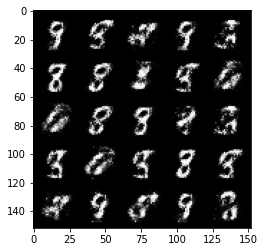

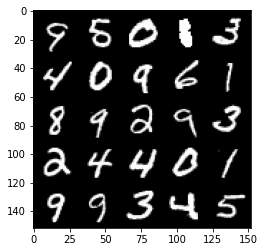

Step 15400: gen_loss: 395.5691421031952, disc_loss: 9.878663446754217


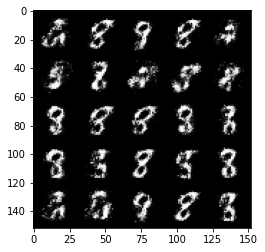

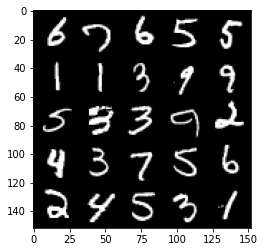

Step 15500: gen_loss: 377.7506000995636, disc_loss: 10.387123197317123


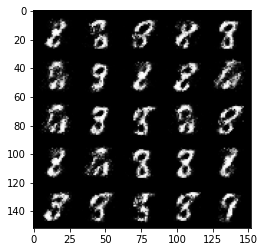

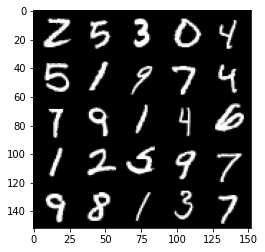

Step 15600: gen_loss: 362.8776595592499, disc_loss: 11.266609445214272


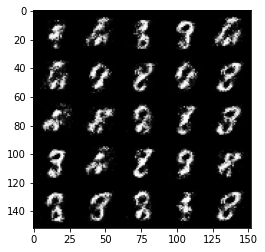

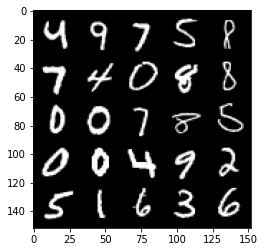

Step 15700: gen_loss: 377.28904724121094, disc_loss: 9.796340003609657


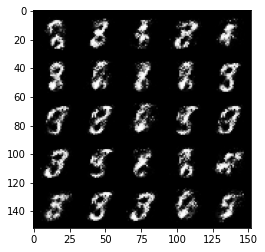

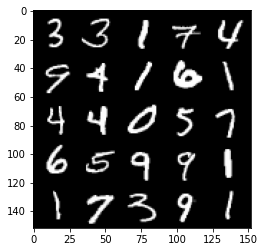

Step 15800: gen_loss: 375.0343565940857, disc_loss: 9.168456643819809


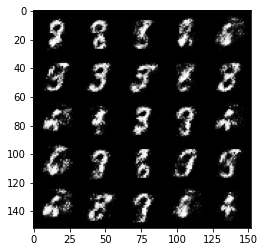

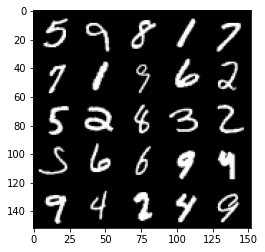

Step 15900: gen_loss: 374.449360370636, disc_loss: 9.817277885973454


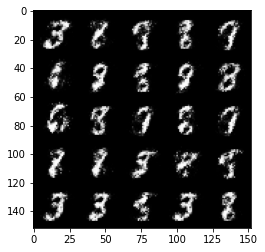

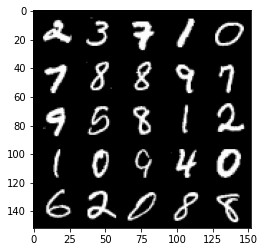

Step 16000: gen_loss: 367.31440353393555, disc_loss: 10.159217029809952


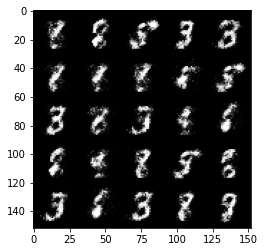

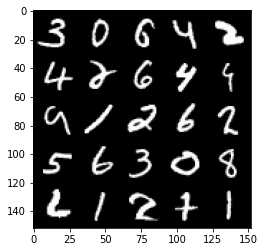

Step 16100: gen_loss: 363.3943922519684, disc_loss: 10.735222548246384


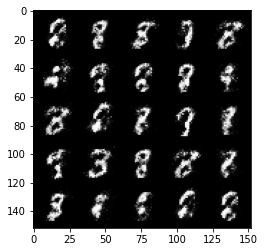

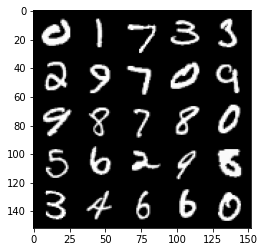

Step 16200: gen_loss: 364.75844049453735, disc_loss: 11.798176437616348


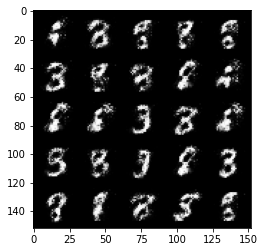

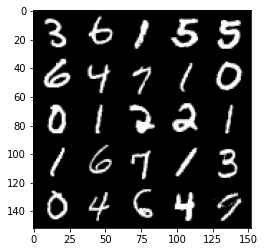

Step 16300: gen_loss: 370.7693123817444, disc_loss: 10.86055613681674


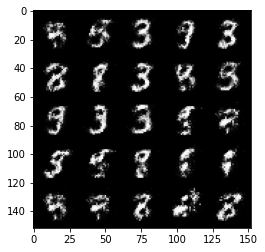

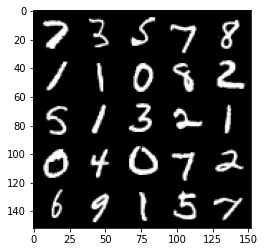

Step 16400: gen_loss: 378.69874906539917, disc_loss: 9.41402329877019


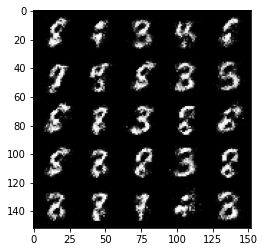

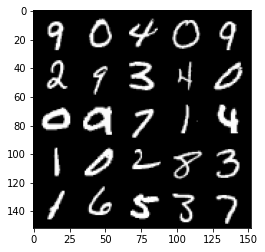

Step 16500: gen_loss: 378.8574345111847, disc_loss: 9.50314200669527


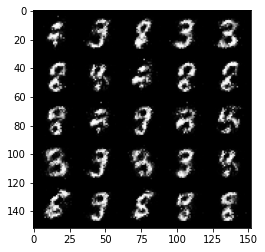

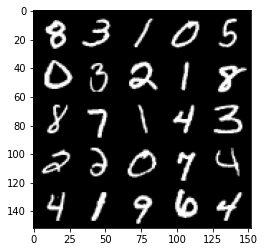

Step 16600: gen_loss: 369.3114104270935, disc_loss: 11.14735209196806


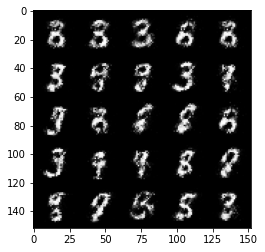

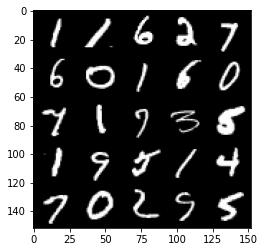

Step 16700: gen_loss: 358.06399178504944, disc_loss: 12.297579437494278


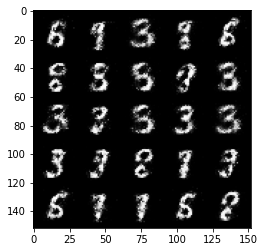

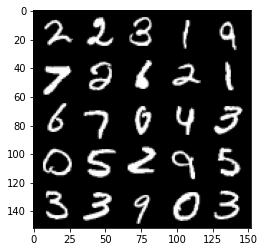

Step 16800: gen_loss: 369.7127254009247, disc_loss: 12.760221756994724


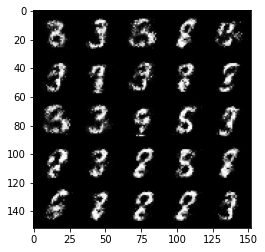

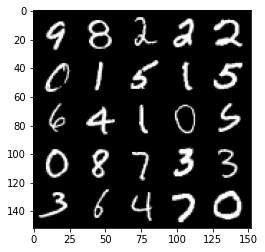

Step 16900: gen_loss: 370.30400371551514, disc_loss: 12.387941863387823


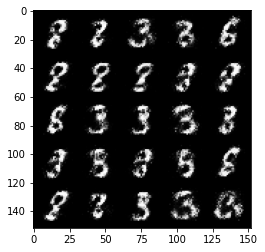

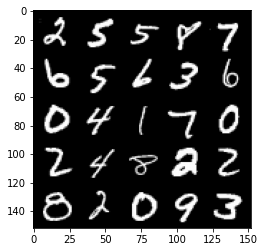

Step 17000: gen_loss: 366.9222683906555, disc_loss: 13.071001373231411


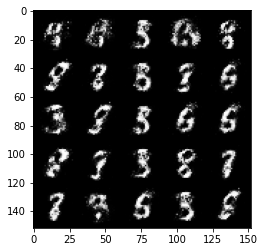

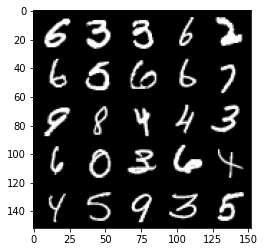

Step 17100: gen_loss: 368.31201934814453, disc_loss: 13.243463076651096


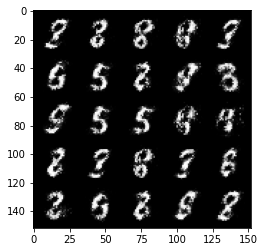

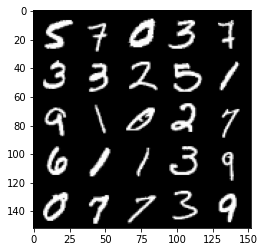

Step 17200: gen_loss: 354.98731684684753, disc_loss: 11.988939363509417


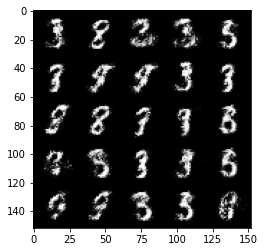

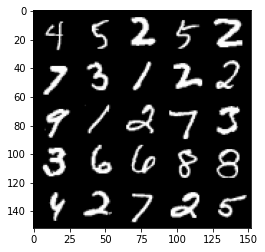

Step 17300: gen_loss: 365.4894618988037, disc_loss: 11.648943483829498


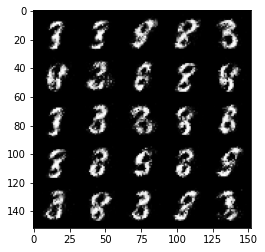

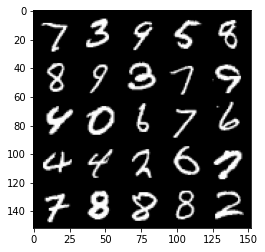

Step 17400: gen_loss: 371.36248326301575, disc_loss: 11.374955542385578


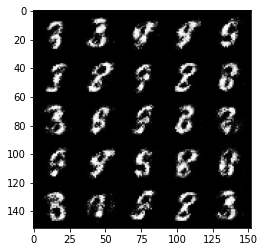

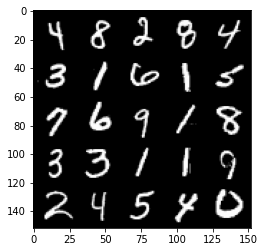

Step 17500: gen_loss: 361.6220908164978, disc_loss: 12.538230504840612


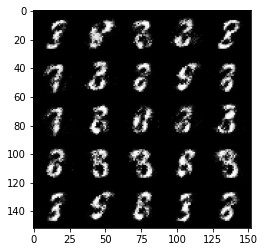

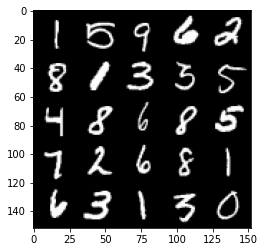

Step 17600: gen_loss: 358.1490833759308, disc_loss: 12.168023191392422


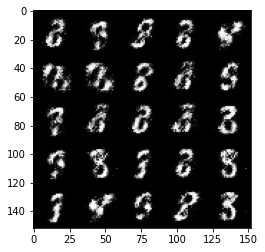

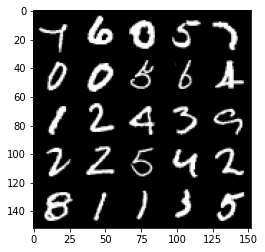

Step 17700: gen_loss: 354.80632066726685, disc_loss: 13.242003850638866


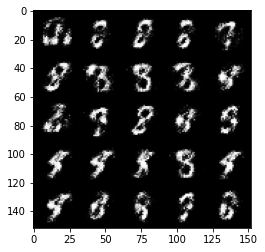

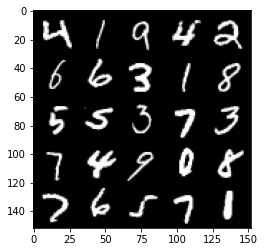

Step 17800: gen_loss: 352.1624035835266, disc_loss: 13.75892984867096


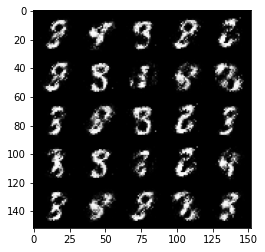

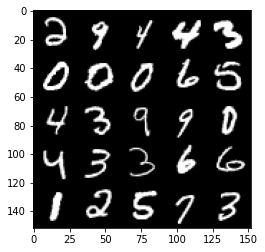

Step 17900: gen_loss: 361.5840702056885, disc_loss: 11.56099110096693


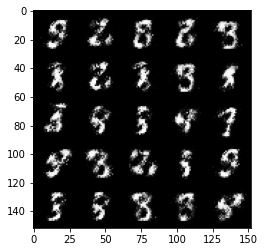

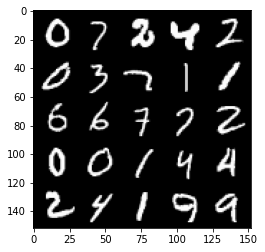

Step 18000: gen_loss: 359.2435894012451, disc_loss: 11.788677275180817


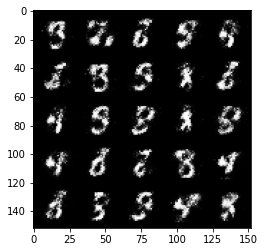

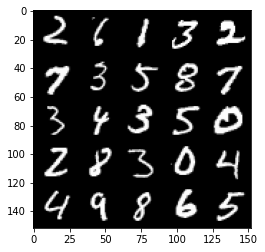

Step 18100: gen_loss: 367.78837180137634, disc_loss: 10.795429289340973


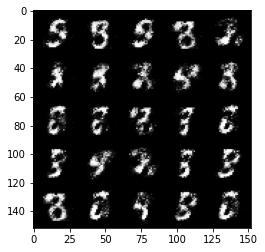

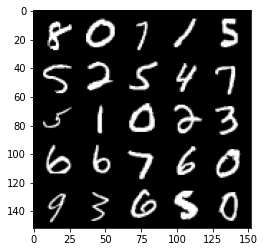

Step 18200: gen_loss: 365.0175836086273, disc_loss: 11.009535662829876


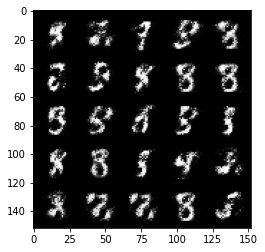

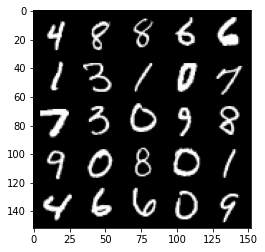

Step 18300: gen_loss: 366.5103726387024, disc_loss: 11.046698614954948


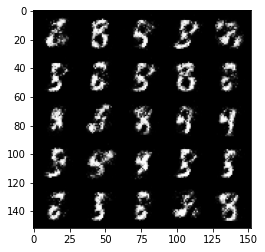

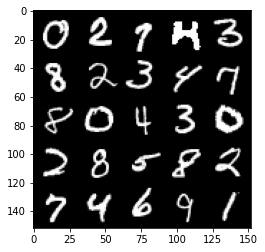

Step 18400: gen_loss: 382.7568860054016, disc_loss: 10.47925566136837


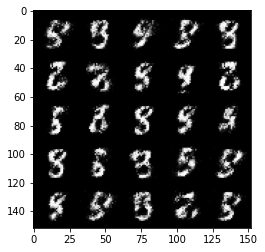

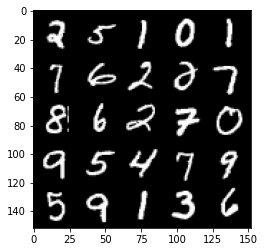

Step 18500: gen_loss: 383.45378160476685, disc_loss: 10.847429148852825


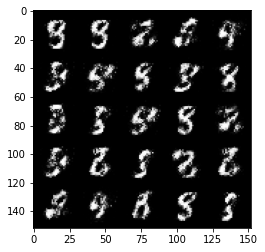

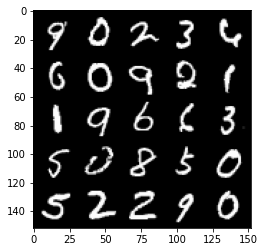

Step 18600: gen_loss: 378.0049877166748, disc_loss: 12.213960871100426


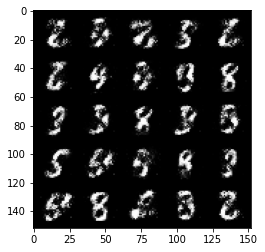

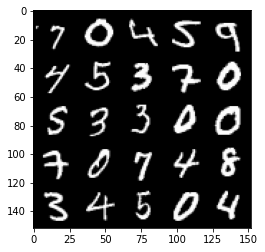

Step 18700: gen_loss: 360.79012799263, disc_loss: 13.237450912594795


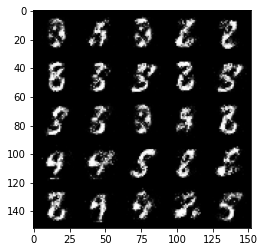

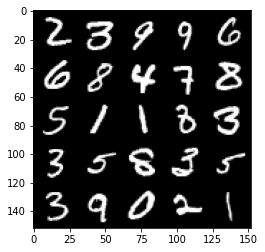

Step 18800: gen_loss: 354.5256724357605, disc_loss: 13.280215121805668


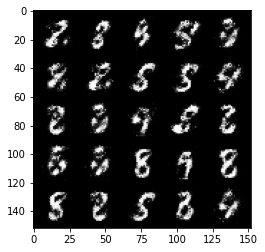

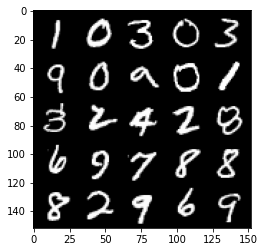

Step 18900: gen_loss: 356.35381722450256, disc_loss: 12.66701816022396


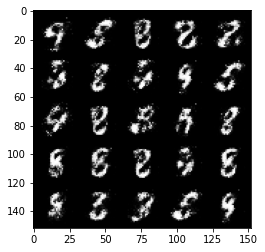

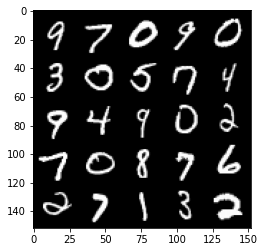

Step 19000: gen_loss: 352.6760833263397, disc_loss: 12.274474740028381


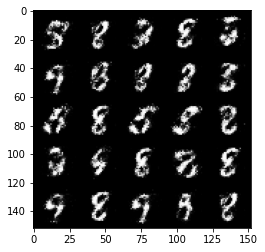

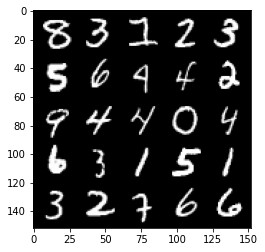

Step 19100: gen_loss: 348.2889013290405, disc_loss: 14.238856054842472


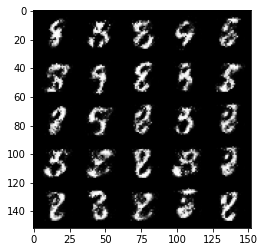

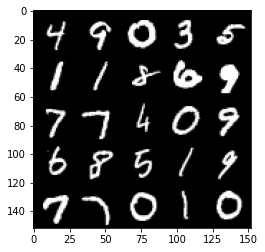

Step 19200: gen_loss: 333.5490553379059, disc_loss: 14.988798022270203


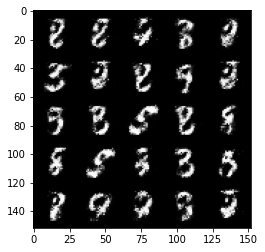

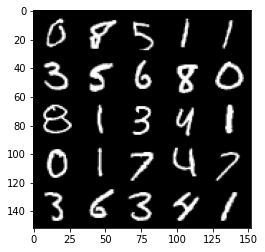

Step 19300: gen_loss: 319.83931064605713, disc_loss: 14.05576042085886


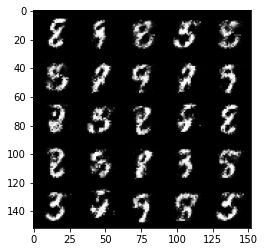

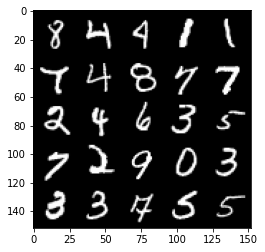

Step 19400: gen_loss: 326.6067621707916, disc_loss: 12.789491645991802


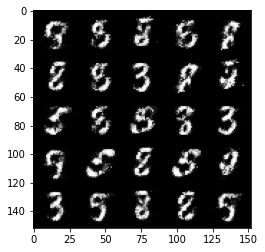

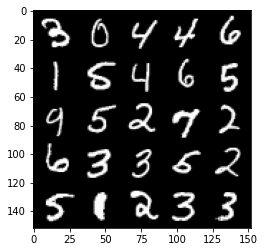

Step 19500: gen_loss: 332.64721751213074, disc_loss: 13.663401670753956


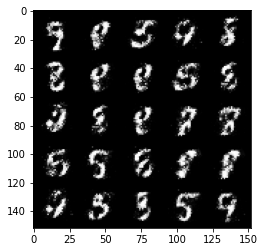

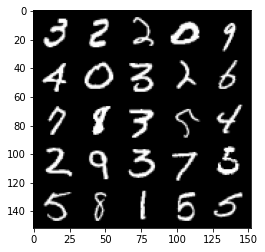

Step 19600: gen_loss: 329.0876133441925, disc_loss: 14.362909331917763


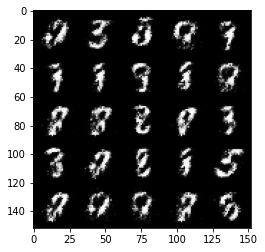

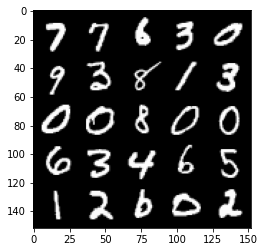

Step 19700: gen_loss: 327.6544380187988, disc_loss: 14.341537661850452


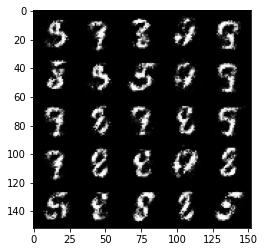

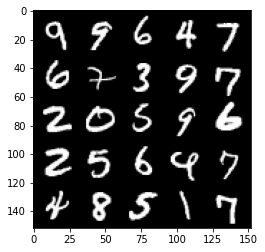

Step 19800: gen_loss: 335.6720275878906, disc_loss: 13.550128147006035


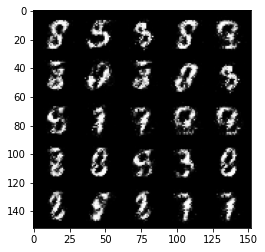

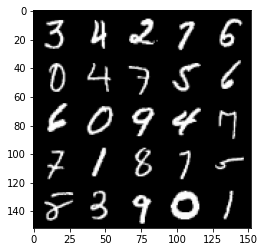

Step 19900: gen_loss: 350.40688490867615, disc_loss: 12.304351538419724


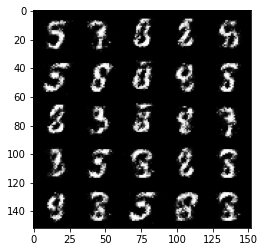

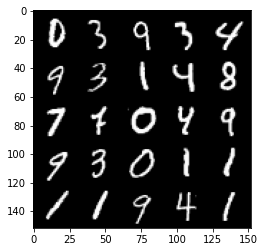

Step 20000: gen_loss: 345.2088921070099, disc_loss: 13.675678670406342


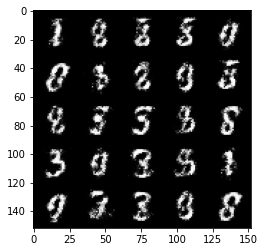

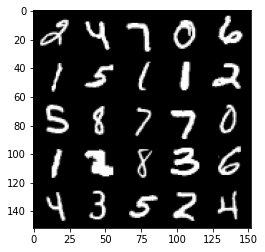

Step 20100: gen_loss: 326.6129484176636, disc_loss: 16.833377555012703


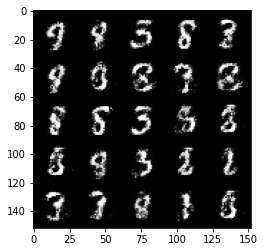

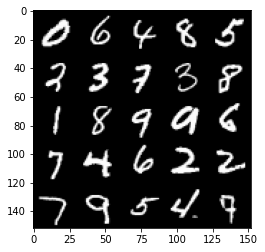

Step 20200: gen_loss: 325.81520342826843, disc_loss: 15.405750848352909


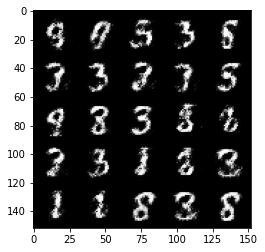

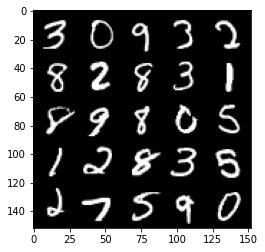

Step 20300: gen_loss: 332.84775948524475, disc_loss: 15.020376607775688


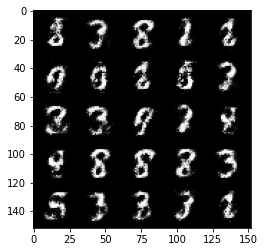

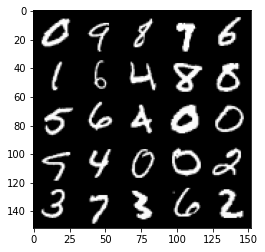

Step 20400: gen_loss: 327.6270663738251, disc_loss: 14.858903668820858


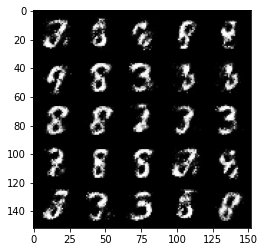

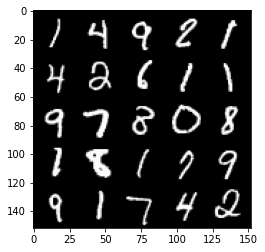

Step 20500: gen_loss: 329.6734969615936, disc_loss: 13.808487139642239


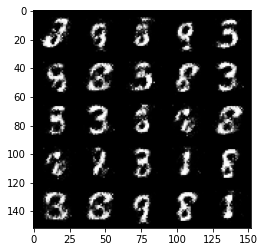

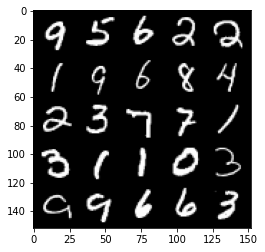

Step 20600: gen_loss: 341.00673270225525, disc_loss: 13.848195552825928


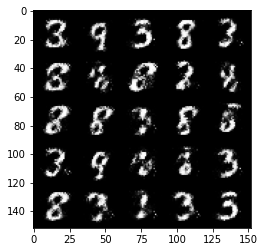

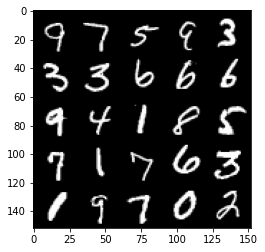

Step 20700: gen_loss: 338.40954756736755, disc_loss: 13.732290968298912


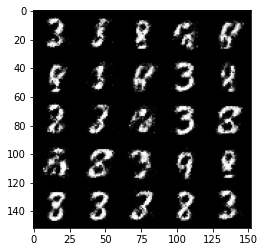

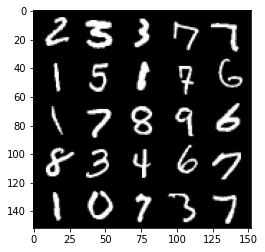

Step 20800: gen_loss: 321.73902130126953, disc_loss: 15.401351302862167


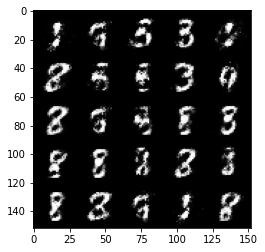

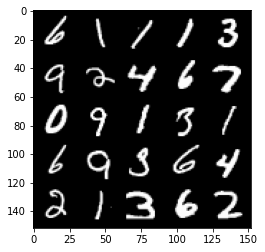

Step 20900: gen_loss: 324.8948321342468, disc_loss: 14.968028292059898


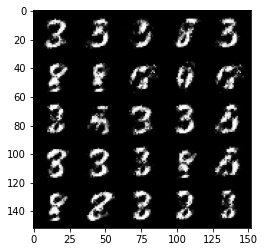

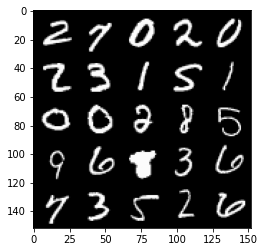

Step 21000: gen_loss: 316.3771216869354, disc_loss: 15.49015886336565


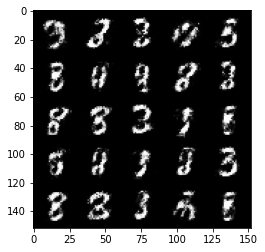

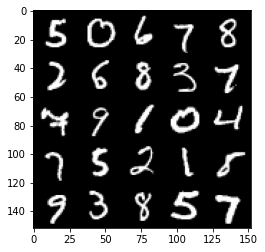

Step 21100: gen_loss: 323.33090710639954, disc_loss: 15.202796384692192


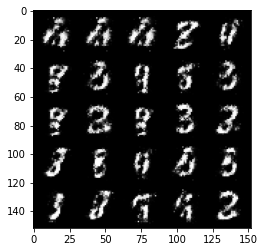

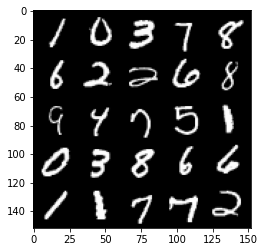

Step 21200: gen_loss: 341.87723207473755, disc_loss: 13.436231106519699


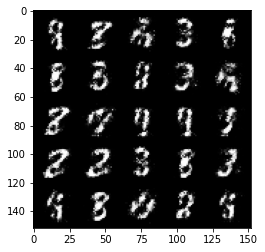

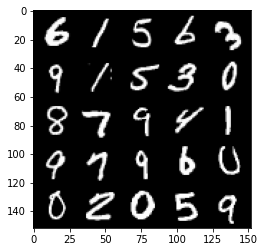

Step 21300: gen_loss: 347.0869002342224, disc_loss: 13.210935473442078


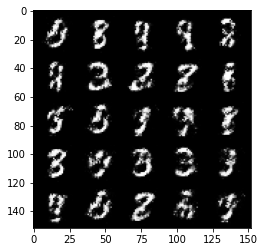

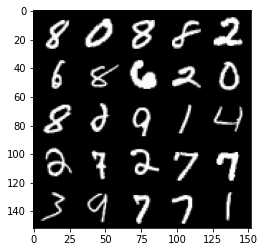

Step 21400: gen_loss: 336.40169167518616, disc_loss: 13.95970169454813


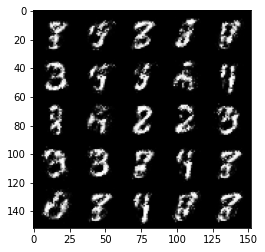

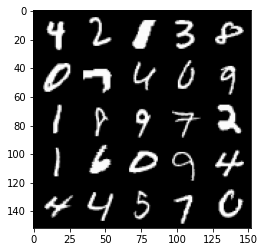

Step 21500: gen_loss: 326.927533864975, disc_loss: 14.056022785604


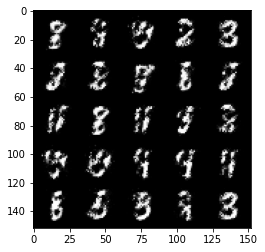

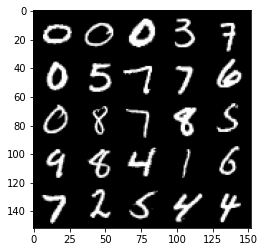

Step 21600: gen_loss: 331.17621207237244, disc_loss: 16.053216636180878


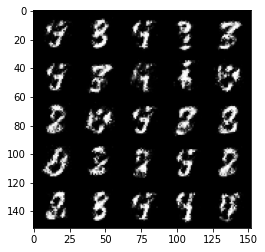

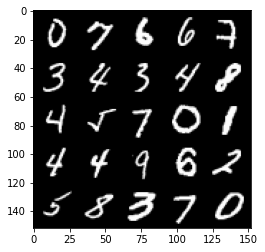

Step 21700: gen_loss: 334.24727606773376, disc_loss: 15.354253582656384


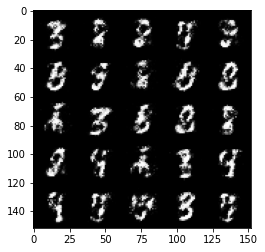

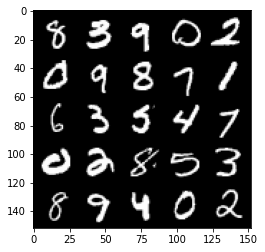

Step 21800: gen_loss: 335.9387831687927, disc_loss: 13.995967879891396


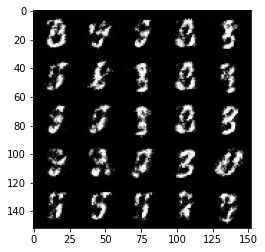

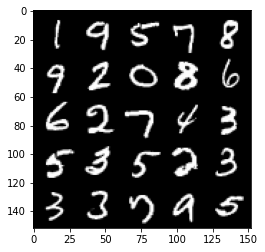

Step 21900: gen_loss: 330.02393078804016, disc_loss: 15.093521438539028


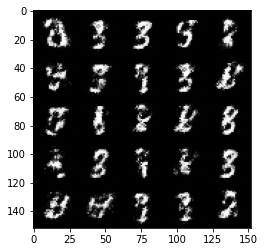

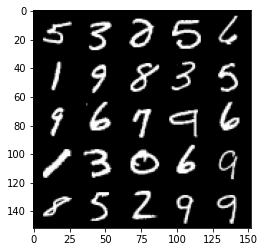

Step 22000: gen_loss: 317.670113325119, disc_loss: 15.621405847370625


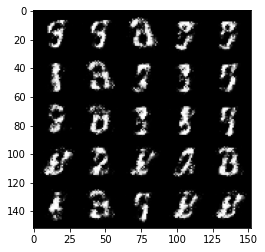

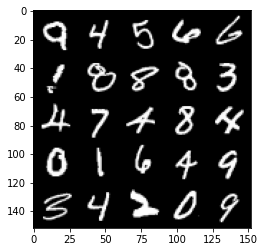

Step 22100: gen_loss: 329.93725061416626, disc_loss: 13.723789915442467


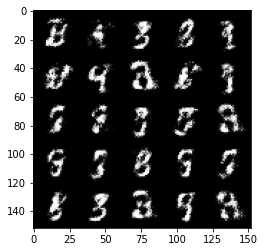

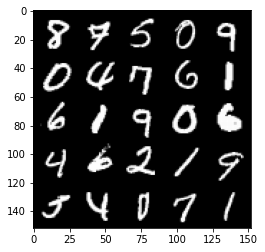

Step 22200: gen_loss: 335.943959236145, disc_loss: 14.1255953758955


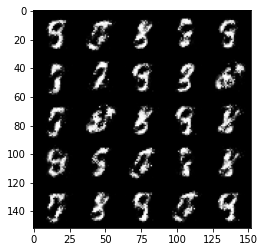

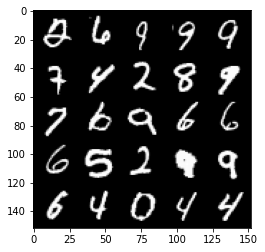

Step 22300: gen_loss: 322.19082951545715, disc_loss: 15.335649110376835


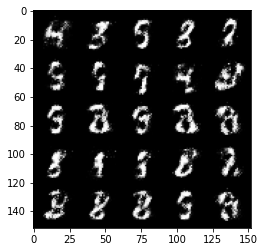

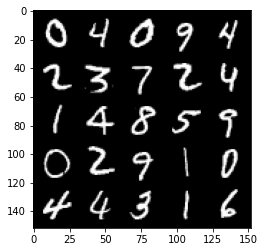

Step 22400: gen_loss: 327.96680665016174, disc_loss: 15.990428730845451


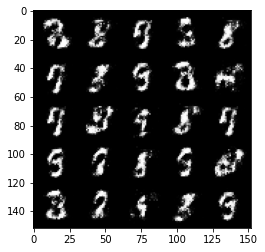

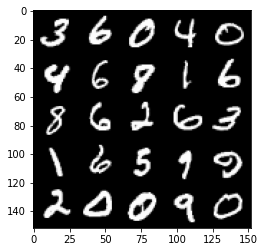

Step 22500: gen_loss: 328.73100662231445, disc_loss: 17.01992131024599


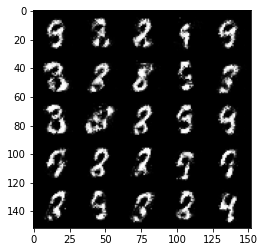

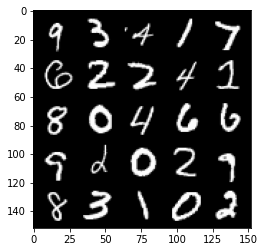

Step 22600: gen_loss: 317.3951575756073, disc_loss: 17.24134837836027


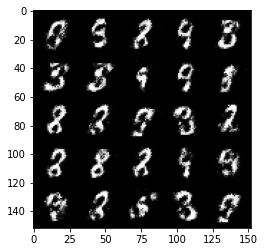

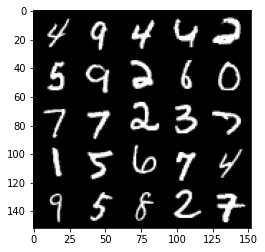

Step 22700: gen_loss: 307.150310754776, disc_loss: 18.258742779493332


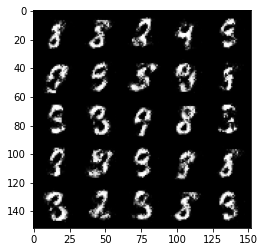

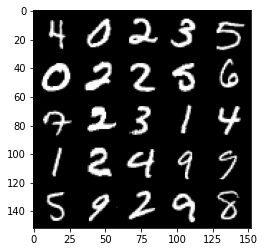

Step 22800: gen_loss: 301.97404313087463, disc_loss: 17.693725161254406


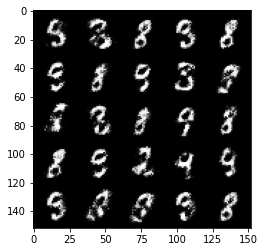

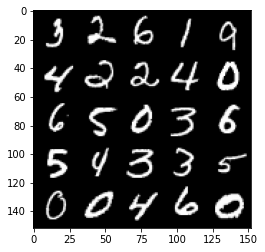

Step 22900: gen_loss: 305.71429204940796, disc_loss: 16.493934772908688


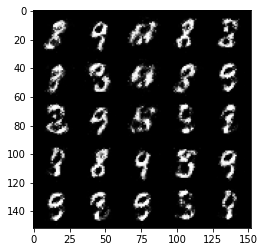

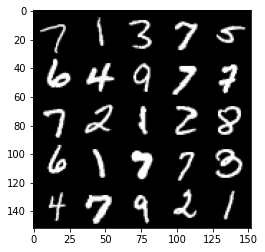

Step 23000: gen_loss: 314.6179232597351, disc_loss: 16.58047641813755


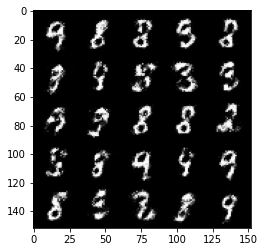

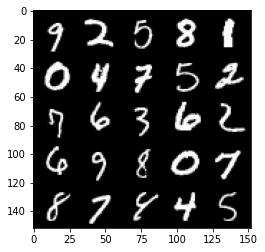

Step 23100: gen_loss: 320.24568486213684, disc_loss: 17.603507958352566


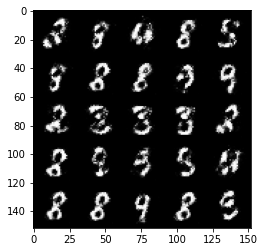

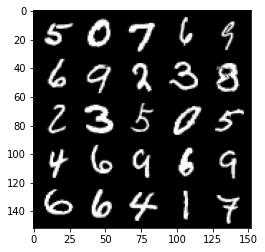

Step 23200: gen_loss: 312.0876543521881, disc_loss: 19.281256653368473


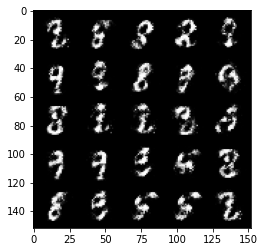

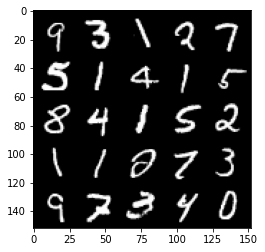

Step 23300: gen_loss: 307.00838255882263, disc_loss: 19.56815992295742


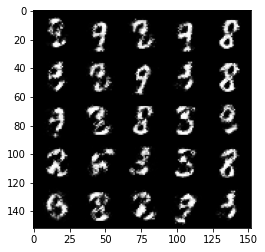

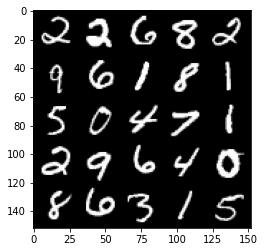

Step 23400: gen_loss: 297.52171635627747, disc_loss: 20.178412780165672


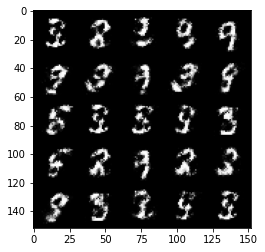

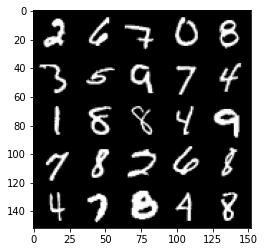

Step 23500: gen_loss: 284.13889145851135, disc_loss: 19.5450144931674


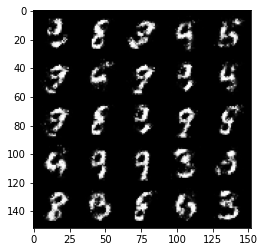

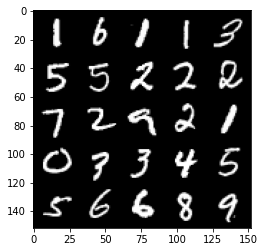

Step 23600: gen_loss: 293.2281849384308, disc_loss: 17.504660338163376


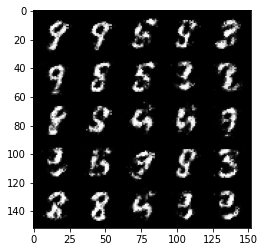

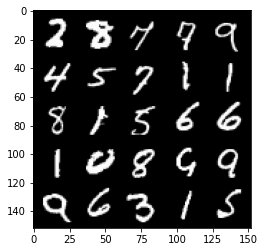

Step 23700: gen_loss: 305.30807614326477, disc_loss: 18.048377141356468


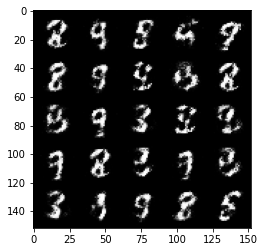

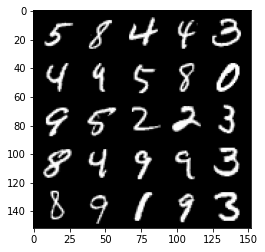

Step 23800: gen_loss: 305.8456439971924, disc_loss: 19.63428044319153


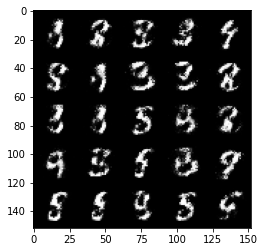

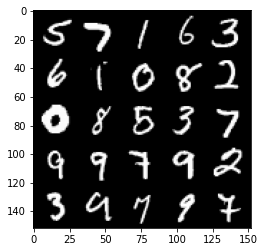

Step 23900: gen_loss: 289.37274408340454, disc_loss: 19.555688567459583


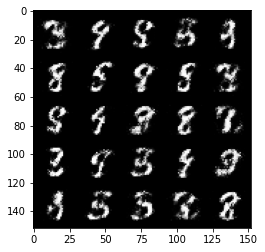

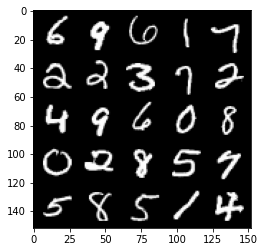

Step 24000: gen_loss: 284.09091997146606, disc_loss: 20.085740372538567


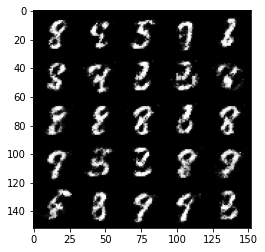

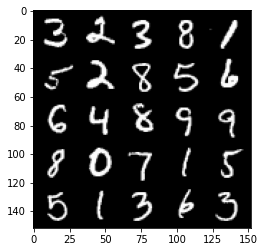

Step 24100: gen_loss: 284.5034785270691, disc_loss: 19.687024533748627


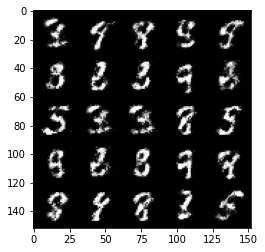

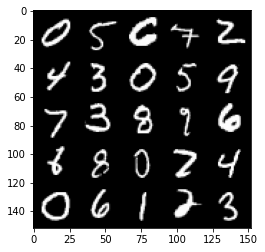

Step 24200: gen_loss: 275.8025929927826, disc_loss: 20.8362555205822


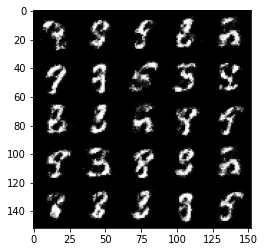

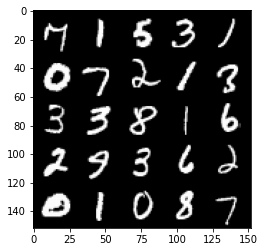

Step 24300: gen_loss: 282.7747459411621, disc_loss: 19.13979260623455


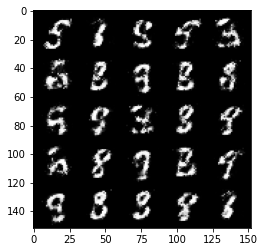

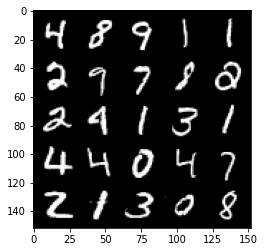

Step 24400: gen_loss: 285.4645586013794, disc_loss: 18.022590674459934


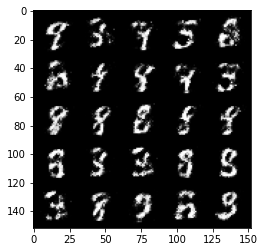

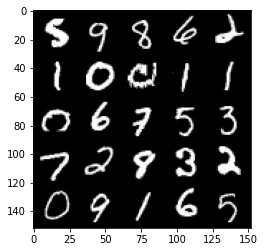

Step 24500: gen_loss: 280.4361562728882, disc_loss: 20.037128500640392


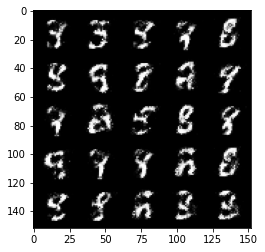

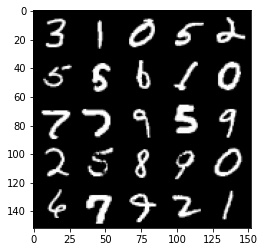

Step 24600: gen_loss: 290.75305557250977, disc_loss: 18.532402232289314


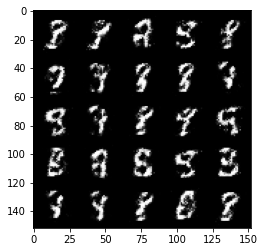

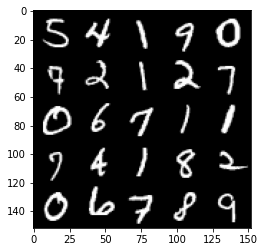

Step 24700: gen_loss: 286.6752235889435, disc_loss: 18.5761109739542


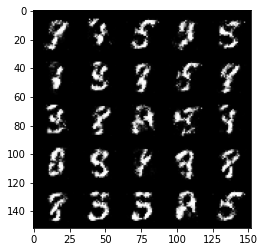

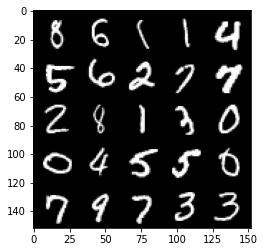

Step 24800: gen_loss: 282.85179829597473, disc_loss: 19.37023565173149


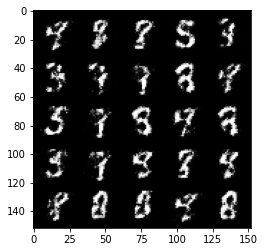

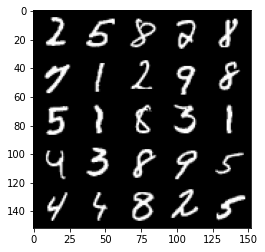

Step 24900: gen_loss: 286.2435004711151, disc_loss: 17.82409179955721


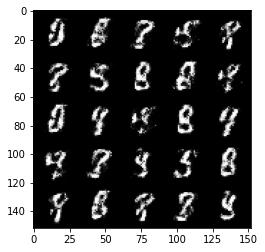

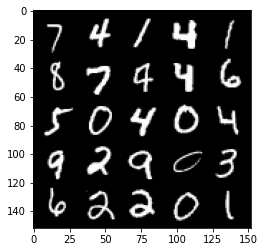

Step 25000: gen_loss: 287.8267617225647, disc_loss: 16.63664823025465


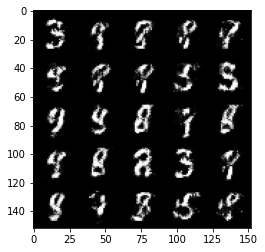

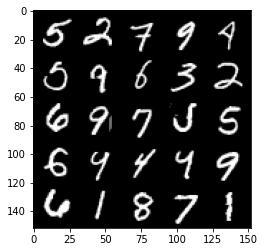

Step 25100: gen_loss: 277.53145956993103, disc_loss: 19.293397217988968


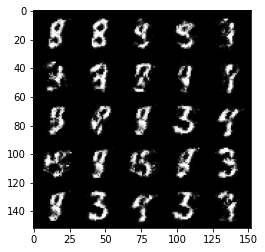

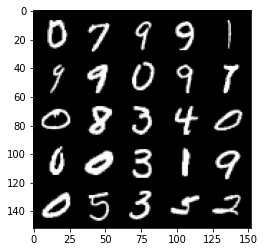

Step 25200: gen_loss: 276.20800590515137, disc_loss: 18.929863162338734


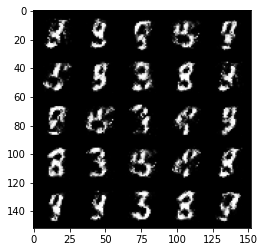

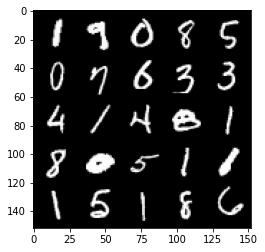

Step 25300: gen_loss: 285.8286609649658, disc_loss: 18.283801317214966


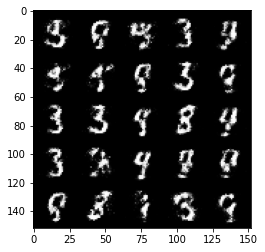

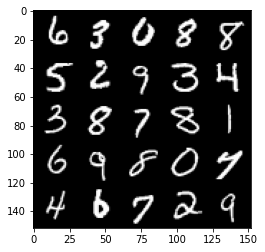

Step 25400: gen_loss: 282.43989181518555, disc_loss: 17.520242370665073


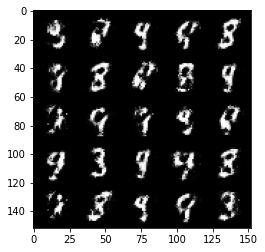

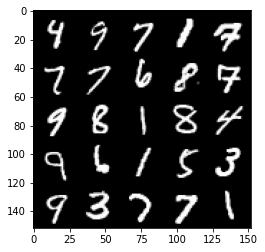

Step 25500: gen_loss: 280.15748405456543, disc_loss: 18.85528903454542


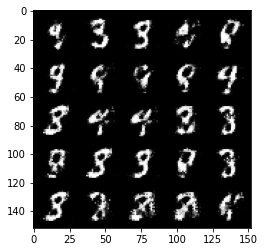

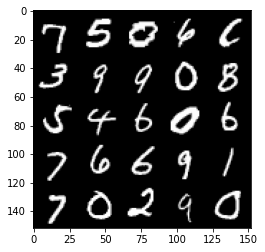

Step 25600: gen_loss: 292.94982528686523, disc_loss: 18.500743627548218


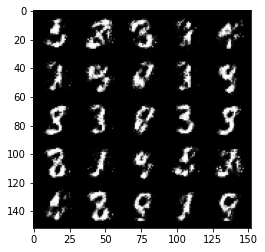

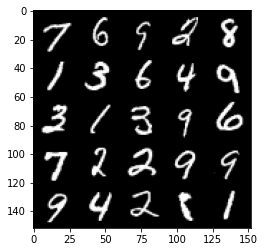

Step 25700: gen_loss: 291.5074145793915, disc_loss: 18.624082930386066


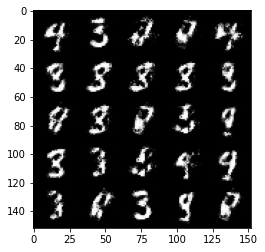

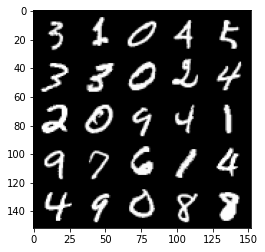

Step 25800: gen_loss: 287.9667580127716, disc_loss: 18.50365161150694


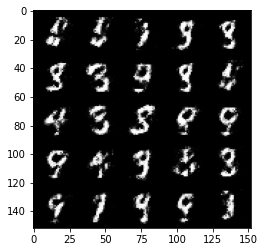

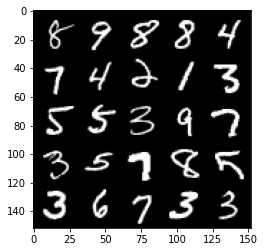

Step 25900: gen_loss: 296.0003173351288, disc_loss: 16.529654383659363


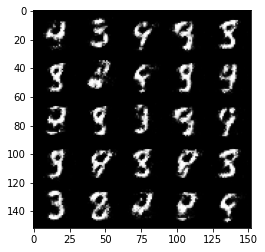

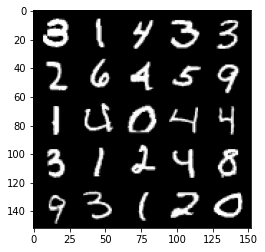

Step 26000: gen_loss: 289.7133877277374, disc_loss: 18.20188996195793


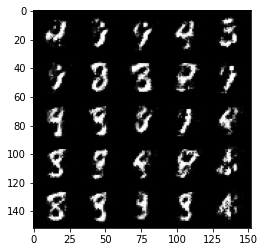

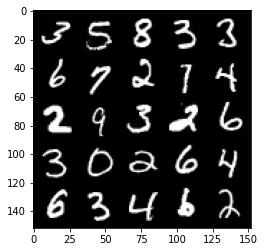

Step 26100: gen_loss: 302.56101655960083, disc_loss: 16.895907625555992


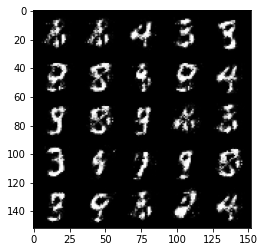

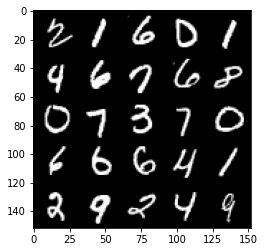

Step 26200: gen_loss: 300.6683132648468, disc_loss: 17.44396049529314


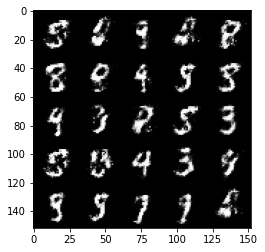

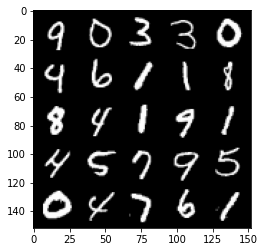

Step 26300: gen_loss: 298.1519122123718, disc_loss: 17.565361328423023


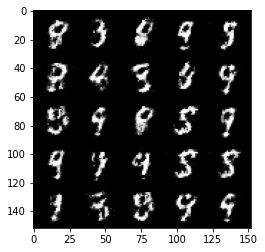

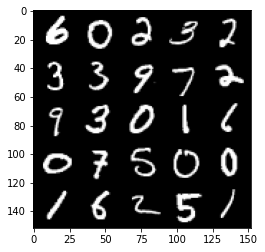

Step 26400: gen_loss: 302.9888699054718, disc_loss: 17.219565108418465


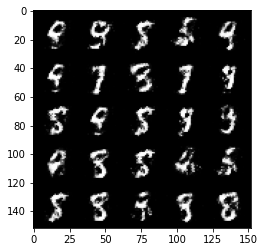

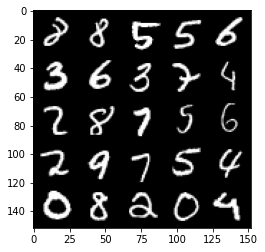

Step 26500: gen_loss: 294.52289032936096, disc_loss: 18.072719298303127


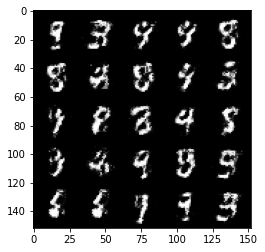

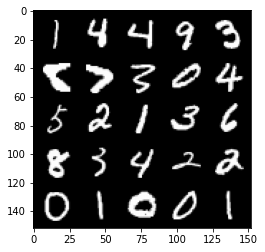

Step 26600: gen_loss: 287.0050575733185, disc_loss: 21.195231676101685


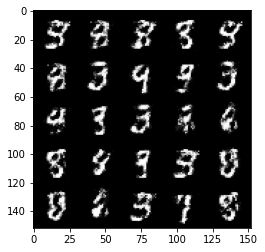

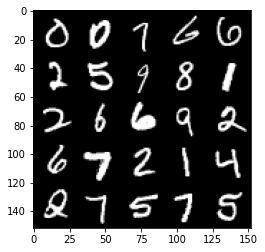

Step 26700: gen_loss: 275.730744600296, disc_loss: 21.760001450777054


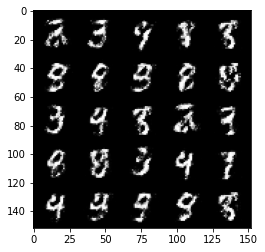

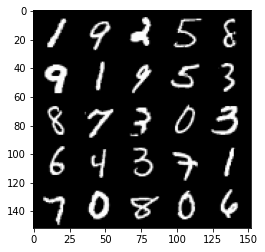

Step 26800: gen_loss: 272.4217975139618, disc_loss: 19.945573911070824


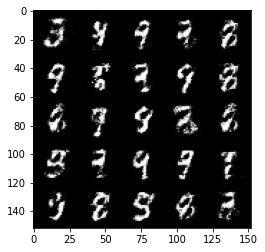

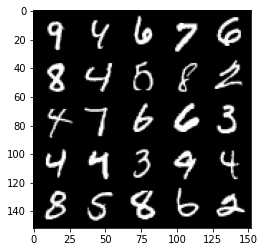

Step 26900: gen_loss: 277.80830574035645, disc_loss: 19.91101209819317


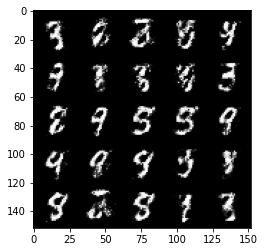

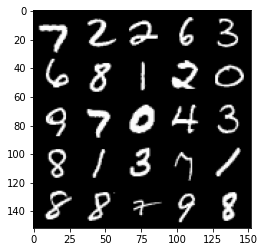

Step 27000: gen_loss: 278.9214997291565, disc_loss: 20.016768142580986


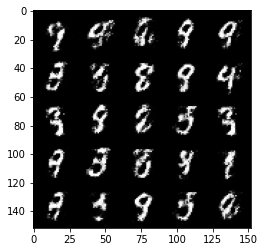

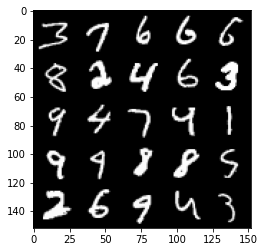

Step 27100: gen_loss: 272.86413526535034, disc_loss: 21.554467722773552


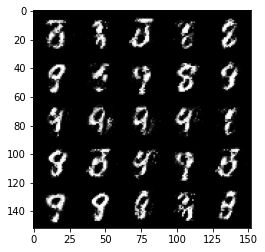

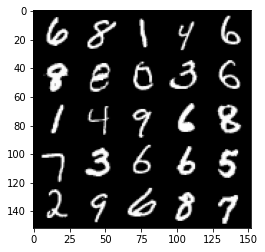

Step 27200: gen_loss: 270.87167167663574, disc_loss: 20.351022943854332


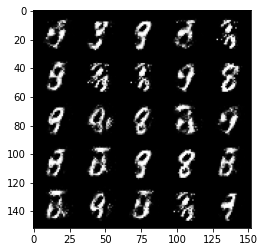

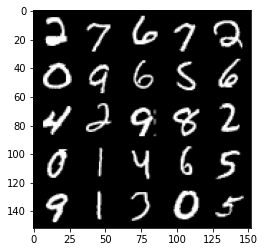

Step 27300: gen_loss: 276.19806718826294, disc_loss: 19.97808288037777


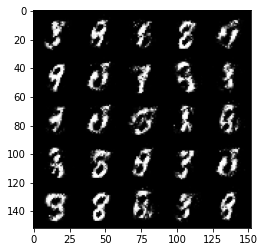

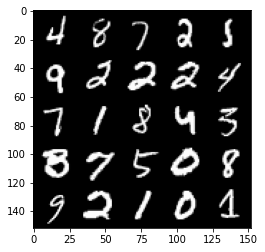

Step 27400: gen_loss: 278.92644453048706, disc_loss: 19.661674581468105


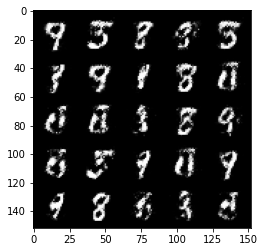

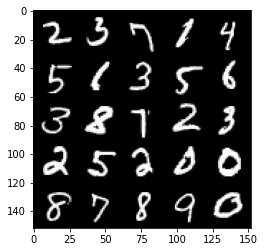

Step 27500: gen_loss: 272.8259835243225, disc_loss: 20.0526065826416


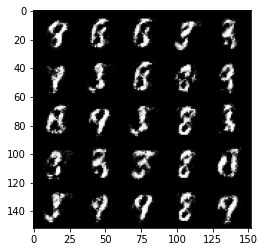

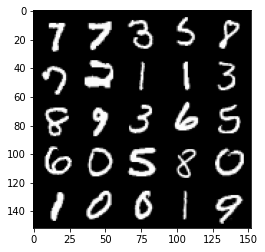

Step 27600: gen_loss: 269.4701421260834, disc_loss: 21.367030046880245


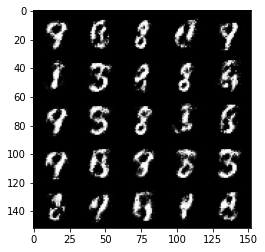

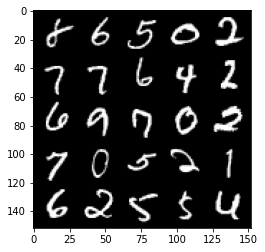

Step 27700: gen_loss: 268.58973002433777, disc_loss: 21.165603831410408


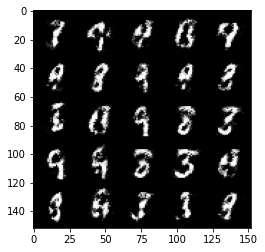

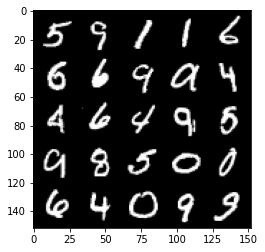

Step 27800: gen_loss: 274.5458731651306, disc_loss: 20.125989258289337


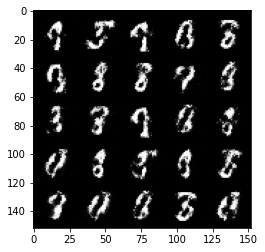

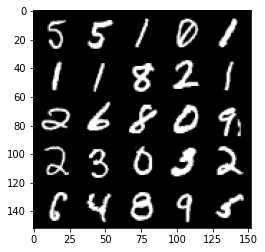

Step 27900: gen_loss: 269.917813539505, disc_loss: 19.37635199725628


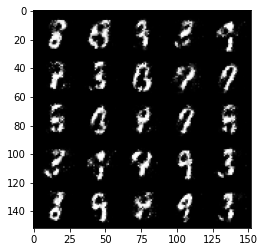

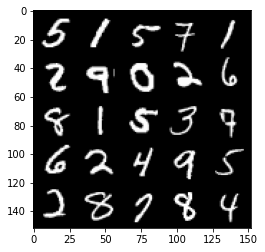

Step 28000: gen_loss: 271.3599193096161, disc_loss: 20.00051551312208


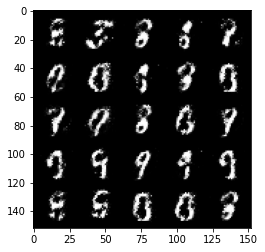

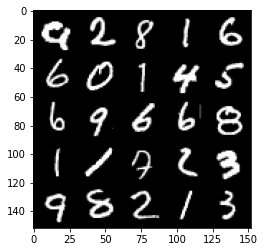

Step 28100: gen_loss: 282.7284080982208, disc_loss: 18.766562066972256


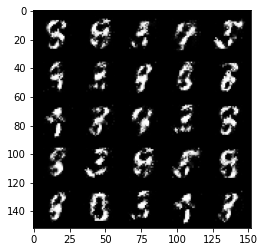

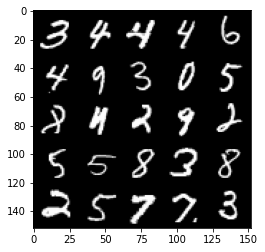

Step 28200: gen_loss: 292.01604080200195, disc_loss: 16.252827294170856


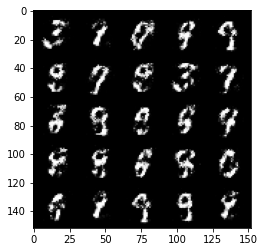

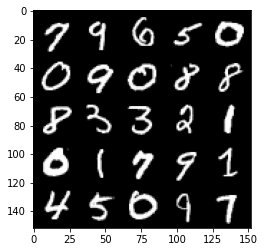

Step 28300: gen_loss: 292.1053478717804, disc_loss: 17.25519373267889


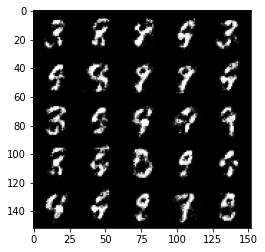

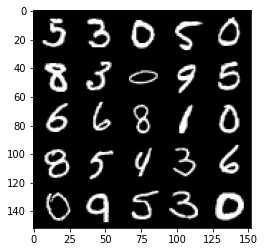

Step 28400: gen_loss: 278.79352283477783, disc_loss: 19.51741150021553


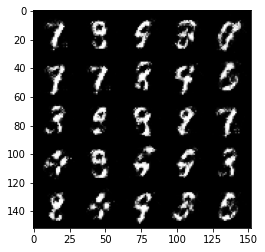

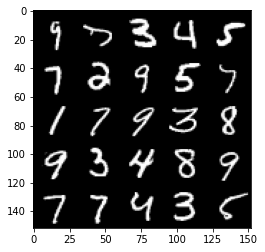

Step 28500: gen_loss: 283.10766887664795, disc_loss: 19.62338274717331


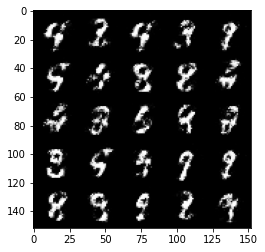

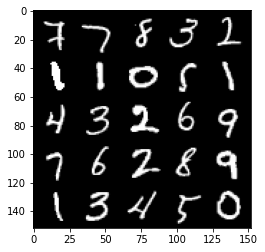

Step 28600: gen_loss: 283.3961012363434, disc_loss: 18.719354942440987


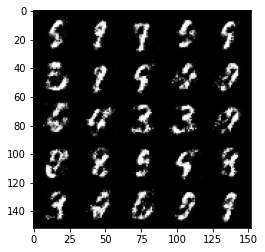

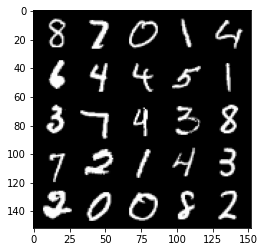

Step 28700: gen_loss: 291.05052185058594, disc_loss: 17.262742824852467


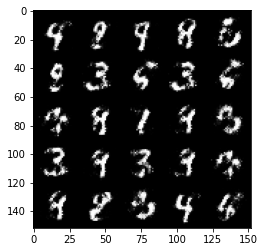

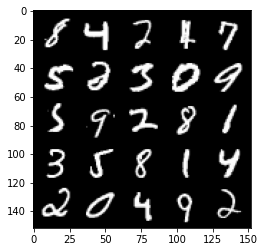

Step 28800: gen_loss: 287.8969957828522, disc_loss: 18.209320940077305


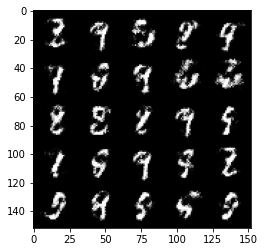

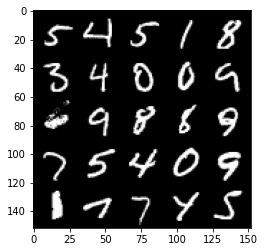

Step 28900: gen_loss: 284.64965891838074, disc_loss: 20.480508029460907


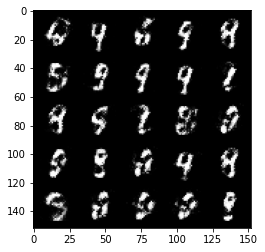

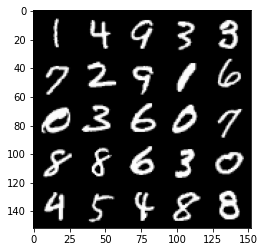

Step 29000: gen_loss: 293.53129720687866, disc_loss: 18.72271452099085


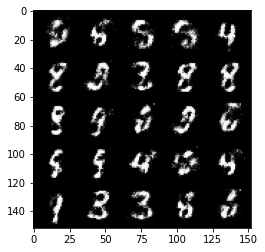

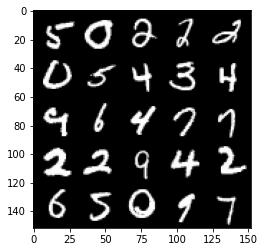

Step 29100: gen_loss: 286.76809573173523, disc_loss: 19.33367568254471


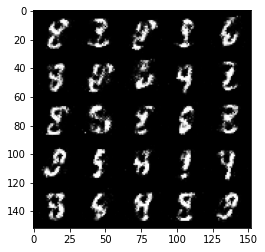

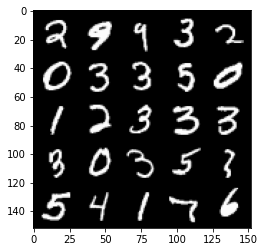

Step 29200: gen_loss: 267.2857573032379, disc_loss: 22.451602026820183


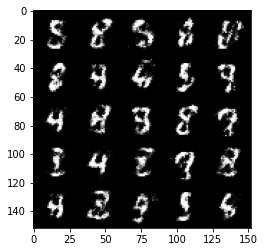

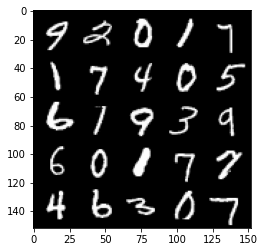

Step 29300: gen_loss: 256.16107630729675, disc_loss: 24.415227010846138


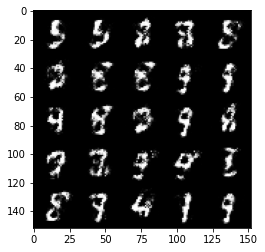

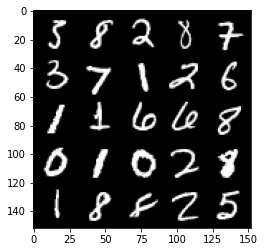

Step 29400: gen_loss: 253.0322105884552, disc_loss: 22.329861417412758


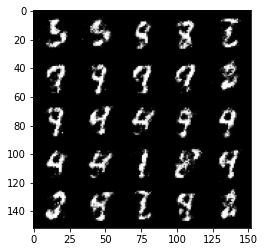

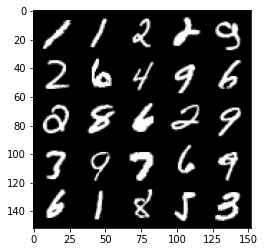

Step 29500: gen_loss: 266.01157116889954, disc_loss: 20.682714477181435


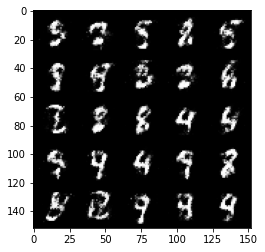

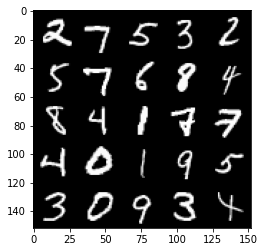

Step 29600: gen_loss: 271.6436643600464, disc_loss: 19.432987451553345


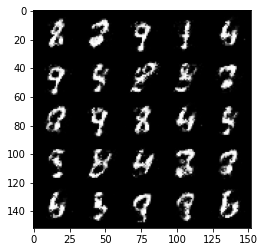

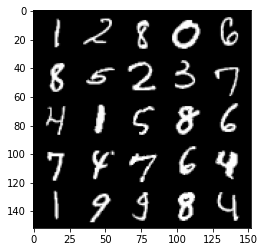

Step 29700: gen_loss: 273.44229459762573, disc_loss: 19.070321276783943


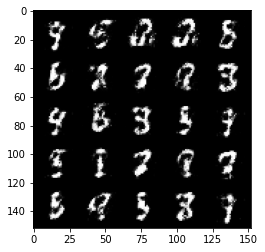

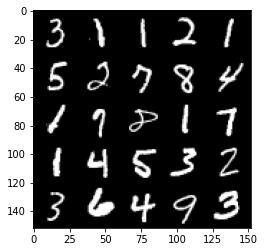

Step 29800: gen_loss: 281.47565627098083, disc_loss: 19.75111823529005


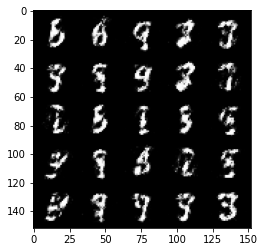

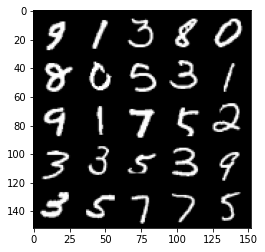

Step 29900: gen_loss: 281.87178564071655, disc_loss: 17.955499455332756


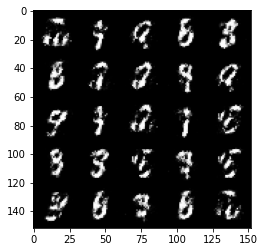

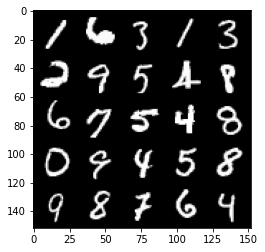

Step 30000: gen_loss: 290.59886598587036, disc_loss: 17.30613136291504


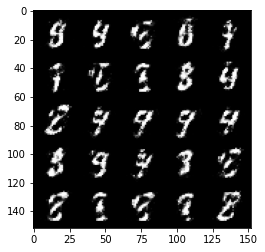

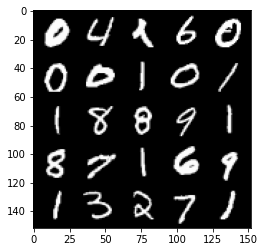

Step 30100: gen_loss: 289.9477322101593, disc_loss: 17.683007590472698


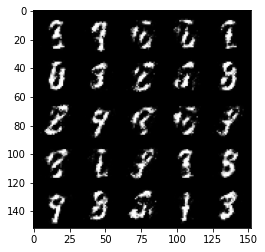

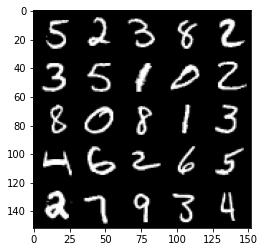

Step 30200: gen_loss: 279.10084080696106, disc_loss: 18.928115978837013


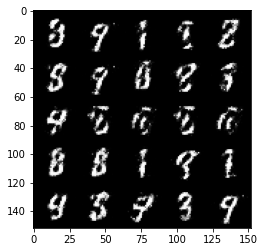

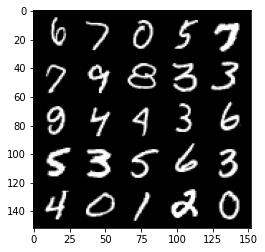

Step 30300: gen_loss: 277.5815737247467, disc_loss: 20.754082590341568


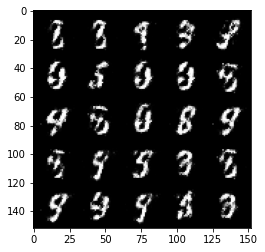

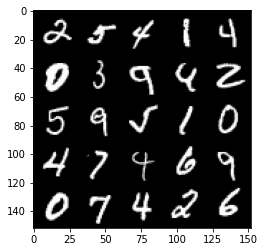

Step 30400: gen_loss: 284.9976284503937, disc_loss: 18.754458256065845


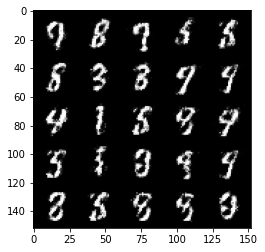

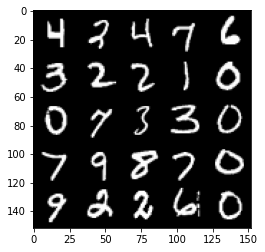

Step 30500: gen_loss: 276.1823706626892, disc_loss: 19.917650029063225


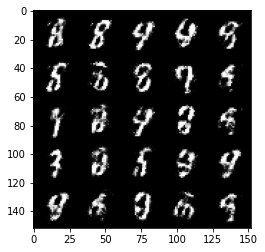

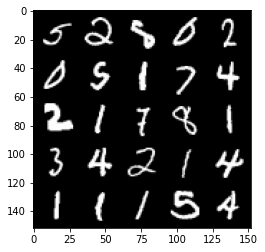

Step 30600: gen_loss: 264.84329891204834, disc_loss: 22.751738265156746


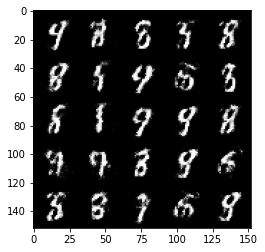

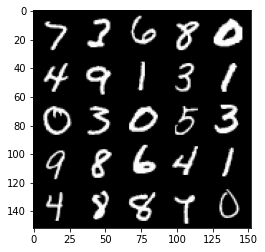

Step 30700: gen_loss: 253.7316107749939, disc_loss: 24.813636228442192


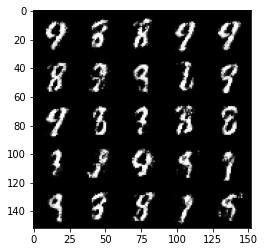

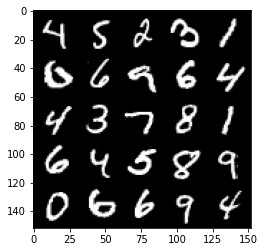

Step 30800: gen_loss: 250.51531529426575, disc_loss: 21.73915708065033


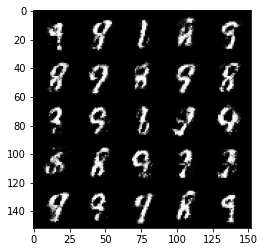

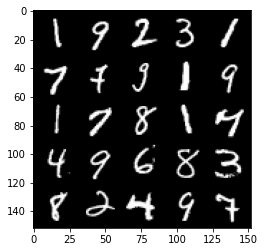

Step 30900: gen_loss: 252.31997394561768, disc_loss: 22.444007247686386


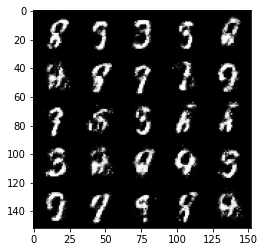

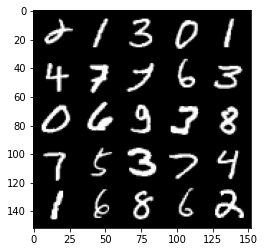

Step 31000: gen_loss: 250.8059277534485, disc_loss: 22.36972412467003


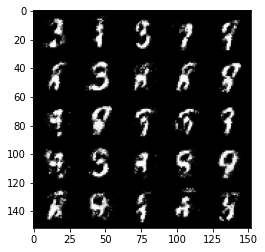

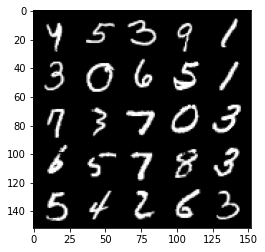

Step 31100: gen_loss: 246.12295365333557, disc_loss: 24.80940355360508


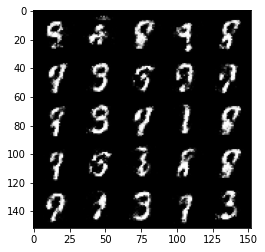

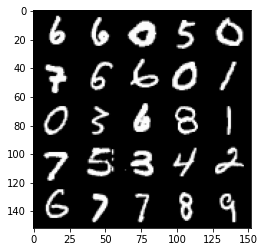

Step 31200: gen_loss: 249.2270917892456, disc_loss: 22.567838728427887


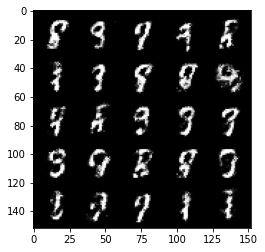

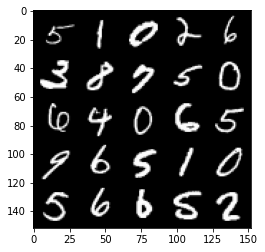

Step 31300: gen_loss: 258.81379985809326, disc_loss: 21.717182978987694


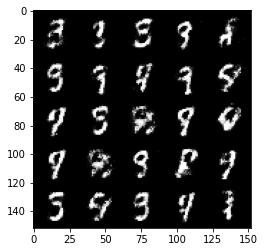

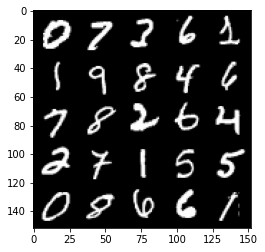

Step 31400: gen_loss: 258.7565746307373, disc_loss: 22.358030781149864


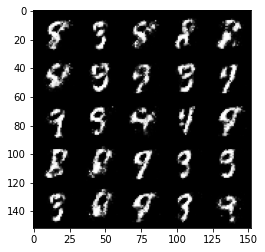

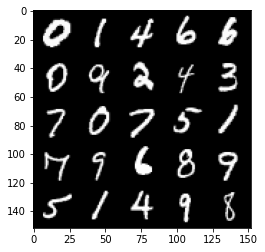

Step 31500: gen_loss: 252.82336282730103, disc_loss: 24.185578614473343


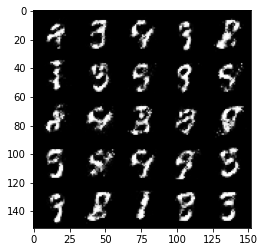

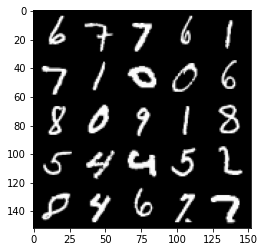

Step 31600: gen_loss: 252.512038230896, disc_loss: 25.1367284655571


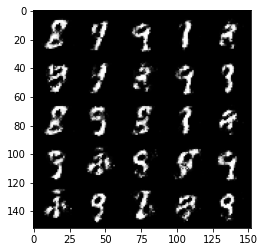

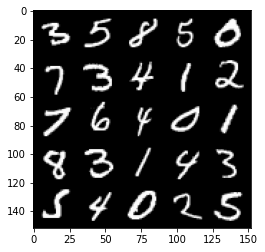

Step 31700: gen_loss: 253.72235584259033, disc_loss: 23.781867519021034


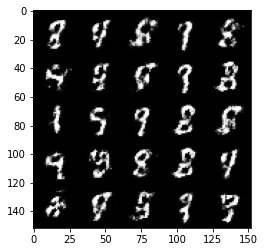

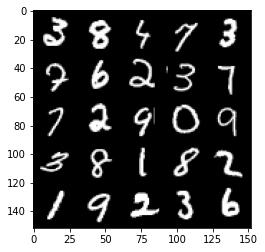

Step 31800: gen_loss: 259.044730424881, disc_loss: 22.547105938196182


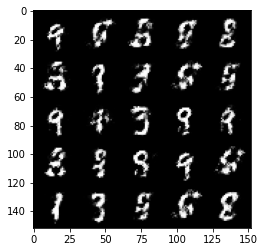

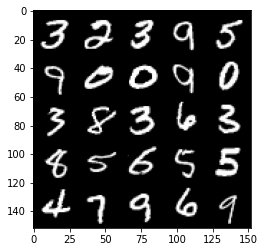

Step 31900: gen_loss: 250.0753619670868, disc_loss: 25.44733054935932


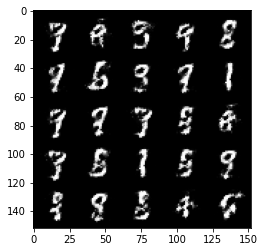

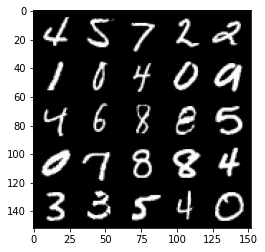

Step 32000: gen_loss: 238.09748673439026, disc_loss: 27.58022364974022


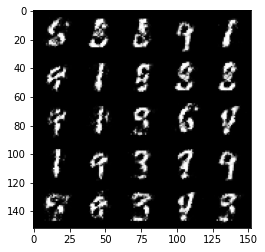

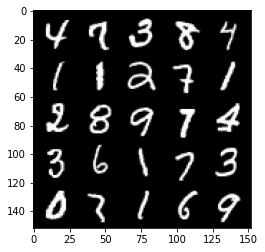

Step 32100: gen_loss: 238.41797256469727, disc_loss: 24.228368312120438


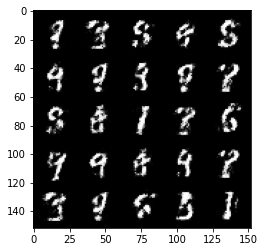

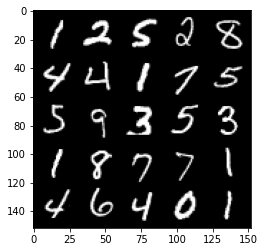

Step 32200: gen_loss: 253.01123309135437, disc_loss: 22.05549943447113


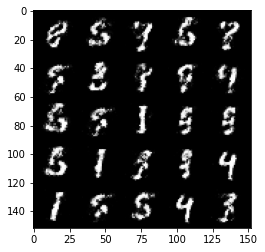

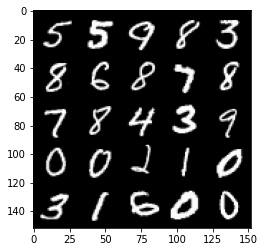

Step 32300: gen_loss: 251.1328797340393, disc_loss: 23.408400297164917


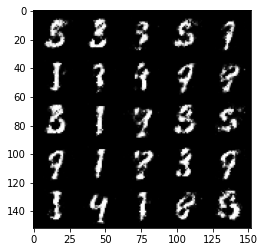

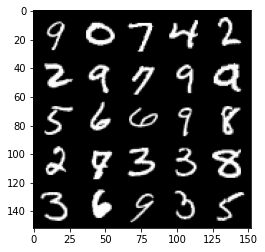

Step 32400: gen_loss: 241.27717351913452, disc_loss: 23.986215114593506


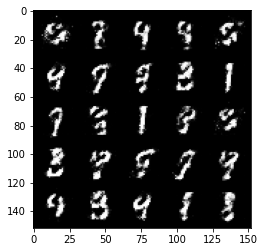

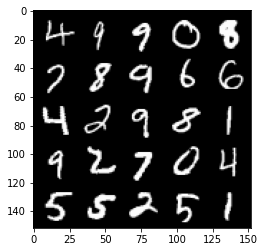

Step 32500: gen_loss: 240.64526343345642, disc_loss: 22.166309639811516


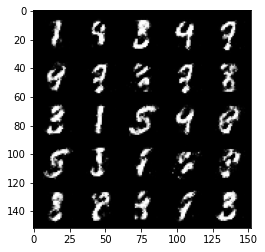

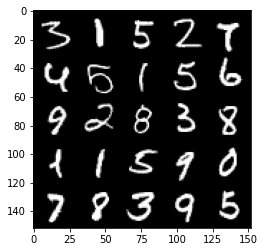

Step 32600: gen_loss: 250.06573939323425, disc_loss: 22.350346818566322


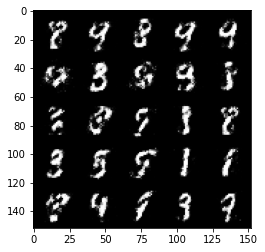

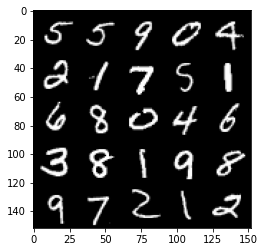

Step 32700: gen_loss: 244.76313281059265, disc_loss: 24.32917082309723


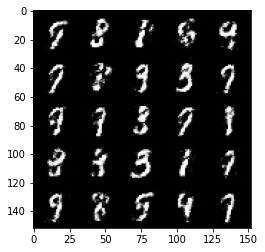

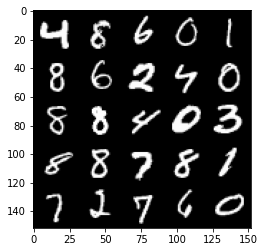

Step 32800: gen_loss: 247.6739547252655, disc_loss: 23.181274875998497


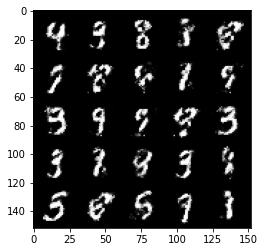

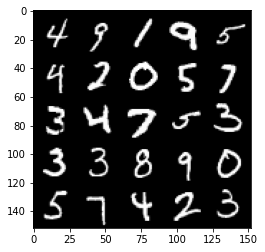

Step 32900: gen_loss: 247.23971581459045, disc_loss: 22.8045491874218


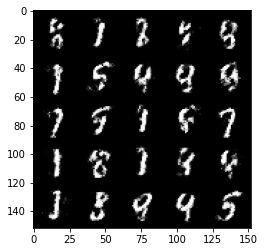

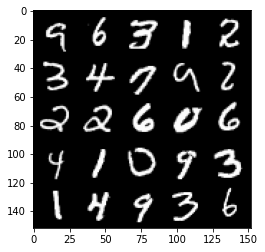

Step 33000: gen_loss: 243.76954293251038, disc_loss: 24.334992721676826


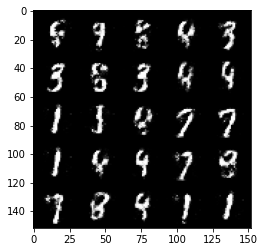

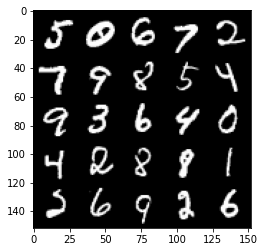

Step 33100: gen_loss: 243.67849278450012, disc_loss: 24.38375498354435


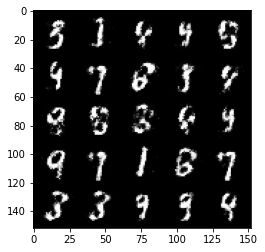

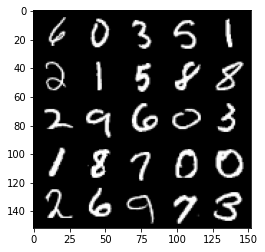

Step 33200: gen_loss: 244.26721715927124, disc_loss: 25.99428917467594


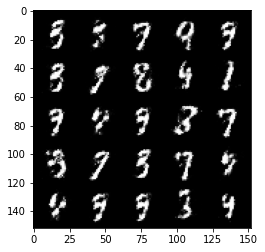

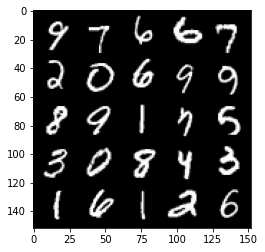

Step 33300: gen_loss: 235.9448926448822, disc_loss: 25.688128665089607


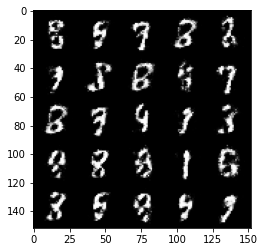

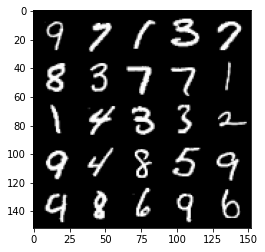

Step 33400: gen_loss: 232.694930434227, disc_loss: 25.080317199230194


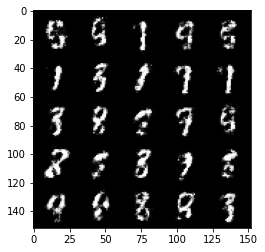

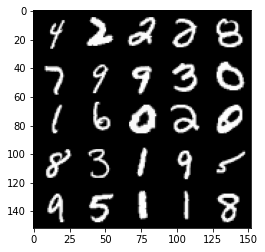

Step 33500: gen_loss: 230.1170847415924, disc_loss: 25.707949489355087


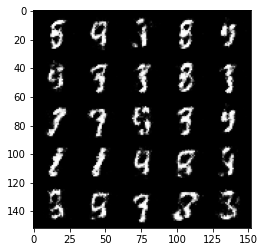

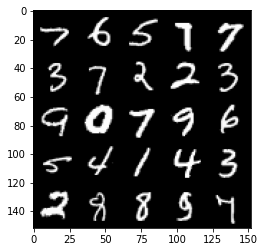

Step 33600: gen_loss: 232.5677354335785, disc_loss: 26.174297481775284


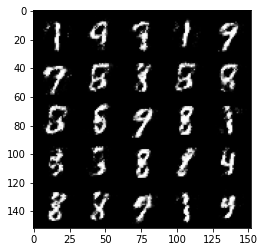

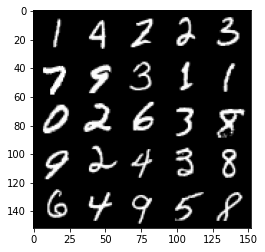

Step 33700: gen_loss: 236.71821320056915, disc_loss: 26.852272391319275


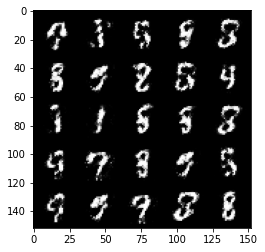

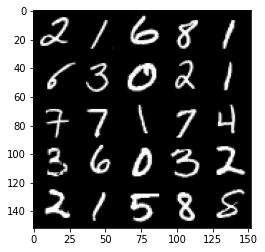

Step 33800: gen_loss: 240.37627172470093, disc_loss: 25.200516432523727


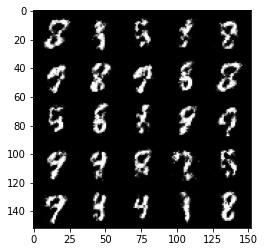

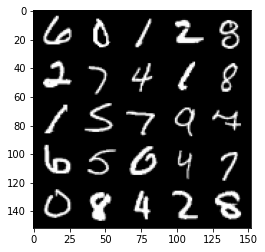

Step 33900: gen_loss: 236.15615057945251, disc_loss: 26.319113850593567


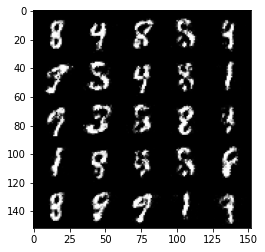

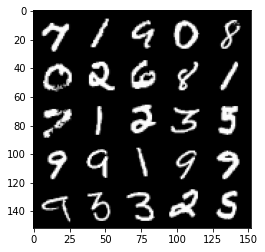

Step 34000: gen_loss: 227.76669704914093, disc_loss: 26.272129401564598


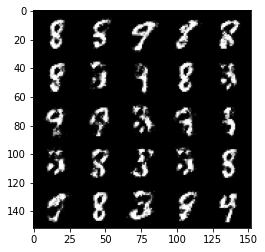

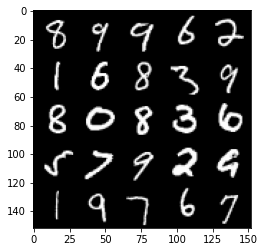

Step 34100: gen_loss: 232.8090535402298, disc_loss: 25.284762874245644


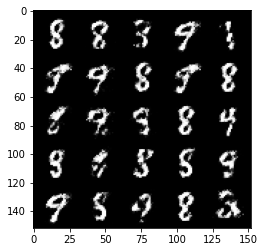

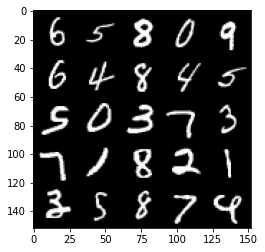

Step 34200: gen_loss: 234.5261048078537, disc_loss: 24.046058475971222


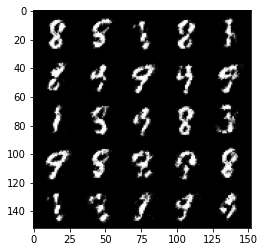

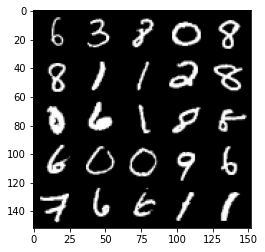

Step 34300: gen_loss: 240.60933184623718, disc_loss: 23.36294761300087


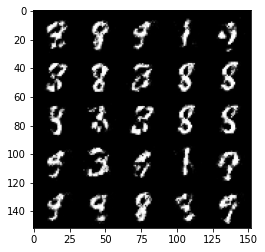

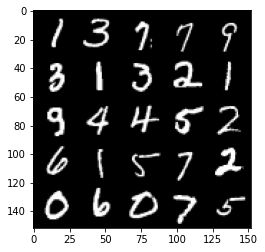

Step 34400: gen_loss: 240.81314277648926, disc_loss: 22.206094935536385


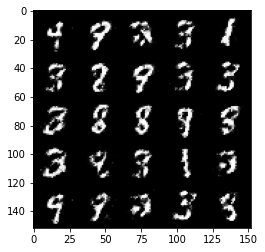

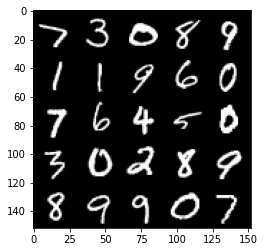

Step 34500: gen_loss: 245.12238192558289, disc_loss: 22.496816739439964


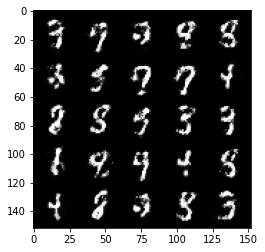

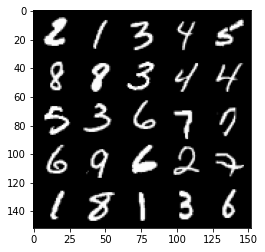

Step 34600: gen_loss: 248.56257367134094, disc_loss: 22.42383372783661


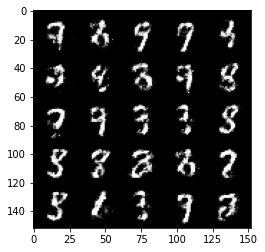

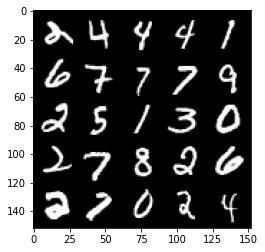

Step 34700: gen_loss: 245.1646773815155, disc_loss: 24.638965234160423


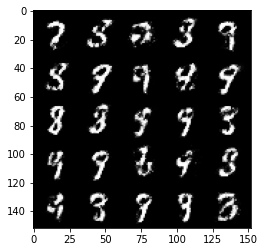

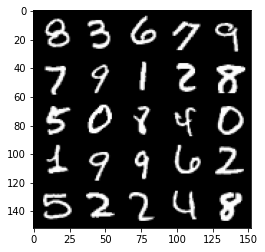

Step 34800: gen_loss: 233.00152671337128, disc_loss: 28.57215104997158


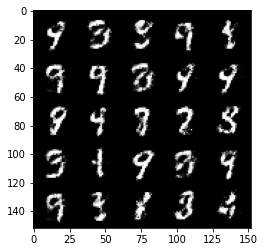

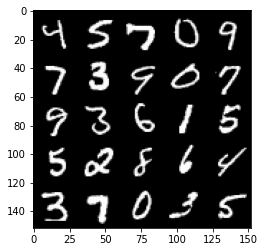

Step 34900: gen_loss: 226.50716507434845, disc_loss: 28.25673945248127


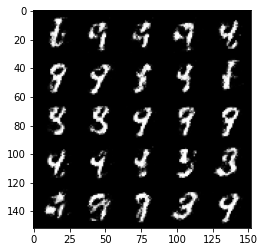

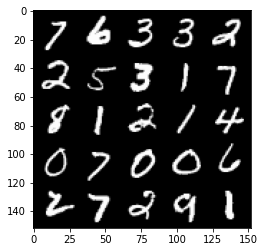

Step 35000: gen_loss: 226.8372187614441, disc_loss: 25.145751878619194


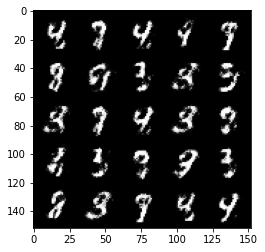

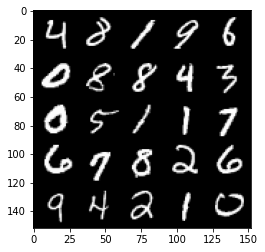

Step 35100: gen_loss: 225.49924862384796, disc_loss: 28.04224568605423


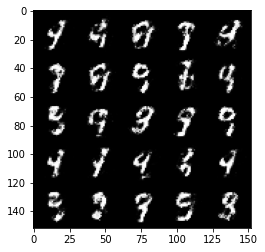

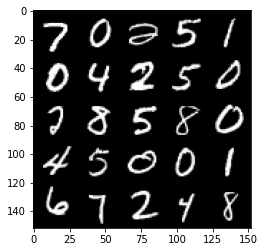

Step 35200: gen_loss: 222.47283911705017, disc_loss: 27.699844777584076


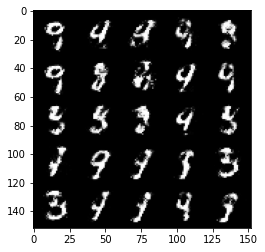

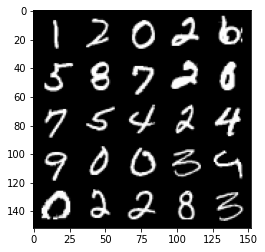

Step 35300: gen_loss: 233.04638838768005, disc_loss: 25.136786997318268


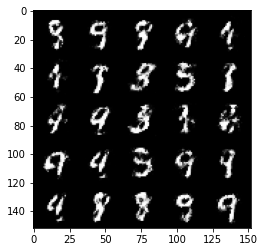

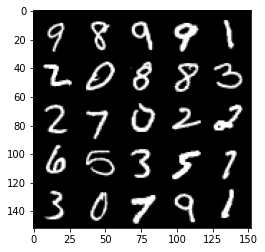

Step 35400: gen_loss: 231.941326379776, disc_loss: 25.78524188697338


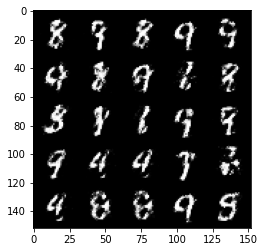

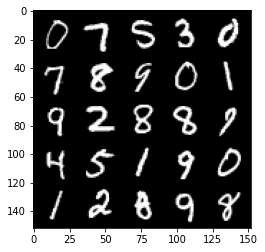

Step 35500: gen_loss: 228.53591740131378, disc_loss: 24.924974367022514


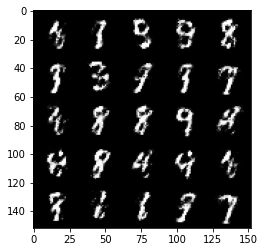

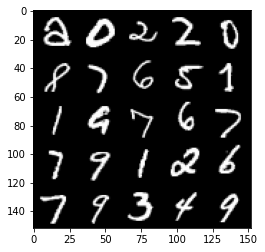

Step 35600: gen_loss: 239.23128247261047, disc_loss: 23.893051475286484


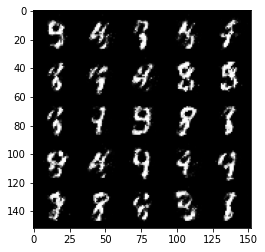

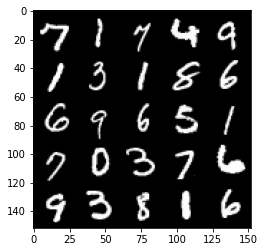

Step 35700: gen_loss: 244.37256002426147, disc_loss: 24.363027900457382


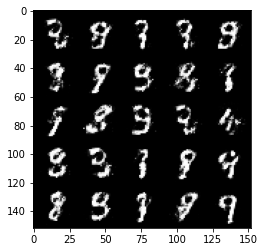

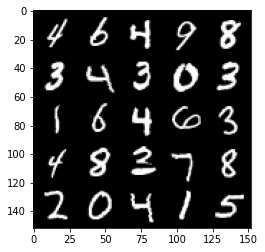

Step 35800: gen_loss: 240.35662722587585, disc_loss: 24.227191284298897


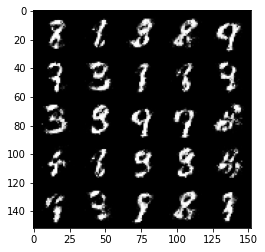

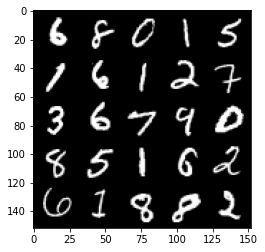

Step 35900: gen_loss: 240.32982897758484, disc_loss: 23.512914925813675


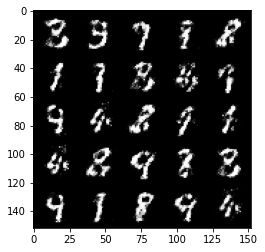

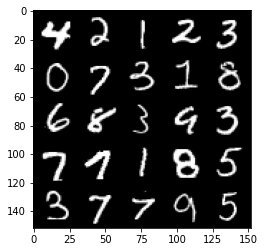

Step 36000: gen_loss: 235.62858295440674, disc_loss: 24.128525123000145


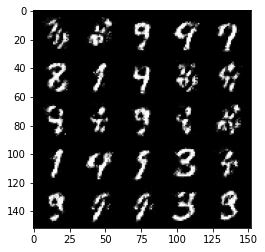

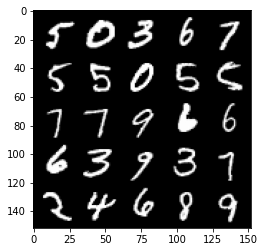

Step 36100: gen_loss: 234.33996868133545, disc_loss: 23.88067200779915


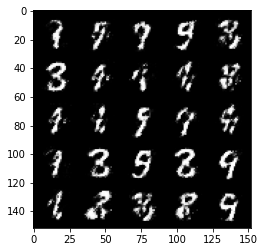

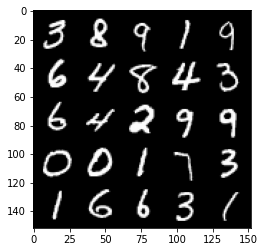

Step 36200: gen_loss: 237.69481539726257, disc_loss: 24.113878399133682


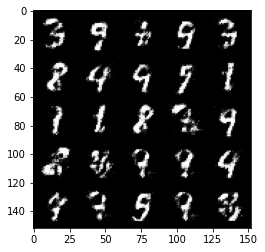

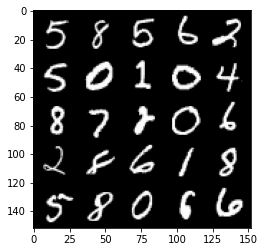

Step 36300: gen_loss: 242.5340874195099, disc_loss: 23.799765184521675


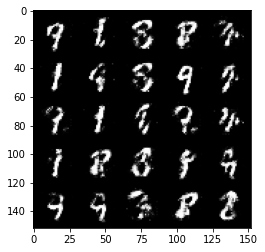

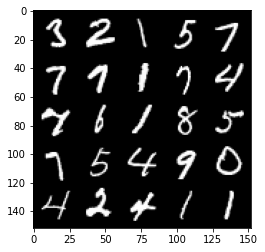

Step 36400: gen_loss: 244.13726806640625, disc_loss: 25.190116435289383


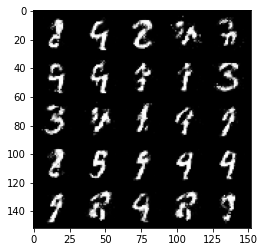

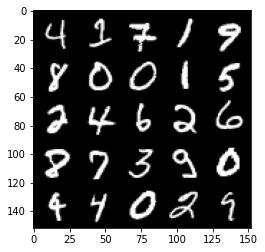

Step 36500: gen_loss: 233.75108122825623, disc_loss: 25.585532024502754


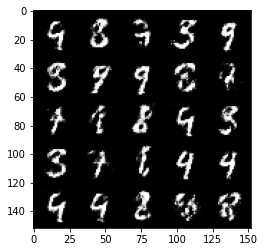

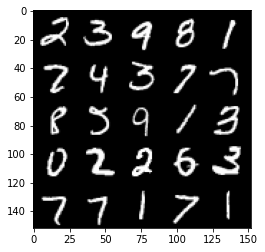

Step 36600: gen_loss: 230.49911904335022, disc_loss: 25.723475605249405


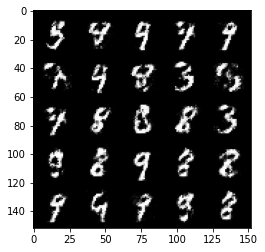

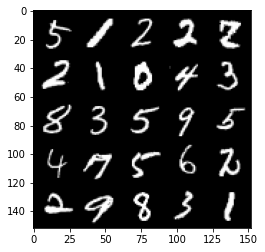

Step 36700: gen_loss: 239.83464431762695, disc_loss: 23.74259579181671


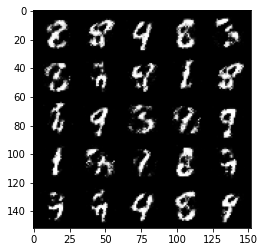

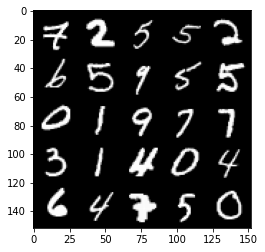

Step 36800: gen_loss: 247.32879495620728, disc_loss: 23.03516909480095


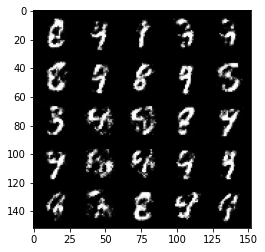

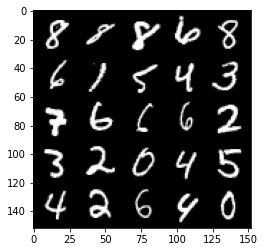

Step 36900: gen_loss: 242.2659434080124, disc_loss: 24.35689054429531


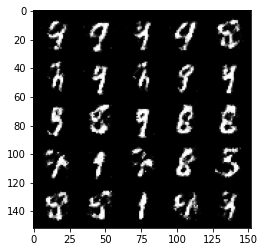

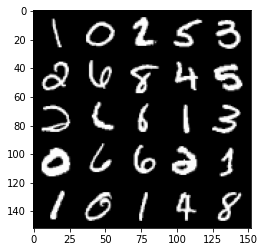

Step 37000: gen_loss: 236.5910472869873, disc_loss: 25.12783871591091


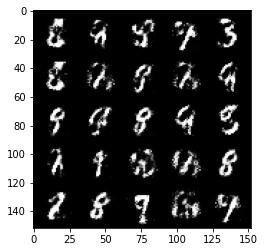

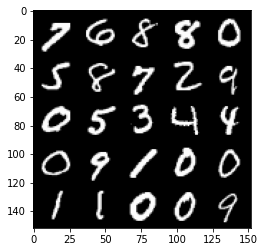

Step 37100: gen_loss: 238.682687997818, disc_loss: 24.562042459845543


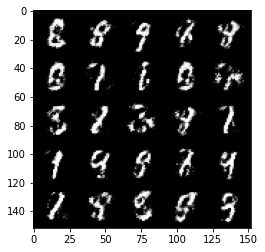

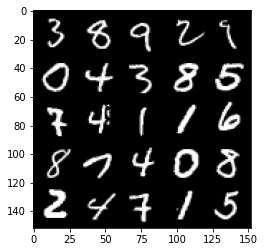

Step 37200: gen_loss: 240.7939043045044, disc_loss: 25.96544560790062


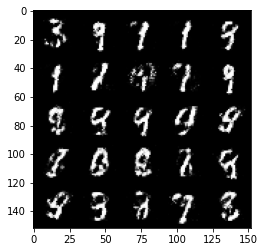

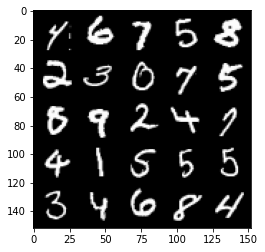

Step 37300: gen_loss: 239.20656085014343, disc_loss: 25.69094768166542


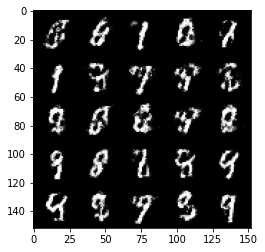

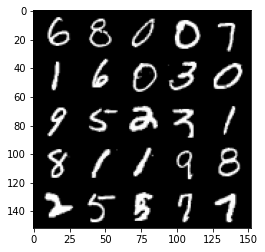

Step 37400: gen_loss: 235.00801360607147, disc_loss: 27.293293833732605


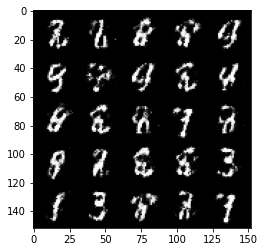

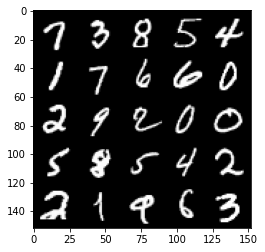

Step 37500: gen_loss: 228.37300062179565, disc_loss: 29.077791571617126


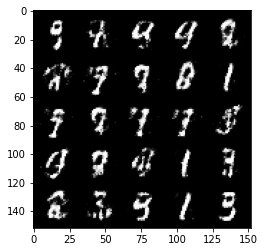

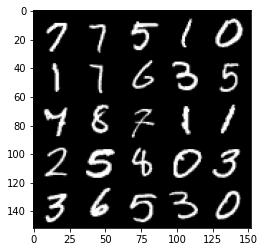

Step 37600: gen_loss: 218.95097541809082, disc_loss: 29.254616886377335


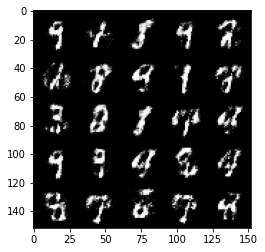

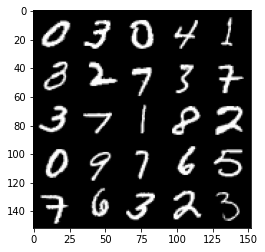

Step 37700: gen_loss: 214.73739528656006, disc_loss: 30.268592074513435


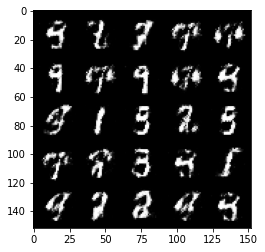

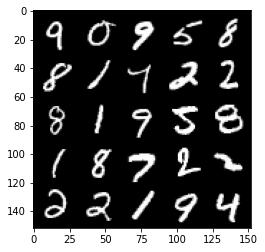

Step 37800: gen_loss: 213.04714596271515, disc_loss: 29.020502269268036


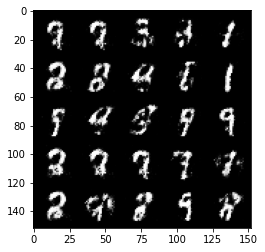

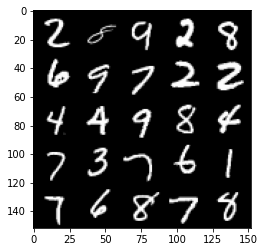

Step 37900: gen_loss: 209.301340341568, disc_loss: 28.85286095738411


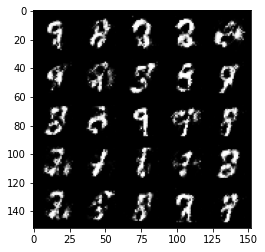

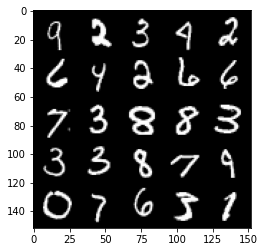

Step 38000: gen_loss: 217.0546602010727, disc_loss: 28.87358868122101


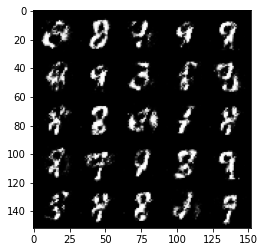

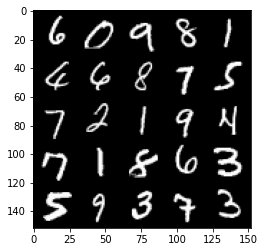

Step 38100: gen_loss: 221.74123239517212, disc_loss: 27.094898104667664


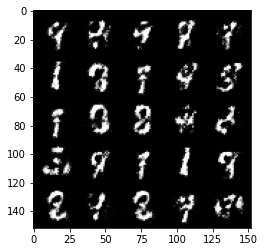

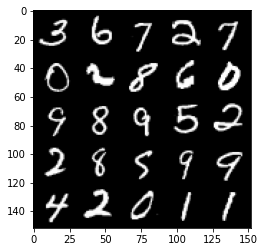

Step 38200: gen_loss: 225.25149393081665, disc_loss: 26.14150707423687


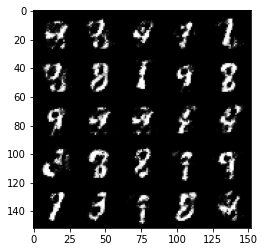

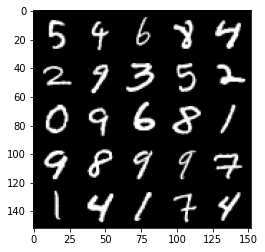

Step 38300: gen_loss: 226.3322057723999, disc_loss: 27.1528939306736


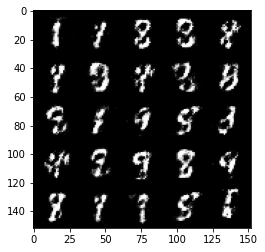

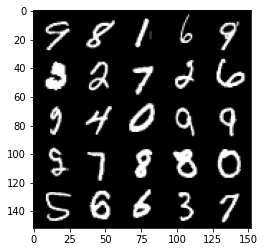

Step 38400: gen_loss: 224.29721629619598, disc_loss: 25.819194197654724


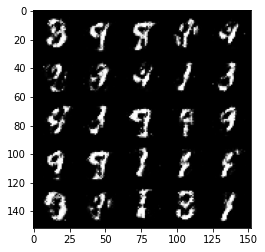

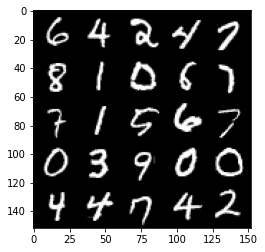

Step 38500: gen_loss: 228.9832581281662, disc_loss: 26.1543500572443


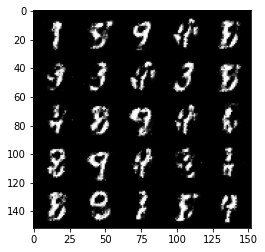

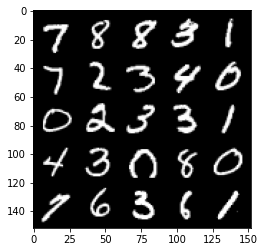

Step 38600: gen_loss: 227.03251719474792, disc_loss: 25.38384038209915


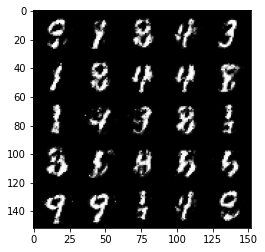

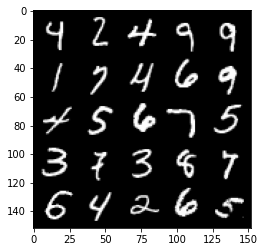

Step 38700: gen_loss: 228.48199474811554, disc_loss: 26.312233805656433


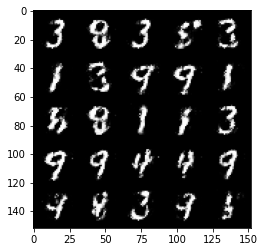

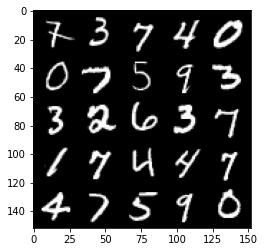

Step 38800: gen_loss: 227.53820395469666, disc_loss: 26.293269470334053


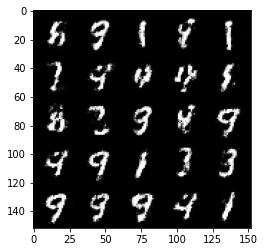

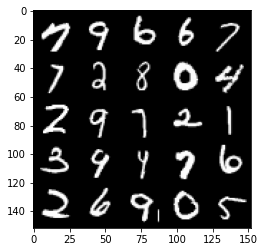

Step 38900: gen_loss: 229.46756601333618, disc_loss: 24.800187453627586


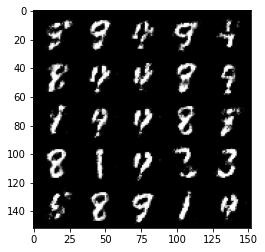

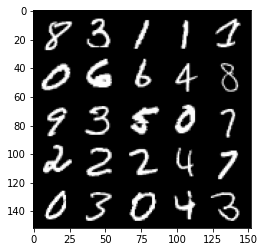

Step 39000: gen_loss: 237.52854585647583, disc_loss: 25.660098865628242


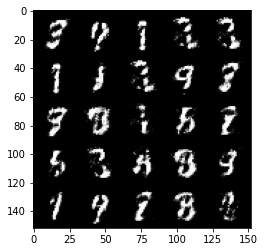

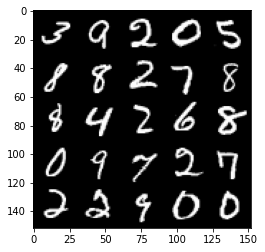

Step 39100: gen_loss: 236.05329060554504, disc_loss: 27.213635116815567


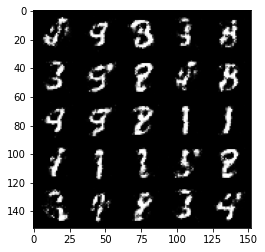

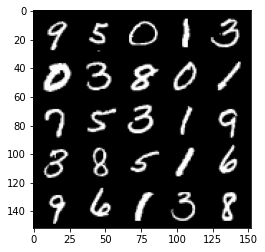

Step 39200: gen_loss: 225.1688199043274, disc_loss: 26.085969135165215


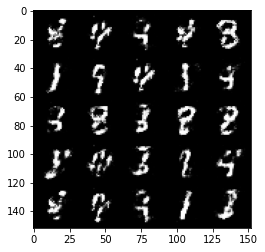

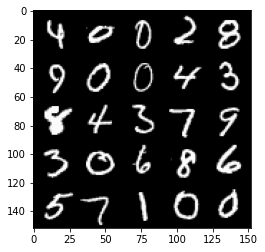

Step 39300: gen_loss: 225.42185306549072, disc_loss: 25.103319704532623


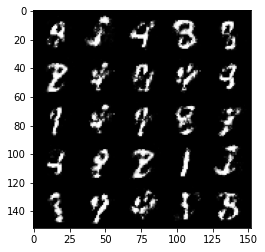

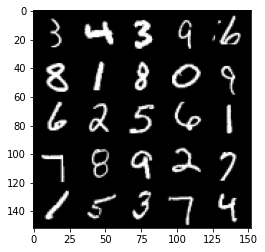

Step 39400: gen_loss: 227.83391618728638, disc_loss: 27.54239894449711


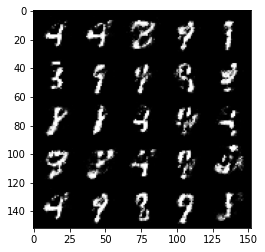

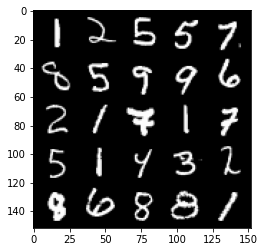

Step 39500: gen_loss: 228.36252188682556, disc_loss: 25.72055856883526


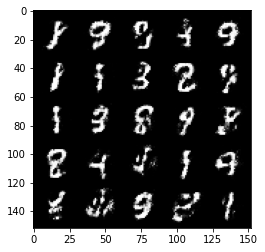

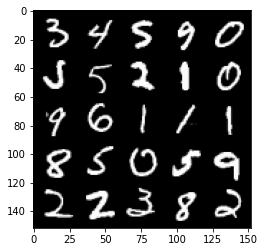

Step 39600: gen_loss: 227.37320506572723, disc_loss: 25.350600123405457


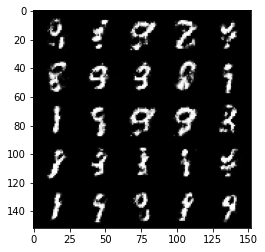

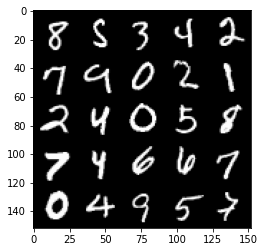

Step 39700: gen_loss: 226.00836658477783, disc_loss: 26.936443567276


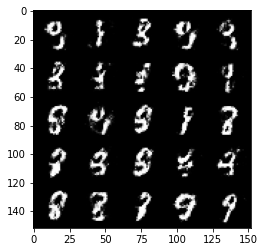

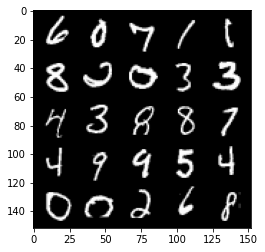

Step 39800: gen_loss: 228.21009802818298, disc_loss: 26.105634227395058


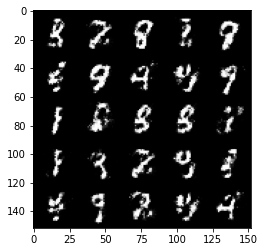

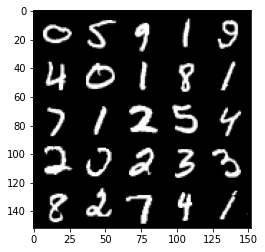

Step 39900: gen_loss: 229.73565208911896, disc_loss: 25.356794372200966


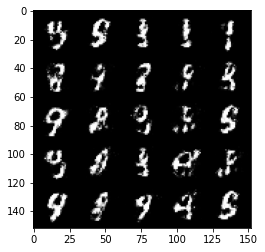

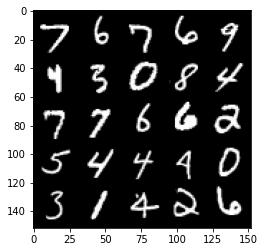

Step 40000: gen_loss: 225.99570214748383, disc_loss: 26.80651918053627


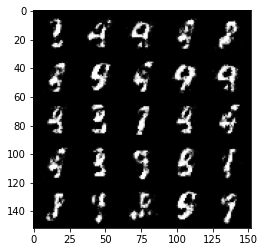

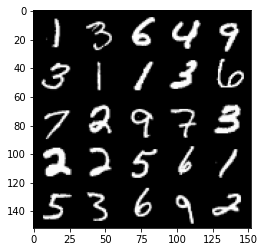

Step 40100: gen_loss: 219.98258447647095, disc_loss: 28.799681305885315


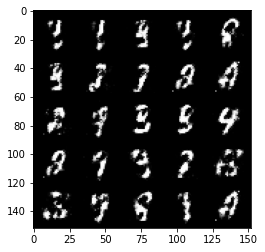

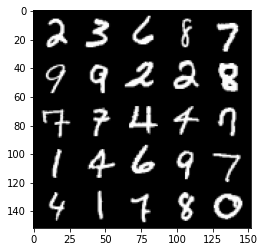

Step 40200: gen_loss: 220.5932960510254, disc_loss: 26.837831541895866


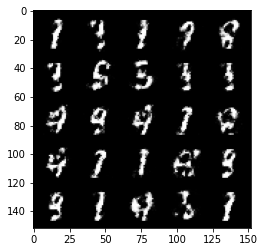

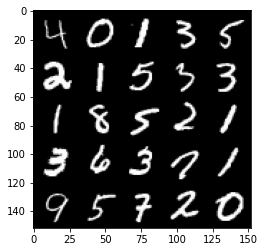

Step 40300: gen_loss: 225.6275486946106, disc_loss: 25.631292432546616


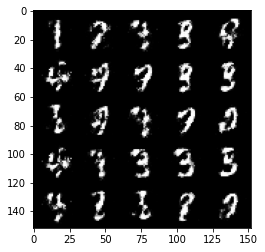

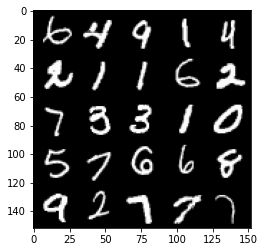

Step 40400: gen_loss: 229.5840299129486, disc_loss: 24.47051151096821


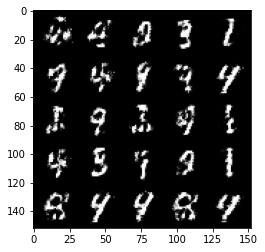

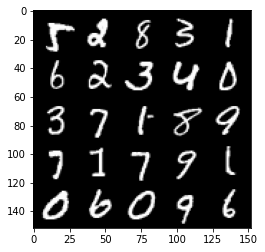

Step 40500: gen_loss: 228.8025438785553, disc_loss: 25.845309421420097


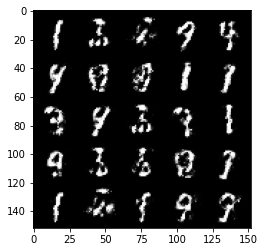

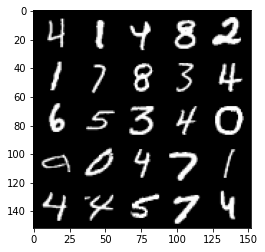

Step 40600: gen_loss: 232.1724932193756, disc_loss: 25.606601774692535


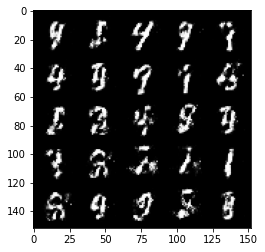

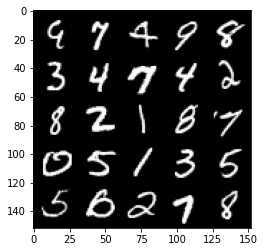

Step 40700: gen_loss: 233.03924655914307, disc_loss: 25.905803605914116


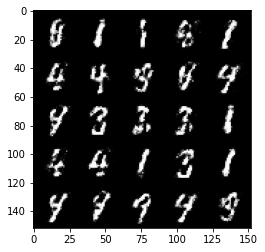

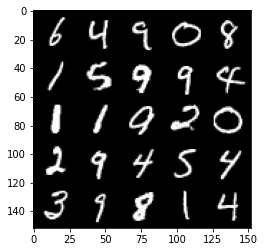

Step 40800: gen_loss: 224.93111443519592, disc_loss: 28.373398259282112


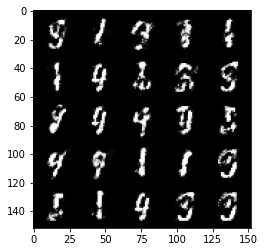

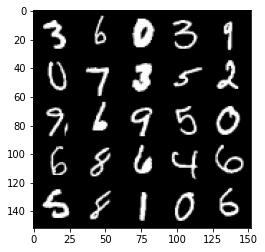

Step 40900: gen_loss: 219.57187604904175, disc_loss: 28.110843136906624


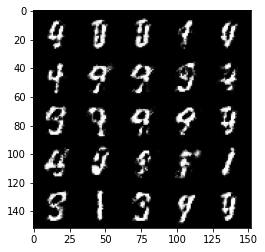

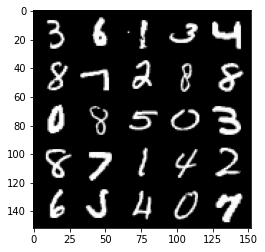

Step 41000: gen_loss: 223.36485183238983, disc_loss: 26.89769273996353


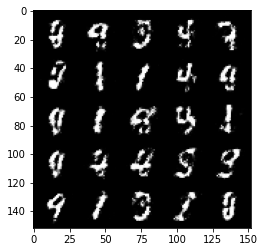

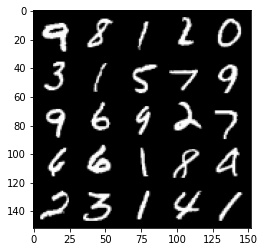

Step 41100: gen_loss: 223.24592244625092, disc_loss: 27.6432186961174


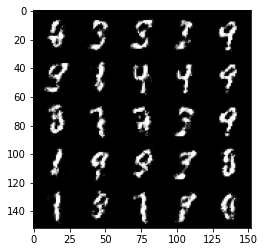

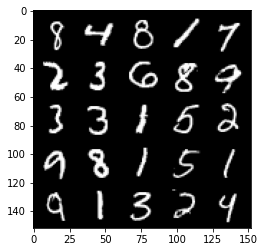

Step 41200: gen_loss: 213.78869318962097, disc_loss: 28.25501212477684


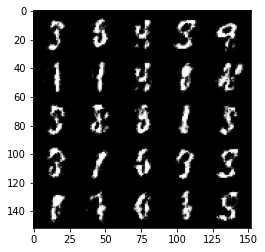

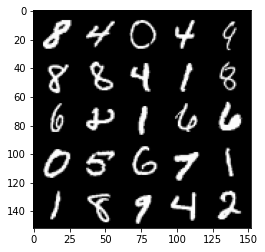

Step 41300: gen_loss: 209.58813607692719, disc_loss: 29.566541388630867


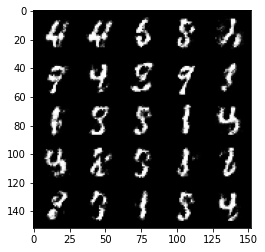

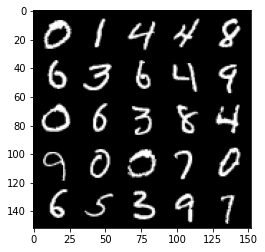

Step 41400: gen_loss: 214.98098707199097, disc_loss: 29.26392212510109


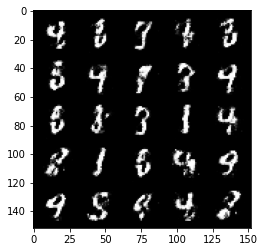

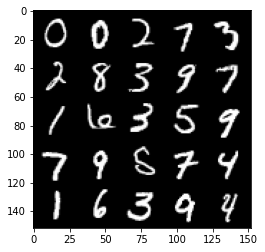

Step 41500: gen_loss: 201.96076953411102, disc_loss: 32.173536628484726


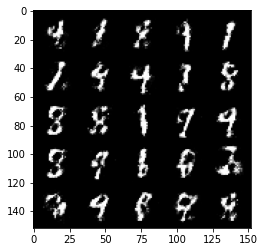

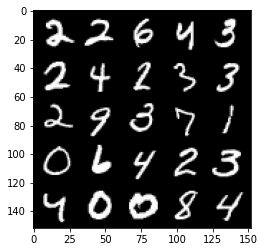

Step 41600: gen_loss: 203.54748606681824, disc_loss: 30.63878697156906


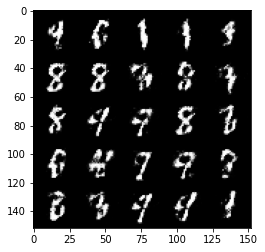

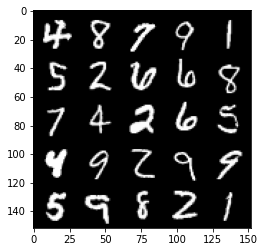

Step 41700: gen_loss: 207.25308978557587, disc_loss: 30.956438466906548


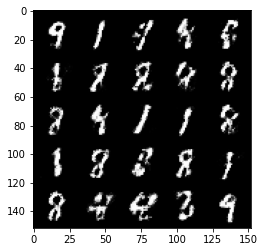

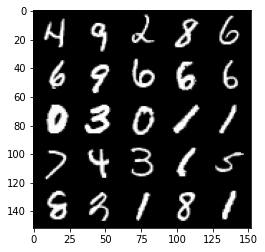

Step 41800: gen_loss: 206.39870297908783, disc_loss: 29.739428758621216


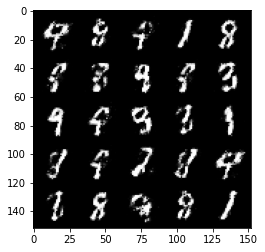

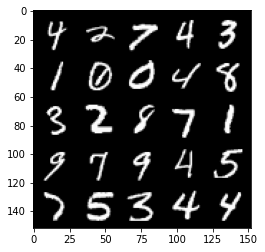

Step 41900: gen_loss: 218.21585154533386, disc_loss: 25.90996152162552


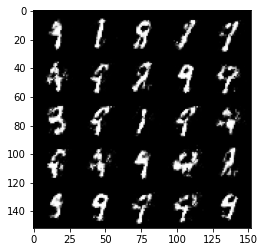

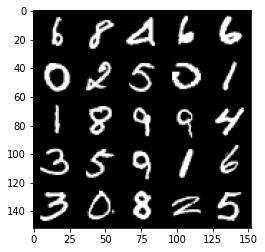

Step 42000: gen_loss: 222.6578837633133, disc_loss: 26.46535412967205


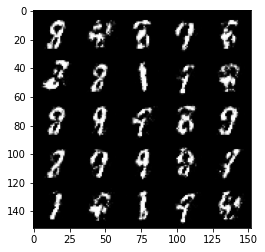

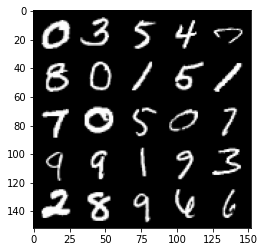

Step 42100: gen_loss: 225.82913327217102, disc_loss: 27.211035192012787


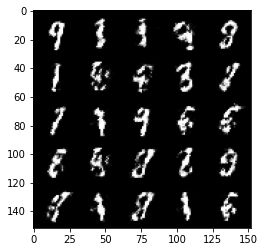

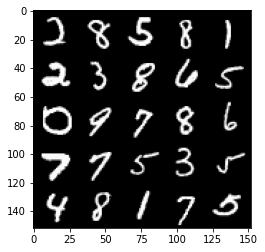

Step 42200: gen_loss: 220.46650898456573, disc_loss: 27.732282534241676


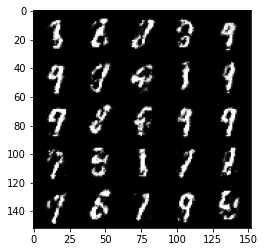

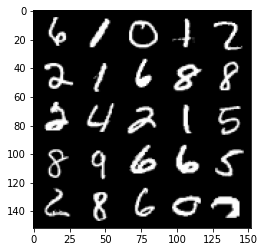

Step 42300: gen_loss: 211.50058209896088, disc_loss: 29.716047257184982


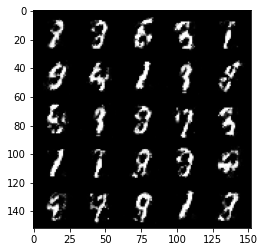

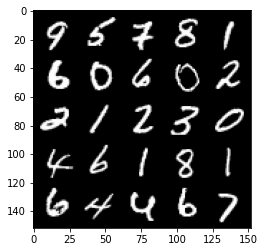

Step 42400: gen_loss: 216.53089356422424, disc_loss: 26.63219065964222


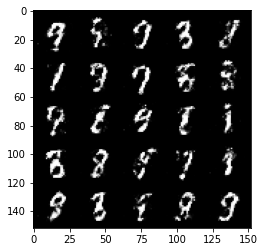

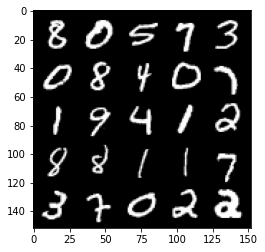

Step 42500: gen_loss: 219.95971703529358, disc_loss: 28.94259512424469


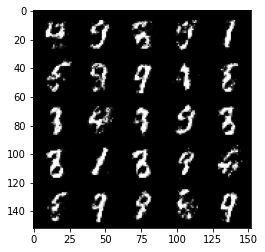

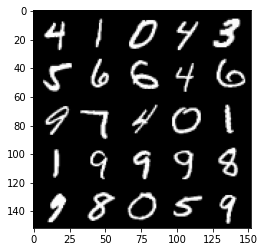

Step 42600: gen_loss: 207.19906187057495, disc_loss: 29.20006611943245


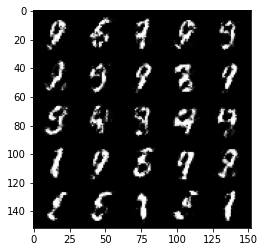

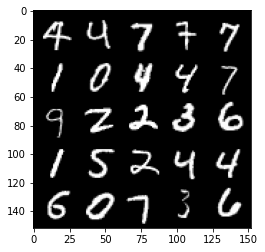

Step 42700: gen_loss: 204.3096820116043, disc_loss: 30.48063088953495


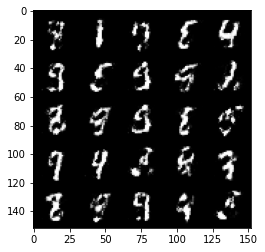

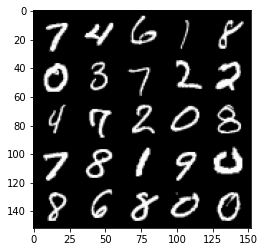

Step 42800: gen_loss: 209.85457932949066, disc_loss: 29.666662082076073


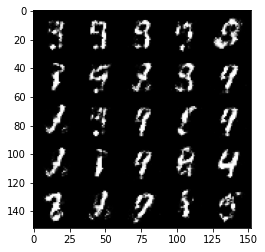

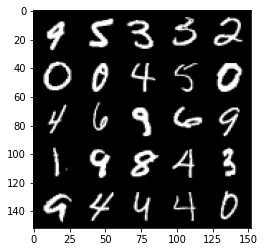

Step 42900: gen_loss: 208.42307376861572, disc_loss: 27.633874520659447


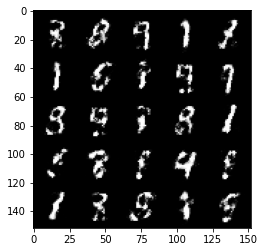

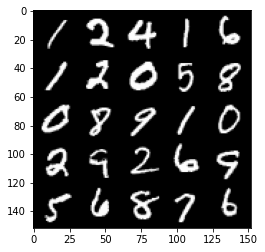

Step 43000: gen_loss: 214.25389218330383, disc_loss: 28.809314265847206


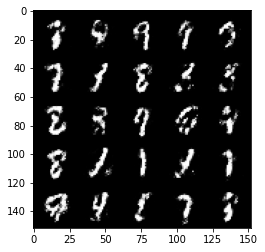

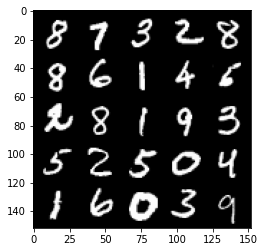

Step 43100: gen_loss: 211.253723859787, disc_loss: 29.243883952498436


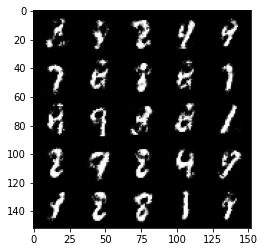

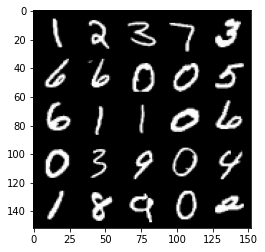

Step 43200: gen_loss: 205.11727833747864, disc_loss: 32.3222880512476


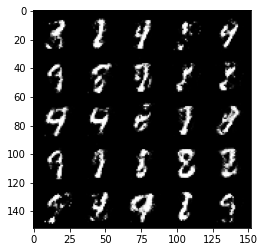

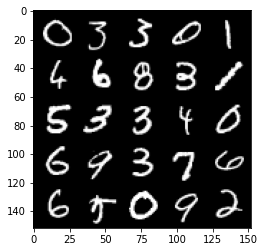

Step 43300: gen_loss: 195.09851455688477, disc_loss: 35.65315526723862


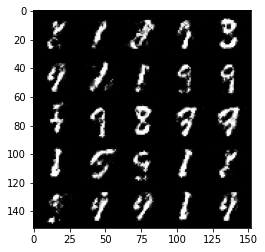

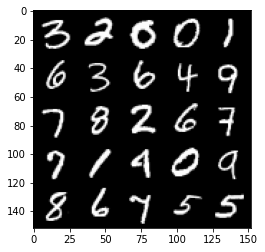

Step 43400: gen_loss: 181.93838369846344, disc_loss: 35.18270143866539


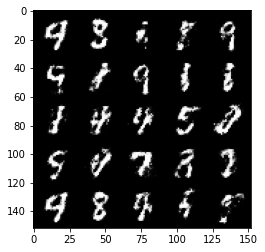

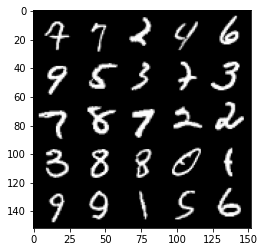

Step 43500: gen_loss: 184.84274756908417, disc_loss: 33.815330505371094


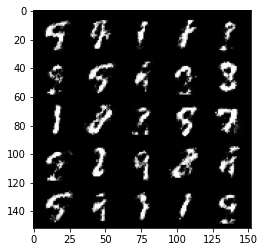

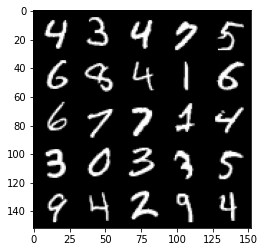

Step 43600: gen_loss: 185.45875144004822, disc_loss: 34.265179857611656


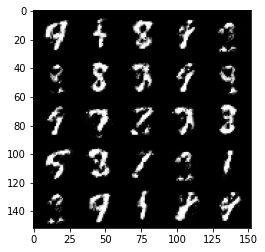

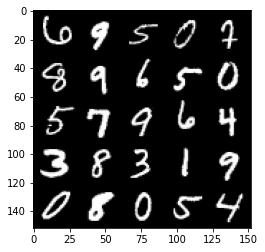

Step 43700: gen_loss: 185.85536551475525, disc_loss: 33.95635202527046


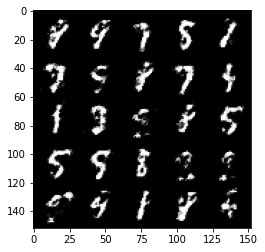

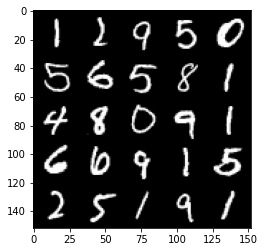

Step 43800: gen_loss: 194.1637477874756, disc_loss: 31.951783940196037


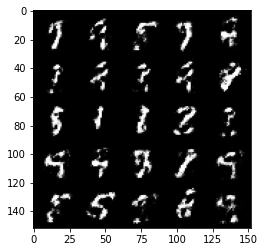

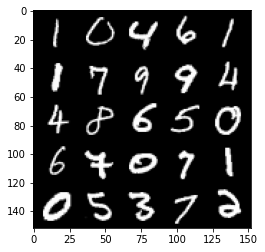

Step 43900: gen_loss: 195.02719283103943, disc_loss: 30.77203878760338


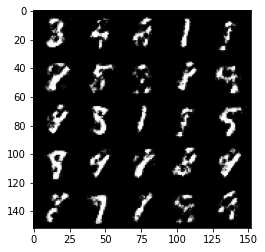

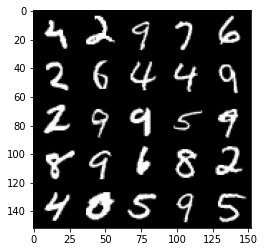

Step 44000: gen_loss: 190.94041395187378, disc_loss: 34.80229505896568


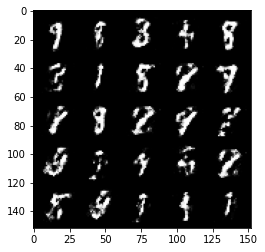

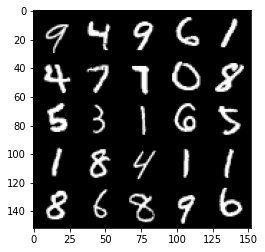

Step 44100: gen_loss: 183.83489334583282, disc_loss: 34.482600539922714


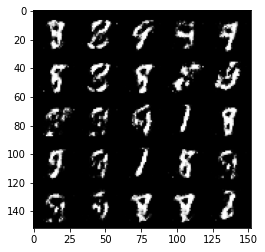

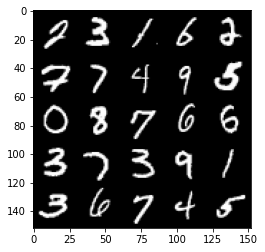

Step 44200: gen_loss: 193.28500366210938, disc_loss: 31.89245994389057


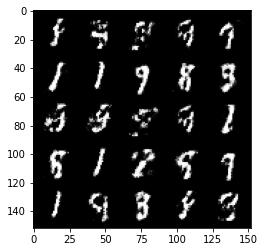

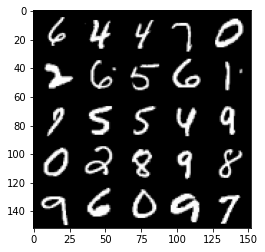

Step 44300: gen_loss: 189.92349135875702, disc_loss: 34.42445346713066


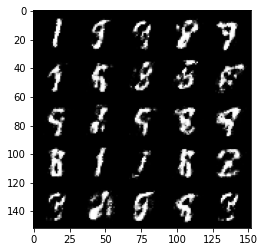

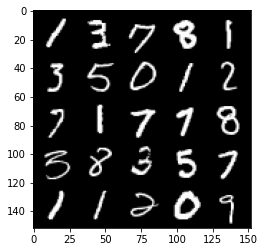

Step 44400: gen_loss: 182.0138212442398, disc_loss: 35.60028174519539


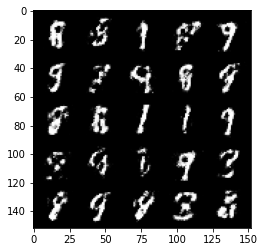

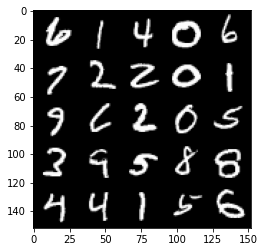

Step 44500: gen_loss: 186.3683341741562, disc_loss: 34.42625543475151


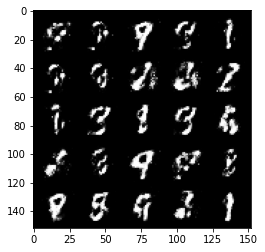

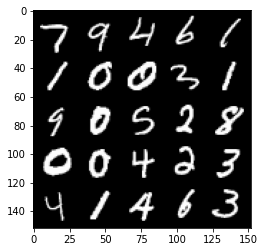

Step 44600: gen_loss: 184.87500703334808, disc_loss: 35.63097867369652


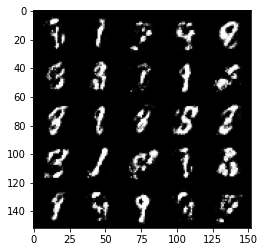

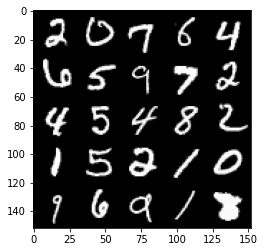

Step 44700: gen_loss: 182.0182650089264, disc_loss: 34.629807859659195


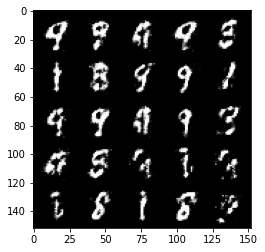

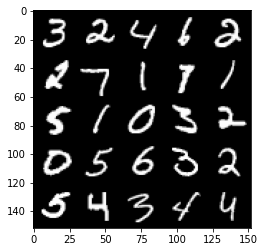

Step 44800: gen_loss: 180.7778925895691, disc_loss: 34.64384186267853


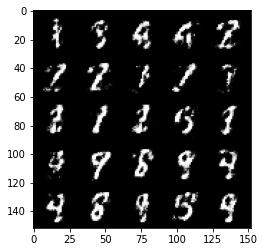

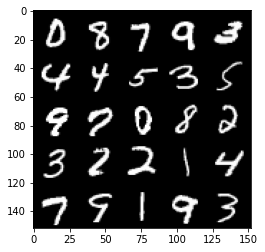

Step 44900: gen_loss: 184.2893863916397, disc_loss: 34.49594336748123


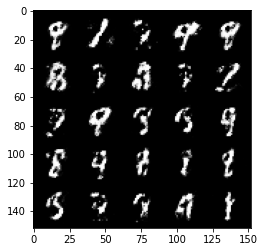

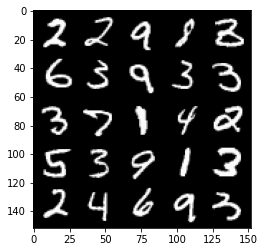

Step 45000: gen_loss: 184.06966483592987, disc_loss: 34.79960152506828


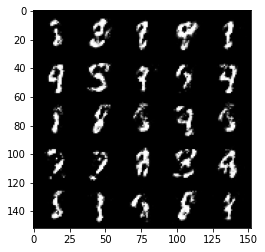

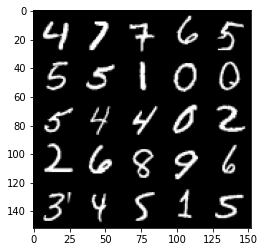

Step 45100: gen_loss: 185.27654099464417, disc_loss: 33.1643381267786


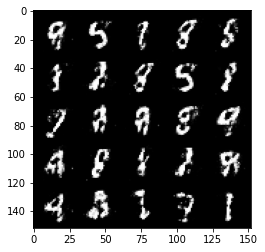

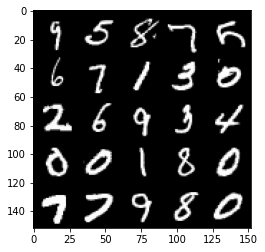

Step 45200: gen_loss: 185.83734095096588, disc_loss: 33.57249590754509


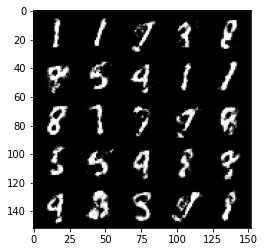

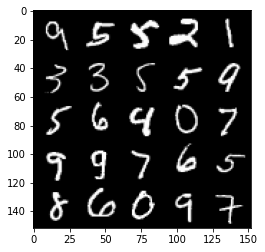

Step 45300: gen_loss: 181.9767793416977, disc_loss: 35.01523408293724


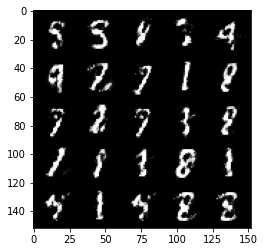

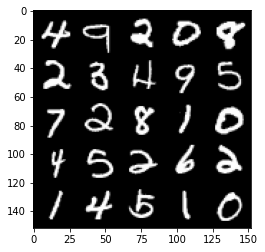

Step 45400: gen_loss: 182.60817861557007, disc_loss: 35.218733221292496


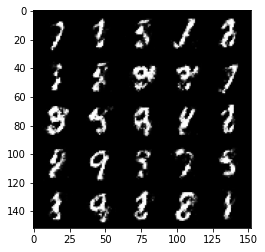

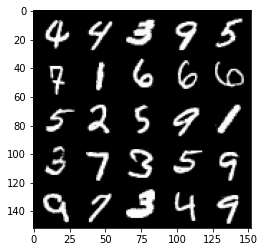

Step 45500: gen_loss: 185.60672688484192, disc_loss: 33.82641884684563


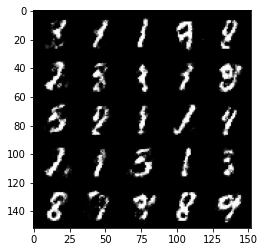

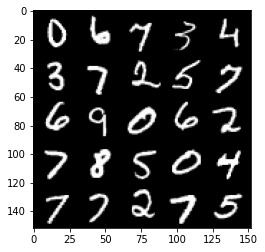

Step 45600: gen_loss: 184.30358612537384, disc_loss: 35.51055458188057


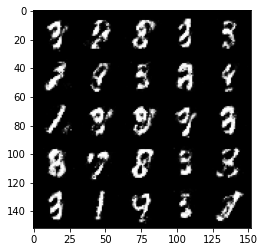

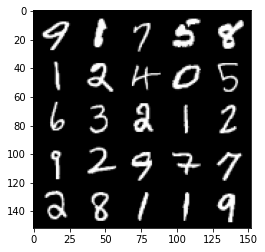

Step 45700: gen_loss: 182.16321063041687, disc_loss: 34.66694700717926


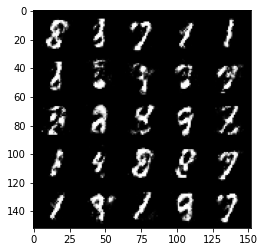

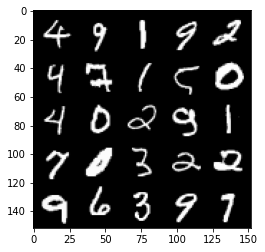

Step 45800: gen_loss: 190.41887044906616, disc_loss: 32.463452592492104


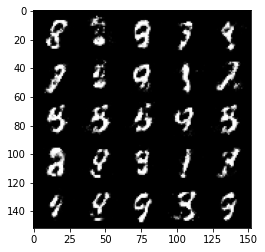

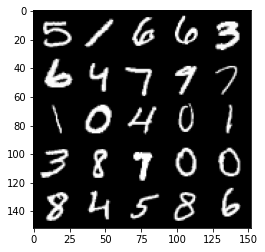

Step 45900: gen_loss: 189.08149898052216, disc_loss: 34.4619055390358


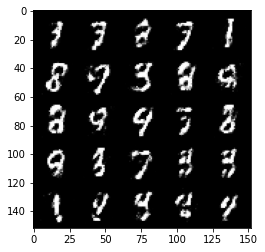

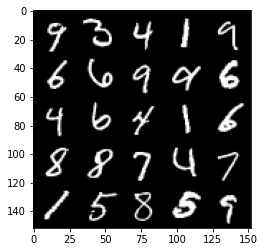

Step 46000: gen_loss: 178.62899124622345, disc_loss: 36.68868187069893


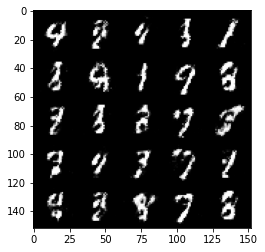

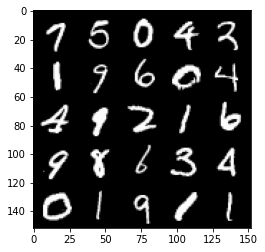

Step 46100: gen_loss: 182.65904366970062, disc_loss: 33.00209468603134


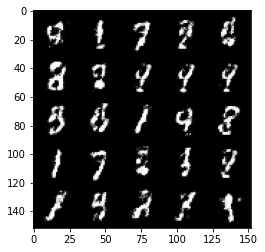

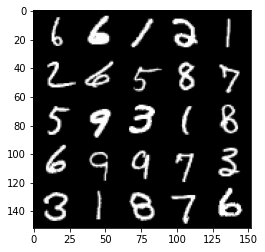

Step 46200: gen_loss: 191.53350043296814, disc_loss: 32.09748812019825


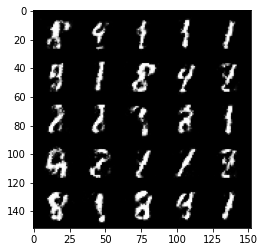

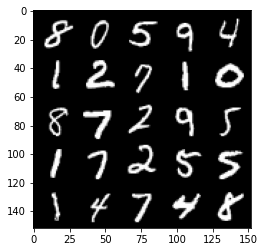

Step 46300: gen_loss: 182.567852973938, disc_loss: 35.949367344379425


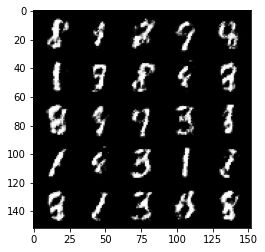

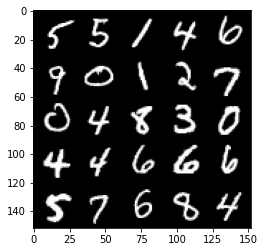

Step 46400: gen_loss: 179.87616634368896, disc_loss: 36.90859520435333


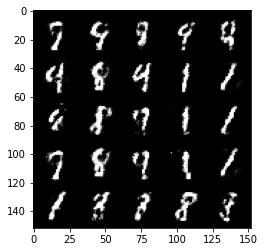

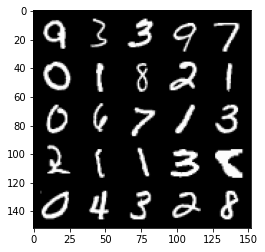

Step 46500: gen_loss: 178.85794806480408, disc_loss: 35.58002746105194


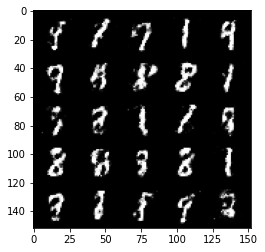

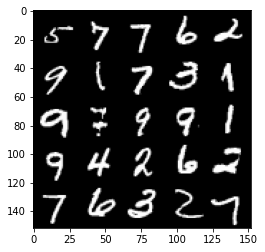

Step 46600: gen_loss: 175.41036689281464, disc_loss: 35.689730912446976


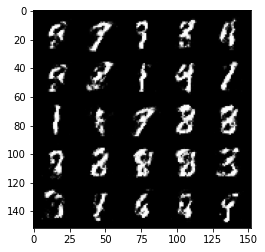

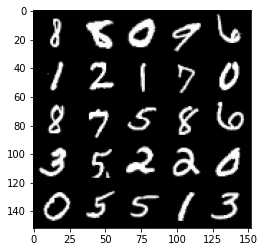

Step 46700: gen_loss: 174.02776336669922, disc_loss: 36.89218679070473


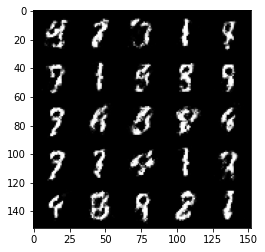

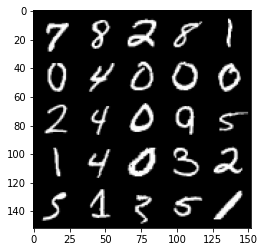

Step 46800: gen_loss: 167.44592583179474, disc_loss: 38.75483238697052


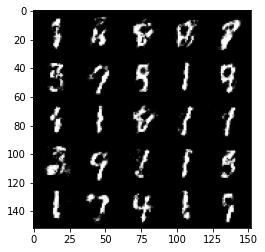

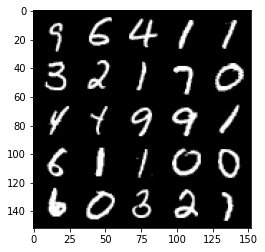

Step 46900: gen_loss: 165.10213840007782, disc_loss: 37.69153329730034


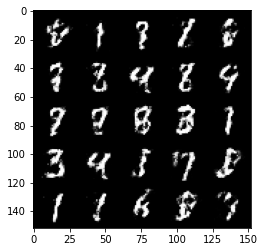

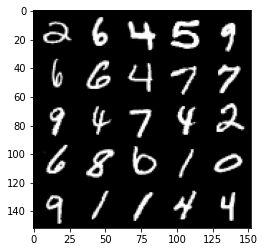

Step 47000: gen_loss: 166.48068392276764, disc_loss: 39.17536836862564


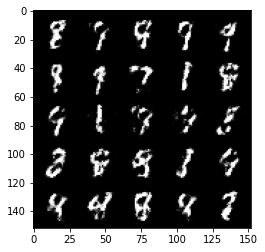

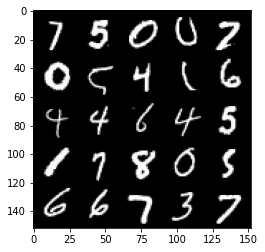

Step 47100: gen_loss: 164.55030512809753, disc_loss: 38.119598507881165


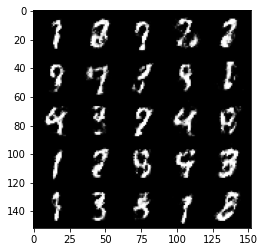

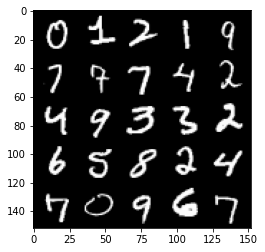

Step 47200: gen_loss: 167.6173793077469, disc_loss: 36.625648468732834


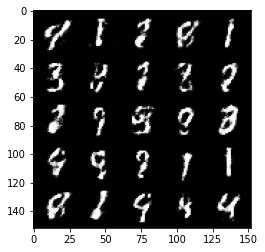

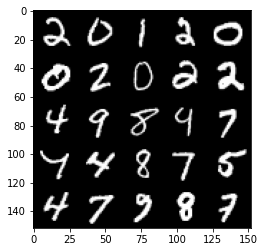

Step 47300: gen_loss: 164.49183428287506, disc_loss: 39.306725680828094


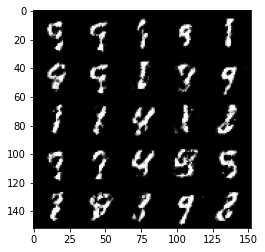

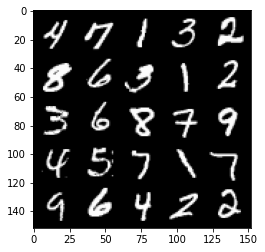

Step 47400: gen_loss: 165.84127247333527, disc_loss: 37.44946160912514


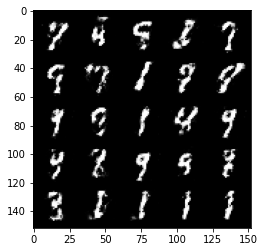

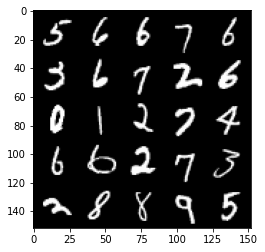

Step 47500: gen_loss: 174.28001010417938, disc_loss: 35.979018568992615


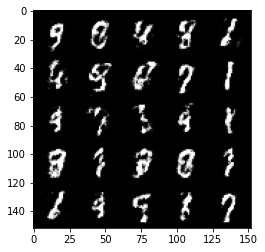

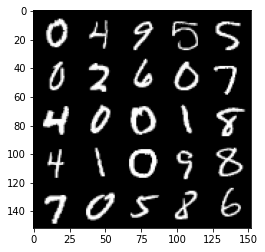

Step 47600: gen_loss: 177.43166589736938, disc_loss: 35.810623198747635


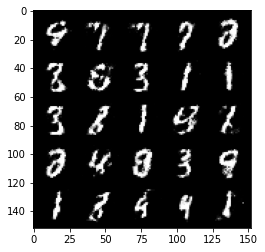

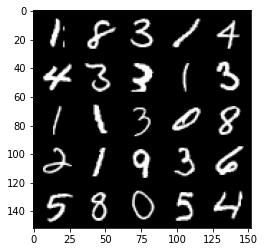

Step 47700: gen_loss: 173.171679854393, disc_loss: 38.35410690307617


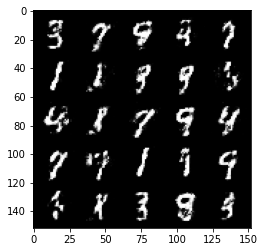

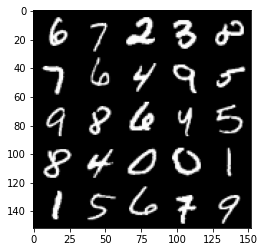

Step 47800: gen_loss: 166.3278957605362, disc_loss: 39.89675796031952


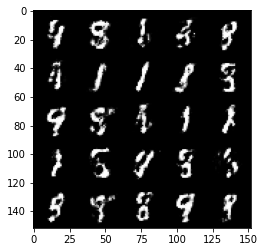

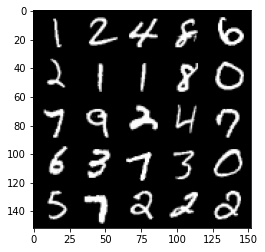

Step 47900: gen_loss: 162.95217275619507, disc_loss: 41.195312201976776


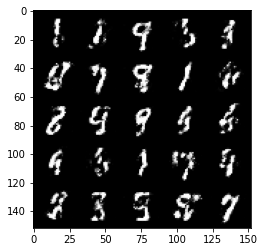

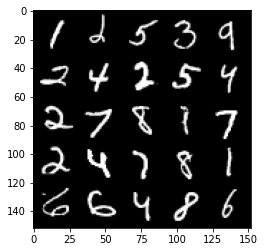

Step 48000: gen_loss: 158.8176646232605, disc_loss: 41.17843219637871


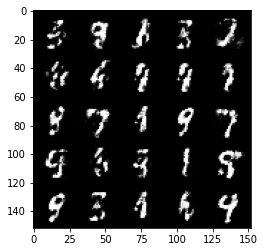

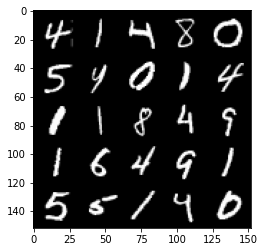

Step 48100: gen_loss: 159.05541133880615, disc_loss: 39.19337350130081


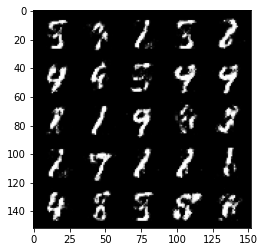

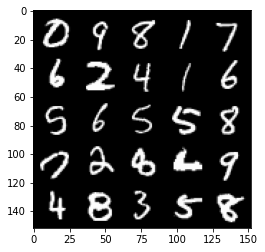

Step 48200: gen_loss: 159.3508758544922, disc_loss: 41.03892141580582


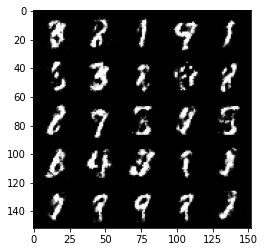

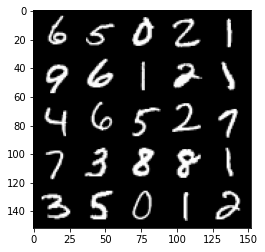

Step 48300: gen_loss: 158.5657867193222, disc_loss: 41.936434626579285


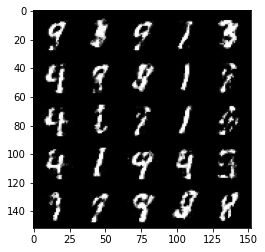

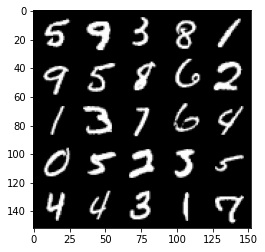

Step 48400: gen_loss: 154.38272726535797, disc_loss: 43.25033786892891


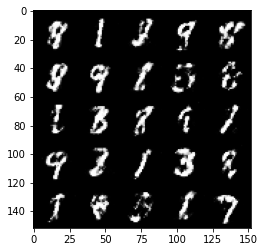

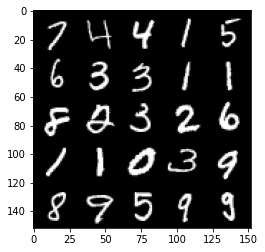

Step 48500: gen_loss: 153.42126882076263, disc_loss: 41.84208765625954


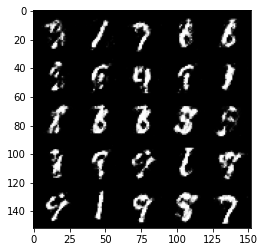

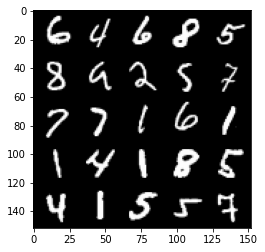

Step 48600: gen_loss: 149.9570038318634, disc_loss: 42.69523265957832


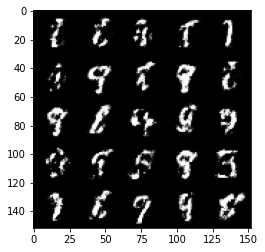

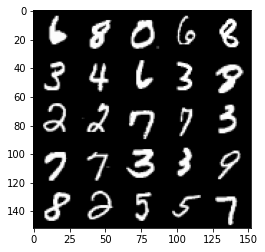

Step 48700: gen_loss: 154.62260150909424, disc_loss: 40.004565954208374


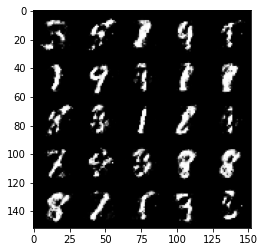

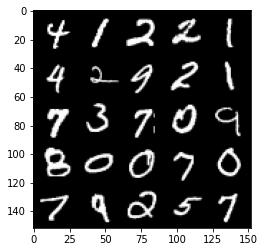

Step 48800: gen_loss: 162.15814912319183, disc_loss: 38.06788805127144


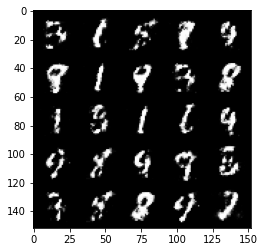

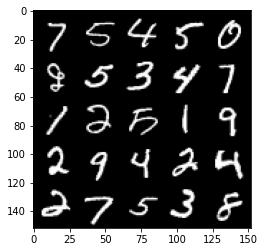

Step 48900: gen_loss: 157.59568059444427, disc_loss: 40.09035301208496


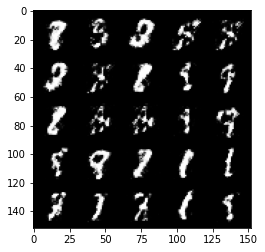

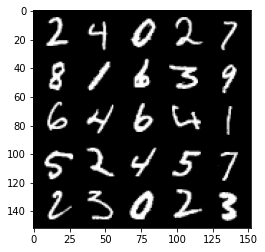

Step 49000: gen_loss: 160.82223439216614, disc_loss: 37.893719375133514


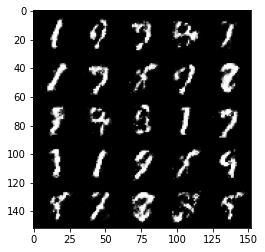

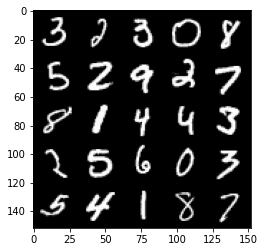

Step 49100: gen_loss: 162.4233684539795, disc_loss: 37.42820546030998


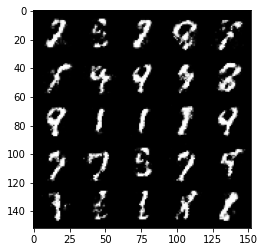

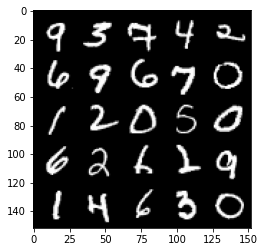

Step 49200: gen_loss: 165.0488818883896, disc_loss: 38.20141986012459


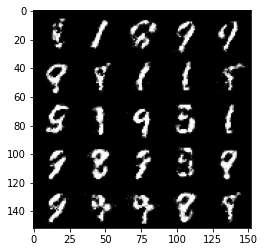

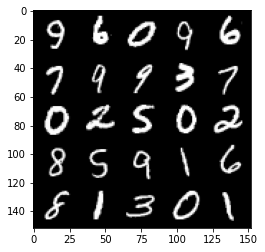

Step 49300: gen_loss: 166.08258414268494, disc_loss: 37.092872470617294


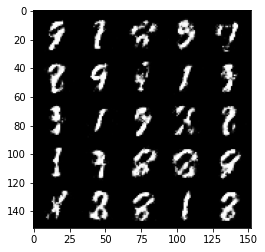

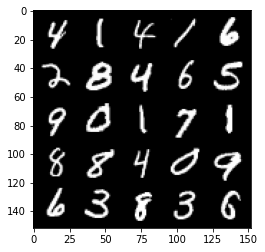

Step 49400: gen_loss: 164.88029170036316, disc_loss: 37.75920981168747


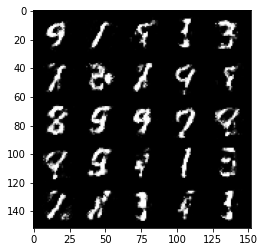

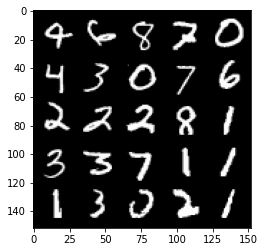

Step 49500: gen_loss: 163.3578746318817, disc_loss: 37.70248422026634


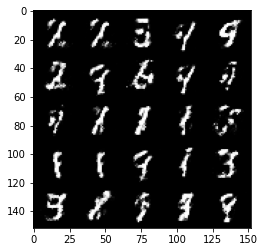

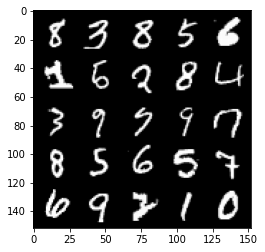

Step 49600: gen_loss: 162.61729216575623, disc_loss: 41.83694311976433


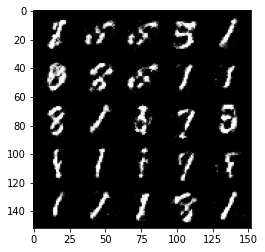

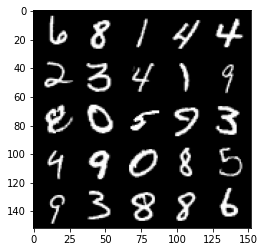

Step 49700: gen_loss: 151.35639476776123, disc_loss: 41.597027987241745


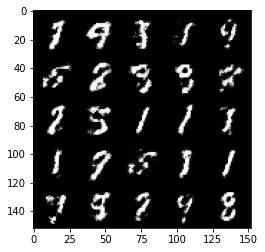

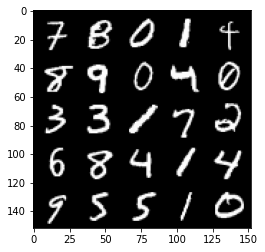

Step 49800: gen_loss: 155.7616662979126, disc_loss: 41.15853536128998


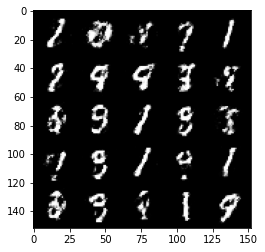

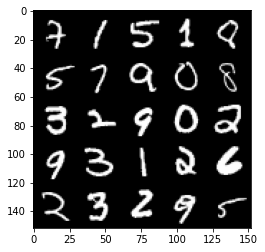

Step 49900: gen_loss: 147.3590703010559, disc_loss: 42.45250827074051


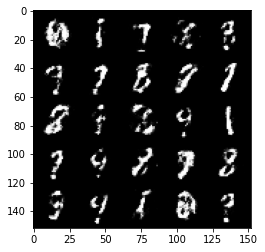

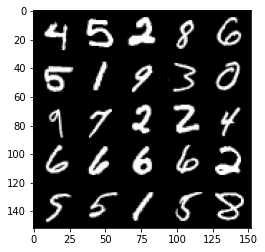

Step 50000: gen_loss: 148.7641063928604, disc_loss: 42.06852748990059
Buffered data was truncated after reaching the output size limit.

In [93]:
epochs = 200 
noise_dim = 64
im_dim= 28*28*1
step = 0
noise_dim = 64
display_step = 100 
mean_gen_loss = 0
mean_disc_loss = 0
gen_loss = False
error = False

gen_losses = []
disc_losses = []

for epoch in range(epochs):
  for real, _ in dataloader: 
    batch_size = len(real)
    real = real.view(batch_size, -1)

    disc_optim.zero_grad()
    disc_loss = get_disc_loss(gen, disc, criterion, real, batch_size, noise_dim)
    disc_loss.backward(retain_graph=True)
    disc_optim.step()

    gen_optim.zero_grad()
    gen_loss = get_gen_loss(gen, disc, criterion, batch_size, noise_dim)
    gen_loss.backward(retain_graph=True)
    gen_optim.step()

    mean_disc_loss += disc_loss.item()
    mean_gen_loss += gen_loss.item()

    if step % display_step == 0 and step > 0:
      print(f"Step {step}: gen_loss: {mean_gen_loss}, disc_loss: {mean_disc_loss}")
      noise = torch.randn(batch_size, noise_dim)
      fake = gen(noise)
      show_image(fake)
      show_image(real)
      mean_gen_loss = 0
      mean_disc_loss = 0 
      disc_losses += [mean_disc_loss]
      gen_losses += [mean_gen_loss]
      
      
    step +=1

In [94]:
from torchvision.models import inception_v3

In [96]:
inception_model = inception_v3(pretrained=False, init_weights=True)

In [ ]:
!pip install wget -q
import wget

In [ ]:
url = 'https://download.pytorch.org/models/inception_v3_google-1a9a5a14.pth'
wget.download(url)

In [ ]:
inception_model.load_state_dict(torch.load("inception_v3_google-1a9a5a14.pth"))
inception_model
inception_model = inception_model.eval()

In [100]:
def preprocess(img):
    img = torch.nn.functional.interpolate(img, size=(299, 299), mode='bilinear', align_corners=False)
    return img

In [101]:
import numpy as np
def get_covariance(features):
    return torch.Tensor(np.cov(features.detach().numpy(), rowvar=False))

In [102]:
def show_image2(image_tensor, num_images=20, size=(3, 28, 28), nrow=5):
    plt.rcParams["figure.figsize"] = (8,8)
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

In [103]:
def get_noise(n_samples, z_dim, device='cpu'):
    return torch.randn(n_samples, z_dim, device=device)

In [104]:
fake_features_list = []
real_features_list = []

from tqdm import tqdm
n_samples = 512 # The total number of samples
batch_size =  64 # Samples per iteration
dataloader = DataLoader(
    data,
    batch_size=batch_size,
    shuffle=True)
device = 'cpu'
cur_samples = 0
with torch.no_grad(): # You don't need to calculate gradients here, so you do this to save memory
  for real_example, _ in tqdm(dataloader, total=n_samples // batch_size): # Go by batch
    print(real_example.shape)
    real_samples = real_example.view(batch_size, 1, 28, 28).expand(-1, 3,-1, -1)
    print(real_samples.shape)
    real_samples = preprocess(real_samples)
    print(real_samples.shape)
    
    real_features = inception_model(real_samples.to(device)).detach().to('cpu') # Move features to CPU
    real_features_list.append(real_features)

    noise = torch.randn(batch_size, noise_dim)
    fake_images = gen(noise)
    print(fake_images.shape)
    fake_images = fake_images.reshape(64,1,28,28)
    print(fake_images.shape)
    fake_images = fake_images.view(batch_size, 1, 28, 28).expand(-1, 3,-1, -1)
    print(fake_images.shape)
    fake_samples = preprocess(fake_images)
    fake_features = inception_model(fake_samples.to(device)).detach().to('cpu')
    fake_features_list.append(fake_features)
    cur_samples += len(real_samples)
    if cur_samples >= n_samples:
        break














  0%|          | 0/8 [00:00<?, ?it/s]

torch.Size([64, 1, 28, 28])
torch.Size([64, 3, 28, 28])
torch.Size([64, 3, 299, 299])
torch.Size([64, 784])
torch.Size([64, 1, 28, 28])
torch.Size([64, 3, 28, 28])














 12%|█▎        | 1/8 [00:36<04:16, 36.61s/it]

torch.Size([64, 1, 28, 28])
torch.Size([64, 3, 28, 28])
torch.Size([64, 3, 299, 299])
torch.Size([64, 784])
torch.Size([64, 1, 28, 28])
torch.Size([64, 3, 28, 28])














 25%|██▌       | 2/8 [01:09<03:33, 35.58s/it]

torch.Size([64, 1, 28, 28])
torch.Size([64, 3, 28, 28])
torch.Size([64, 3, 299, 299])
torch.Size([64, 784])
torch.Size([64, 1, 28, 28])
torch.Size([64, 3, 28, 28])














 38%|███▊      | 3/8 [01:43<02:54, 34.88s/it]

torch.Size([64, 1, 28, 28])
torch.Size([64, 3, 28, 28])
torch.Size([64, 3, 299, 299])
torch.Size([64, 784])
torch.Size([64, 1, 28, 28])
torch.Size([64, 3, 28, 28])














 50%|█████     | 4/8 [02:16<02:17, 34.39s/it]

torch.Size([64, 1, 28, 28])
torch.Size([64, 3, 28, 28])
torch.Size([64, 3, 299, 299])
torch.Size([64, 784])
torch.Size([64, 1, 28, 28])
torch.Size([64, 3, 28, 28])














 62%|██████▎   | 5/8 [02:49<01:42, 34.07s/it]

torch.Size([64, 1, 28, 28])
torch.Size([64, 3, 28, 28])
torch.Size([64, 3, 299, 299])
torch.Size([64, 784])
torch.Size([64, 1, 28, 28])
torch.Size([64, 3, 28, 28])














 75%|███████▌  | 6/8 [03:22<01:07, 33.82s/it]

torch.Size([64, 1, 28, 28])
torch.Size([64, 3, 28, 28])
torch.Size([64, 3, 299, 299])
torch.Size([64, 784])
torch.Size([64, 1, 28, 28])
torch.Size([64, 3, 28, 28])














 88%|████████▊ | 7/8 [03:56<00:33, 33.68s/it]

torch.Size([64, 1, 28, 28])
torch.Size([64, 3, 28, 28])
torch.Size([64, 3, 299, 299])
torch.Size([64, 784])
torch.Size([64, 1, 28, 28])
torch.Size([64, 3, 28, 28])


In [109]:
fake_features_all = torch.cat(fake_features_list)
real_features_all = torch.cat(real_features_list)

In [110]:
mu_fake = torch.mean(fake_features_all, axis = 0)
mu_real = torch.mean(real_features_all, axis = 0)
sigma_fake = get_covariance(fake_features_all)
sigma_real = get_covariance(real_features_all)

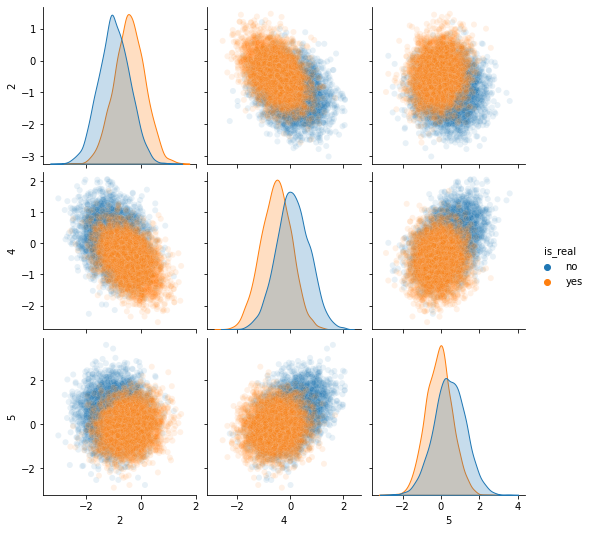

In [111]:
from torch.distributions import MultivariateNormal
import seaborn as sns
indices = [2, 4, 5]
fake_dist = MultivariateNormal(mu_fake[indices], sigma_fake[indices][:, indices])
fake_samples = fake_dist.sample((5000,))
real_dist = MultivariateNormal(mu_real[indices], sigma_real[indices][:, indices])
real_samples = real_dist.sample((5000,))

import pandas as pd

df_fake = pd.DataFrame(fake_samples.numpy(), columns=indices)
df_real = pd.DataFrame(real_samples.numpy(), columns=indices)
df_fake["is_real"] = "no"
df_real["is_real"] = "yes"
df = pd.concat([df_fake, df_real])
sns.pairplot(df, plot_kws={'alpha': 0.1}, hue='is_real')
plt.show()

In [112]:
import scipy
def matrix_sqrt(x):
    y = x.cpu().detach().numpy()
    y = scipy.linalg.sqrtm(y)
    return torch.Tensor(y.real, device=x.device)
def frechet_distance(mu_x, mu_y, sigma_x, sigma_y):
    return torch.norm(mu_x - mu_y) + torch.trace(sigma_x + sigma_y - 2 * matrix_sqrt(sigma_x @ sigma_y))
with torch.no_grad():
    print(frechet_distance(mu_real, mu_fake, sigma_real, sigma_fake).item())

206.8780059814453


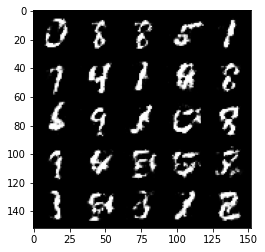

In [114]:
noise = torch.randn(batch_size, noise_dim)
fake = gen(noise)
show_image(fake)